# CIS6800: Project 3: SOLO and FPN (Instance Segmentation)


### Instructions:
* This is a group assignment with one submission per group. It is expected that each member of the group will contribute to solving each question. Be sure to specify your teammates when you submit to Gradescope! Collaborating with other groups is not permitted.
* There is no single answer to most problems in deep learning, therefore the questions will often be underspecified. You need to fill in the blanks and submit a solution that solves the (practical) problem. Document the choices (hyperparameters, features, neural network architectures, etc.) you made where specified.
* You may include any code used in previous projects. You may use ChatGPT, but you need to document how you use it.
* You should expect that a complete training session should last about 6 hours, so you should start part (b) as early as you can!
* To save on compute time, we debugging locally and using colab to train. Or use colab cpu instance for debugging
* We should be able to reproduce your results with a single function call or cell evaluation. Please specify the method to do so. You do not, however, need to submit your trained weights.


The SOLO paper: https://arxiv.org/pdf/1912.04488.pdf


In [1]:
# download data, if the auto download faild, you can maunally download here:
# https://drive.google.com/drive/folders/17cT1ywZeKJ5l-FinBwpWv-EbvaMJ9mSa?usp=sharing

# !gdown --id 1JD3OaHpq_4KCb7ofcPMkknmdEXFHrCcn
# !gdown --id 1ssRA7yijGLFmJU-ac-lPyUOq7DYzTAS1
# !gdown --id 1Rpz-ZuQxDwvLyzc0FD9GZxAKlyka3VC5
# !gdown --id 1ouMFNT1thia8l6P5vcWCY-nweAexLDsB
# !pip install pytorch-lightning

## Code Structure
In this assignment, we are only providing the barest templates for your code structure. If you prefer, you can write and debug most of the components in a regular python and only use Jupyter to train. In this case, you might have several files that you import into this notebook, e.g.
* `dataset.py`
* `model.py`
* `train.py`
* `inference.py`

This is shown below. All files should be included in your submission.

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt

import os
import sys
sys.path.append('./src')

from dataset import *
from backbone import *
from solo_head import *
from settings import *

## Overview

Instance segmentation can be thought of as a combination of object detection and semantic segmentation, the former of which you already explored in the previous project. A visulization of this relationship can be seen in fig. 1.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig1.png" width=500/></div>
<center>Figure 1: An overview of instance segmentation.</center>  

In this project, you are tasked with implementing an instance segmentation framework know as SOLO (Segmenting Object by LOcations). In a similar manner to YOLO, SOLO produces mask predictions on a dense grid. This means that, unlike many other segmenation frameworks (e.g. Mask-RCNN), SOLO directly predicts the segmentation mask without proposing bounding box locations. An visual summary of SOLO can be seen in fig. 2 and 3.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig2.png" width=200/></div>
<center>Figure 2: SOLO.</center>  

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig3.png" width=600/></div>
<center>Figure 3: SOLO branches.</center>

These dense predictions are produced at several different scales using a Feature Pyramid Network (FPN). Using the last few layers of the backbone, we pass the higher level features from the deeper layers back up to larger features scales using lateral connections, shown in fig. 4. The integration of the FPN into your network will be the primary focus of this project.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig4.png" width=300/></div>
<center>Figure 4: SOLO branches.</center>

## Part A

### Dataset
#### Dataset Structure
The dataset used in this project contains three classes across 3265 images: vehicles, people, and animals. The dataset contains the following elements:

* A numpy array of images ($3 \times 300 \times 400$).
* A numpy array of masks ($300 \times 400$).
* A list of ground truth labels by image.
* A list of bounding boxes by image.

Note that the mask array is flattened; to determine which masks belong to which image, count the number of labels associated with that image. For example, if the first few images have 3, 2, and 4 labels, masks 0-2 would belong to image 1, masks 3-4 would belong to image 2, etc. The masks are ordered correctly to allow for this.

#### Loading and Batching
You should apply the following transformations to each image:
* Normalize pixel values to $[0,1]$.
* Rescale the image to $800 \times 1066$.
* Normalize each channel with means $[0.485, 0.456, 0.406]$ and standard deviations $[0.229, 0.224, 0.225]$.
* Zero pad the image to $800 \times 1088$.

Since each image will have a different number of objects, you will have to write your own collation function to properly batch the images. An example collate_fn is shown below, along with expected output dimensions.

In [2]:
# file path and make a list
parent_dir = "./data"
paths = {
    fname.split("_")[2]: f"{parent_dir}/{fname}"
    for fname in os.listdir(parent_dir)
}

# load the data into data.Dataset
dataset = BuildDataset(paths)

full_size = len(dataset)
train_size = int(full_size * 0.8)
test_size = full_size - train_size
# random split the dataset into training and testset
# set seed
torch.random.manual_seed(1)
train_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, test_size])
# push the randomized training data into the dataloader

batch_size = 1
train_loader = BuildDataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
test_loader = BuildDataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

mask_color_list = ["jet", "ocean", "Spectral", "spring", "cool"]

# images:         (batch_size, 3, 800, 1088)
# labels:         list with len: batch_size, each (n_obj,)
# masks:          list with len: batch_size, each (n_obj, 1, 800, 1088), Added channels dimention to work with torchvision functions
# bounding_boxes: list with len: batch_size, each (n_obj, 4)

#### Visualization
In order to validate that you are loading the dataset correct, you should plot at least five example images that include the mask, annotations, and bounding boxes. Examples of such images are shown in fig. 5 and 6. Make sure that the color for each class is consistent!

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig5.png" width=500/></div>
<center>Figure 5: Example visualization.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig6.png" width=500/></div>
<center>Figure 6: Example visualization.</center>

0


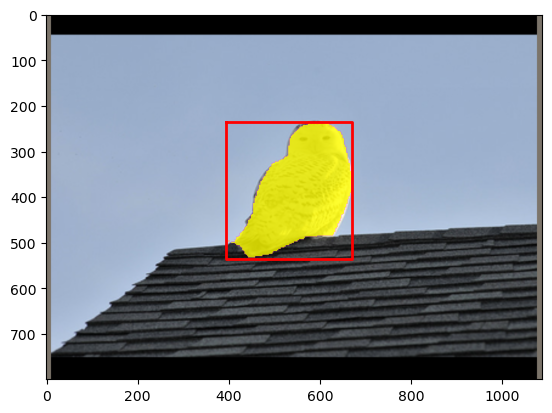

0


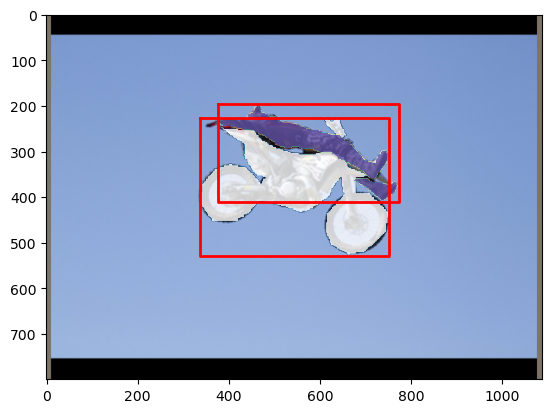

0


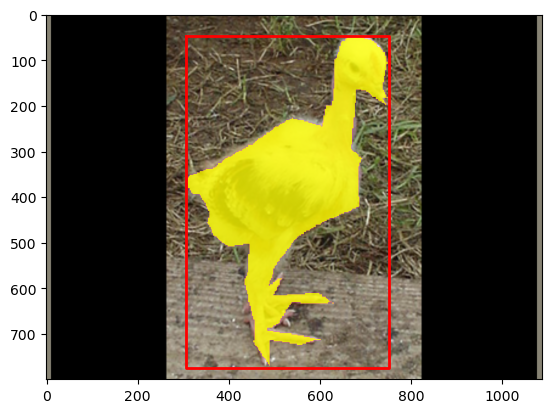

0


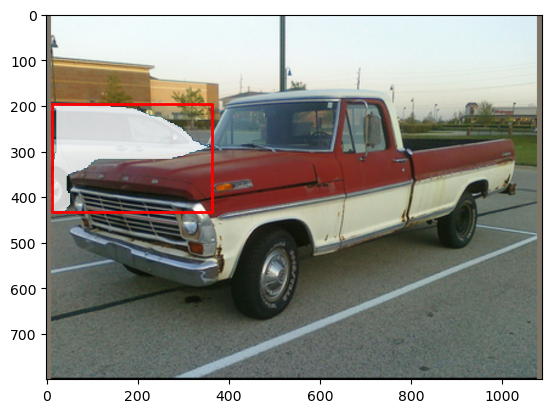

0


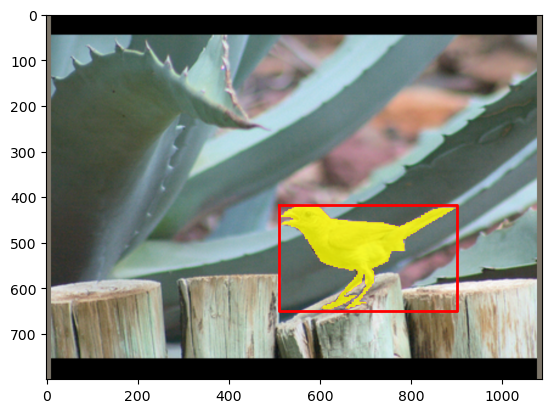

0


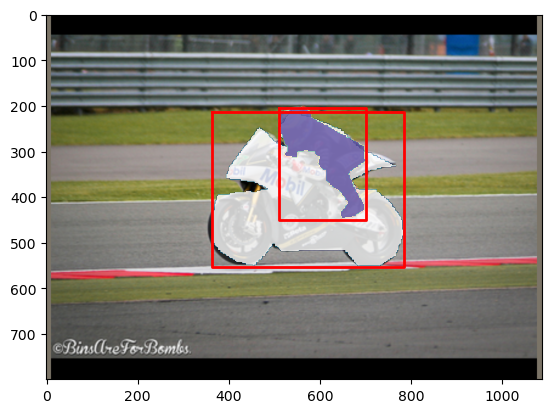

0


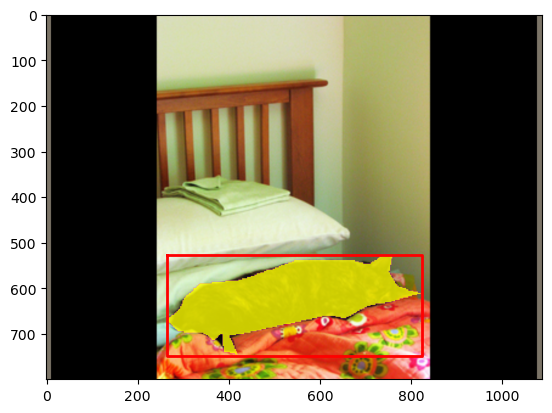

0


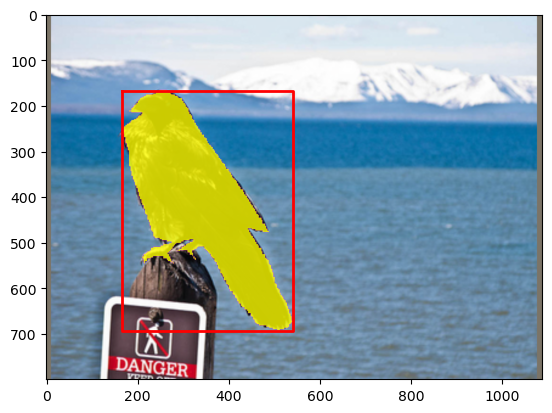

0


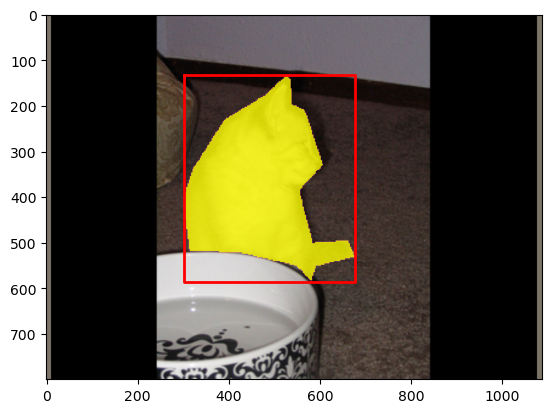

0


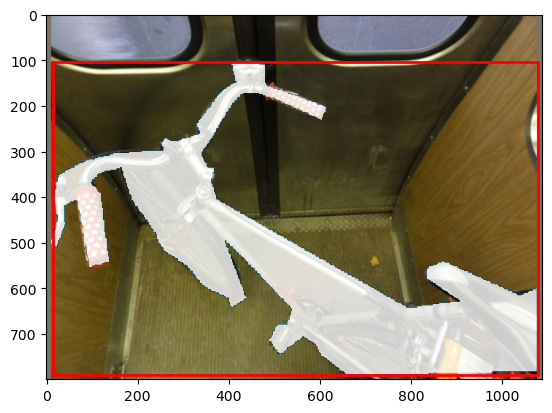

0


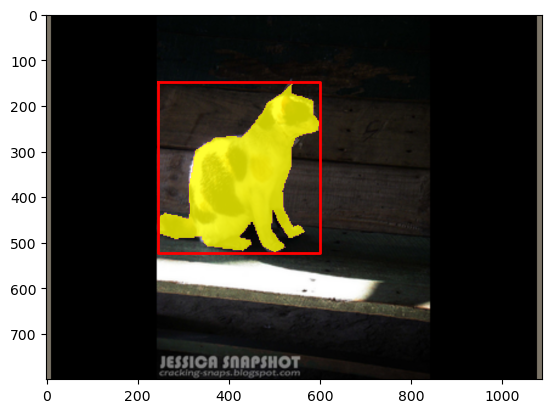

In [7]:
for check, data in enumerate(train_loader):
    img, label, mask, bbox = data
    # check flag
    assert img.shape == (batch_size, 3, 800, 1088)
    assert len(mask) == batch_size

    # plot the origin img
    for i in range(batch_size):
        print(i)
        _img = img[i].permute(1, 2, 0)
        plt.imshow((_img - _img.flatten(0, 1).min(dim=0).values) / (_img.flatten(0, 1).max(dim=0).values - _img.flatten(0, 1).min(dim=0).values))
        for _label, _mask, _bbox in zip(label[i], mask[i], bbox[i]):
            plt.plot(
                [_bbox[0], _bbox[0], _bbox[2], _bbox[2], _bbox[0]],
                [_bbox[1], _bbox[3], _bbox[3], _bbox[1], _bbox[1]],
                'r', linewidth=2
            )
            
            plt.imshow(_mask[0, :, :], cmap=mask_color_list[_label], alpha=0.8 * _mask[0, :, :])

        #plt.savefig(f"./testfig/visualtrainset{iter}.png")
        plt.show()

    if check == 10:
        break

### Model
#### Architecture
The model architecture is summarized in fig. 7 and tables 1 and 2.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig7.png" width=500/></div>
<center>Figure 7: SOLO branch structure.</center>
<br>
<center>Table 1: Category branch structure.</center>

| Layer | Hyperparameters |
| :--- | :--- |
| conv1 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv2 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv3 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv4 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv5 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv6 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv7 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv_out | Kernel size $= 3\times3\times(C-1)$, stride $= 1$, pad $= 1$, bias $= \text{True}$. <br> Followed by Sigmoid layer. Note $C = 4$ here (number of classes + background). |

<br>
<center>Table 2: Mask branch structure.</center>

| Layer | Hyperparameters |
| :--- | :--- |
| conv1 | Kernel size $= 3\times3\times(256 + 2)$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Two additional input channels represent the $x$ and $y$ positional encoding. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv2 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv3 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv4 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv5 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv6 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv7 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv_out | Kernel size $= 1\times1\times(\text{num_grid})^2$, stride $= 1$, pad $= 0$, bias $= \text{True}$. <br> Followed by Sigmoid layer. Note that $\text{num_grid}$ is different for each layer of the FPN. |

We will be using a pretrained backbone (which includes an FPN), so you will not have to implement those components. A template for the network with along with default parameters is shown below.

#### Feature Pyramid
The feature pyramid extracted below has strides $[4,8,16,32,64]$ over the original image. To match the SOLO paper, this should be interpolated to have strides $[8,8,16,32,32]$.

#### Target Assignment
Some notes about generating the ground truth targets:
* The FPN levels can be though of as different grid sizes cut through the image.
* You assign each target to a certain FPN level if $\sqrt{wh}$ from the bounding box falls within the `scale_range` associated with that level. Note that these overlap, so you may assign the same target to multiple levels.
* A grid cell should be considered as predicting an object if that grid cell falls into the "centre region" of the object.
 * The centre region of an object is its bounding box scaled by `epsilon`.
 * Each grid cell can predict at most one object, but each object can be predicted by more than one grid cell.

#### Target Visualization
You should produce visualizations such as fig. 8 and 9 to validate your target assignments.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig8.png" width=500/></div>
<center>Figure 8: Target assignment example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig9.png" width=500/></div>
<center>Figure 9: Target assignment example.</center>

In [4]:
solo_backbone = Resnet50Backbone().cpu()
solo_head = SOLOHead(4).cpu()

/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained_backbone' is deprecated since 0.13 and may be removed in the future, please use 'weights_backbone' instead.
  warnings.warn(
/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights_back

tensor([3, 3])


/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1724789563135/work/aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..6.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..3.0].


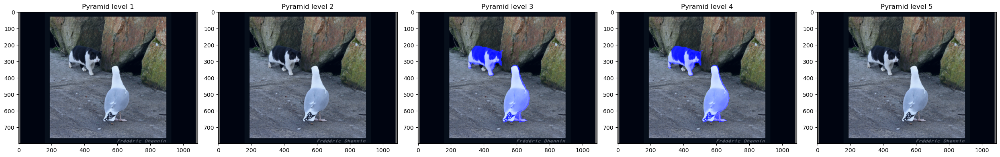

tensor([3, 2])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..10.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..9.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..6.0].


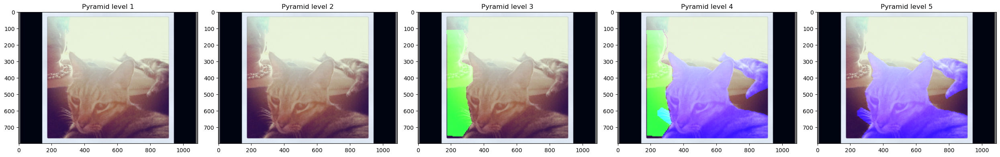

tensor([3, 1])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..12.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..6.0].


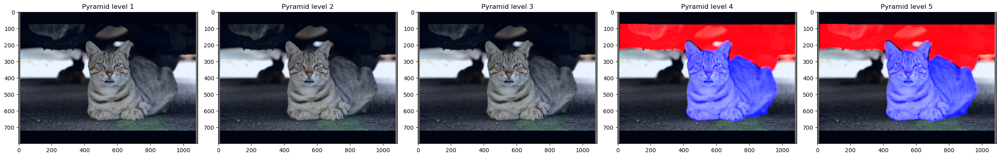

tensor([1, 1])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..13.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..6.0].


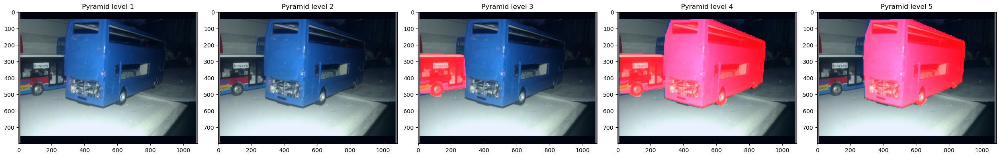

tensor([3, 2])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..12.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..9.0].


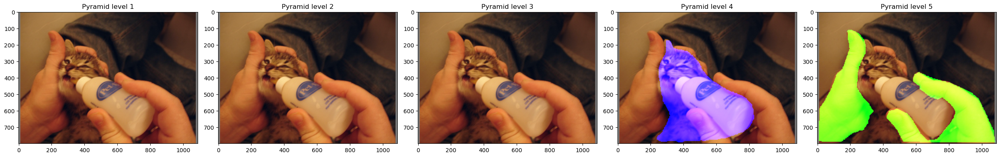

tensor([1, 2])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..9.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..9.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.0].


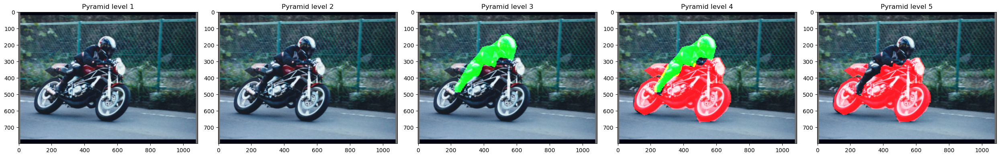

tensor([3, 2])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..2.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..9.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.0].


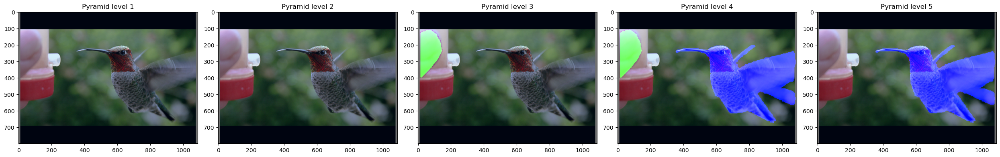

tensor([3, 3])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..8.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.0].


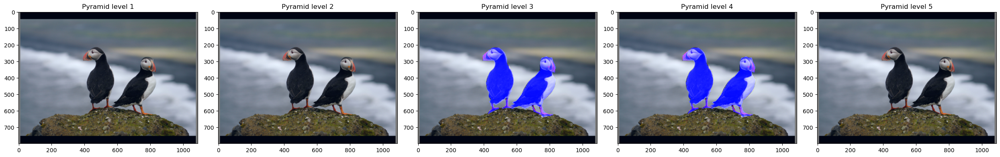

tensor([3, 1])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..12.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..9.0].


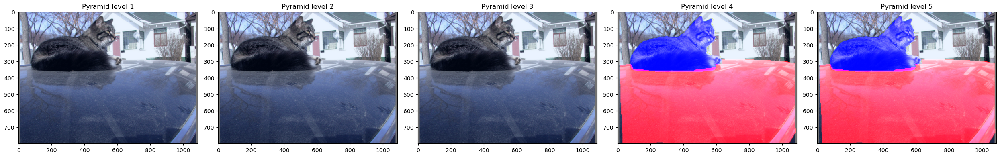

tensor([3, 3])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..6.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..9.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.0].


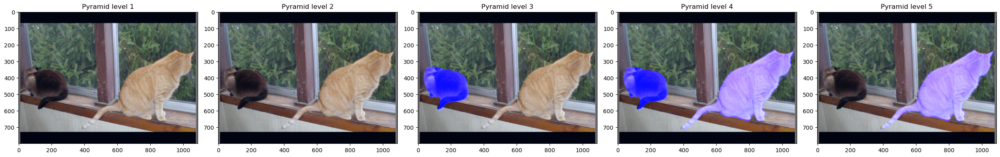

In [5]:
check = 0
for iter, data in enumerate(train_loader, 0): #list of batch_size, mask: 1x3x800x1088, bbox: 1x4, target:
    img, label_list, mask_list, bbox_list = [data[i] for i in range(len(data))]
    for label in label_list:
        if len(label) > 1:
            print(label)
            fpn_feat_list = [v.detach() for v in solo_backbone(img).values()]
            cate_pred_list, ins_pred_list = solo_head.forward(fpn_feat_list, evaluate=True)
            ins_gts_list, ins_ind_gts_list, cate_gts_list = solo_head.target(ins_pred_list, bbox_list, label_list, mask_list)
    
            mask_color = ["jet", "ocean", "Spectral"]
            solo_head.PlotGT(ins_gts_list, ins_ind_gts_list, cate_gts_list, mask_color, img)
    
            check += 1
            if check == 10:
              break
    if check == 10:
        break

### Part A Submission
In addition to the code you used, you should submit a pdf containing the following plots:
* Dataset visualization plots such as fig. 5 and 6. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Target assignment plots such as fig. 8 and 9. Should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.

We should be able to reproduce your results with a single function call or cell evaluation. Please specify the method to do so.

## Part B
### Loss
The loss function consists of two parts: category loss and mask loss:
$$L = \lambda_\text{cate} L_\text{cate} + \lambda_\text{mask} L_\text{mask} $$

The category loss is defined as (where $\text{FL}$ is the focal loss)

$$L_\text{cate} = \frac{1}{S^2 C} \sum_{S,S,C} \text{FL}(p_t)$$

$$\text{FL}(p_t) = -\alpha_t (1 - p_t)^\gamma \log{(p_t)}$$

$$(\alpha_t, p_t) = \left\{\begin{array}{lr} (\alpha, \hat{p}) & \text{if }y=1 \\ (1 - \alpha, 1 - \hat{p}) & \text{otherwise}\end{array}\right.$$

while the mask loss is defined as (where $d_\text{mask}$ is the dice loss)

$$L_\text{mask} = \frac{1}{N_\text{positive}} \sum_k \mathbb{1}_{\{p_{i, j} > 0\}} d_\text{mask}(m_k, \hat{m}_k)$$

$$d_\text{mask}(p, q) = 1 - D(p, q)$$

$$D(p, q) = \frac{2 \sum_{x,y}(p_{x,y} \cdot q_{x,y})}{\sum_{x,y}p_{x,y}^2 + \sum_{x,y}q_{x,y}^2}$$

### Post Processing
Post processing consists of three steps: points NMS, concatenation and sorting, and matrix NMS. A summary of each of these steps is provided below. In addition, your final mask prediction should be a binary mask based on the mask thresholding parameter. Some examples of results post-inference are shown in figs. 11-14.


<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig11.png" width=300/></div>
<center>Figure 11: SOLO instance segmentation example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig12.png" width=300/></div>
<center>Figure 12: SOLO instance segmentation example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig13.png" width=300/></div>
<center>Figure 13: SOLO instance segmentation example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig14.png" width=300/></div>
<center>Figure 14: SOLO instance segmentation example.</center>

#### Points NMS
Non-max suppression for the category predictions, applied to each channel sperately. A maxpooling with a kernel size of 2, sample code is included below.

#### Concatenation and Sorting
Here, we merge the predictions across all the FPN levels into a single list of predictions, sorted by their predicted score. This involves rescaling the predicted masks appropriately.

#### Matrix NMS
Inspired by Soft-NMS, MatrixNMS suppresses mask predictions with a lower score based on their similarity to predictions with a higher score in a completely vectorized manner. Sample code is include below.

In [9]:
check = 0
for iter, data in enumerate(train_loader, 0): #list of batch_size, mask: 1x3x800x1088, bbox: 1x4, target:
    img, label_list, mask_list, bbox_list = [data[i] for i in range(len(data))]
    for label in label_list:
        if len(label) > 1:
            fpn_feat_list = [v.detach() for v in solo_backbone(img).values()]
            cate_pred_list, ins_pred_list = solo_head.forward(fpn_feat_list, eval=True)
            ins_gts_list, ins_ind_gts_list, cate_gts_list = solo_head.target(ins_pred_list, bbox_list, label_list, mask_list)
    
            print(solo_head.loss(cate_pred_list, ins_pred_list, ins_gts_list, ins_ind_gts_list, cate_gts_list))
            raise Exception()
    
            check += 1
            if check == 10:
              break
    if check == 10:
        break

torch.Size([7744, 3]) torch.Size([7744])
tensor([0., 0., 0.,  ..., 0., 0., 0.])


RuntimeError: one_hot is only applicable to index tensor.

In [ ]:
# Credit to SOLO Author's code
# This function does NMS on the heat map (category_prediction), grid-level
# Input:
#     heat: (batch_size, C-1, S, S)
# Output:
#     (batch_size, C-1, S, S)
def points_nms(heat, kernel=2):
    # kernel must be 2
    hmax = F.max_pool2d(
        heat, (kernel, kernel), stride=1, padding=1)
    keep = (hmax[:, :, :-1, :-1] == heat).float()
    return heat * keep

# This function performs Matrix NMS
# Input:
#     sorted_masks: (n_active, image_h/4, image_w/4)
#     sorted_scores: (n_active,)
# Output:
#     decay_scores: (n_active,)
def MatrixNMS(sorted_masks, sorted_scores, method='gauss', gauss_sigma=0.5):
    n = len(sorted_scores)
    sorted_masks = sorted_masks.reshape(n, -1)
    intersection = torch.mm(sorted_masks, sorted_masks.T)
    areas = sorted_masks.sum(dim=1).expand(n, n)
    union = areas + areas.T - intersection
    ious = (intersection / union).triu(diagonal=1)

    ious_cmax = ious.max(0)[0].expand(n, n).T
    if method == 'gauss':
        decay = torch.exp(-(ious ** 2 - ious_cmax ** 2) / gauss_sigma)
    else:
        decay = (1 - ious) / (1 - ious_cmax)
    decay = decay.min(dim=0)[0]
    return sorted_scores * decay

### Training
#### Optimizer
The SGD optimizer with a weight decay of 1e-4 and a momentum of 0.9 is used. For a batch size of 16, an initial learning rate of 16 is used (this should be scaled appropriately for different batch sizes). You should train for 36 epochs, reducing the learning rate by a factor of 10 at epochs 27 and 33.

#### Data Augemnetation
To achieve better performance, you may wish to explore some data augmentation techniques. You should be able to achieve the necessary performance without any augmentation, however.

#### Checkpointing
Due to the long training time, we highly recommend that you set up regular checkpointing during your training in case your training gets interrupted (e.g. your colab session ending).

### Part B Submission
In addition to the code you used, you should submit a pdf containing the following plots:
* Dataset visualization plots such as fig. 5 and 6. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Target assignment plots such as fig. 8 and 9. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Final inference results such as figs. 11-14. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Training and validation loss curves. These should include the focal loss, dice loss, and total loss as seperate quantities.

In addition, you should include a discussion of any issues you encountered during this project and any changes you made to the siggested architecture. If you made any interesting observations or thoughts about potential improvements, you should also include them here.

* We should be able to reproduce your results with a single function call or cell evaluation. Please specify the method to do so. You do not, however, need to submit your trained weights.


In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import copy

from collections import OrderedDict

import os
import sys
sys.path.append('./src')

from dataset import *
from backbone import *
from solo_head import *
from settings import *

from solo_model import SOLO

In [2]:
# file path and make a list
parent_dir = "./data"
paths = {
    fname.split("_")[2]: f"{parent_dir}/{fname}"
    for fname in os.listdir(parent_dir)
}

# load the data into data.Dataset
dataset = BuildDataset(paths)

#full_size = len(dataset)
#train_size = int(full_size * 0.8)
#test_size = full_size - train_size
# random split the dataset into training and testset
# set seed
torch.random.manual_seed(42)
#train_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, test_size])
# push the randomized training data into the dataloader

batch_size = 1
train_loader = BuildDataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)
#train_loader = BuildDataLoader(train_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
#test_loader = BuildDataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

In [3]:
b = next(iter(train_loader))

In [4]:
b[2][0].shape

torch.Size([1, 1, 800, 1088])

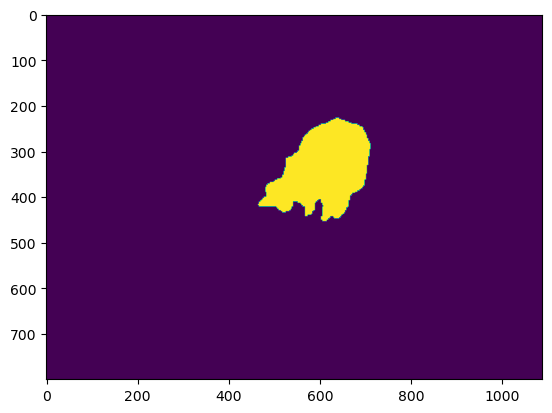

In [5]:
plt.imshow(b[2][0][0, :, :, :].permute(1, 2, 0))

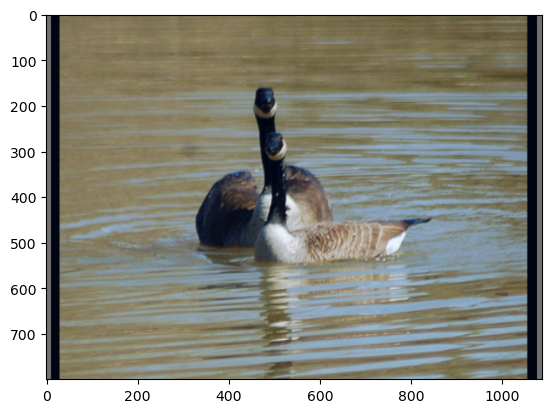

In [8]:
_img = dataset.__getitem__(1)[0].permute(1, 2, 0)
_img = ((_img - _img.min()) / (_img.max() - _img.min())).numpy(force=True)
plt.imshow(_img)

In [6]:
batch2 = b

In [7]:
master_checkpoint = torch.load("../CIS6800-HW3-SOLO_MASTER/checkpoints/yolo_epoch35")

/tmp/ipykernel_237694/3316822623.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  master_checkpoint = torch.load("../CIS6800-HW3-SOLO_MASTER/checkpoints/yolo_epoch35")


In [8]:
new_state_dict = OrderedDict()
for key in master_checkpoint['model_state_dict'].keys():
    if 'category_branch' in key:
        new_key = 'head.cate_head' + key.split('category_branch')[1]
    elif 'category_out' in key:
        new_key = 'head.cate_out' + key.split('category_out')[1]
    elif 'instance_branch' in key:
        new_key = 'head.ins_head' + key.split('instance_branch')[1]
    elif 'instance_out' in key:
        new_key = 'head.ins_out_list' + key.split('instance_out')[1]
    else:
        new_key = key

    new_state_dict[new_key] = master_checkpoint['model_state_dict'][key]

In [9]:
model = SOLO()
model.load_state_dict(new_state_dict)
model = model.cpu()

/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained_backbone' is deprecated since 0.13 and may be removed in the future, please use 'weights_backbone' instead.
  warnings.warn(
/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights_back

In [10]:
img, label_list, mask_list, bbox_list = batch2
cate_pred_list, ins_pred_list = model.forward(img, evaluate=True)

/home/andrew/miniconda3/envs/sandbox/lib/python3.12/site-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1724789563135/work/aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [11]:
ins_pred_list[3][0, 100, 10:-10, 10:-10]

tensor([[0.0022, 0.0022, 0.0021,  ..., 0.0026, 0.0031, 0.0031],
        [0.0022, 0.0022, 0.0021,  ..., 0.0026, 0.0031, 0.0031],
        [0.0022, 0.0022, 0.0021,  ..., 0.0027, 0.0034, 0.0034],
        ...,
        [0.0025, 0.0025, 0.0023,  ..., 0.0016, 0.0013, 0.0013],
        [0.0027, 0.0027, 0.0025,  ..., 0.0021, 0.0018, 0.0018],
        [0.0027, 0.0027, 0.0025,  ..., 0.0021, 0.0018, 0.0018]],
       grad_fn=<SliceBackward0>)

In [12]:
ins_gts_list, ins_ind_gts_list, cate_gts_list = model.head.target(ins_pred_list, bbox_list, label_list, mask_list)

In [13]:
ins_gts_list[0][3].shape

torch.Size([256, 200, 272])

In [14]:
cate_gts_list

([tensor([[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]]),
  tensor([[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]]),
  tensor([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
           0., 0., 0., 0., 0., 0.],
          [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
           0., 0., 0., 0., 0., 0.],
          [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
           0., 0., 0., 0., 0., 0.],
          [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
           0., 0., 0.,

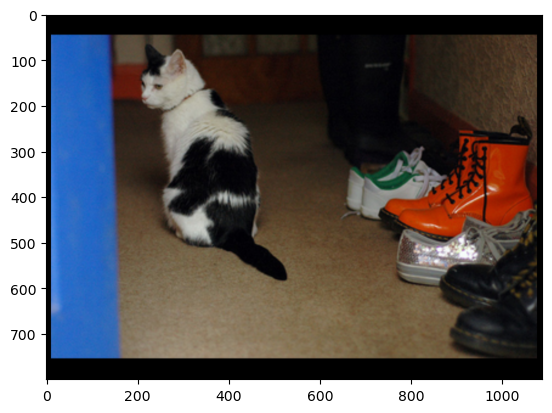

In [41]:
_img = img[0].permute(1, 2, 0)
_img = ((_img - _img.min()) / (_img.max() - _img.min())).numpy(force=True)

plt.imshow(_img)

In [34]:
ins_pred_list[3][0, 100, 50:-50, 50:-50]

tensor([[0.0017, 0.0017, 0.0020,  ..., 0.0032, 0.0028, 0.0028],
        [0.0017, 0.0017, 0.0020,  ..., 0.0032, 0.0028, 0.0028],
        [0.0016, 0.0016, 0.0018,  ..., 0.0035, 0.0029, 0.0029],
        ...,
        [0.0035, 0.0035, 0.0052,  ..., 0.0022, 0.0021, 0.0021],
        [0.0034, 0.0034, 0.0045,  ..., 0.0022, 0.0022, 0.0022],
        [0.0034, 0.0034, 0.0045,  ..., 0.0022, 0.0022, 0.0022]],
       grad_fn=<SliceBackward0>)

0
tensor([0.0767, 0.0654, 0.0645])


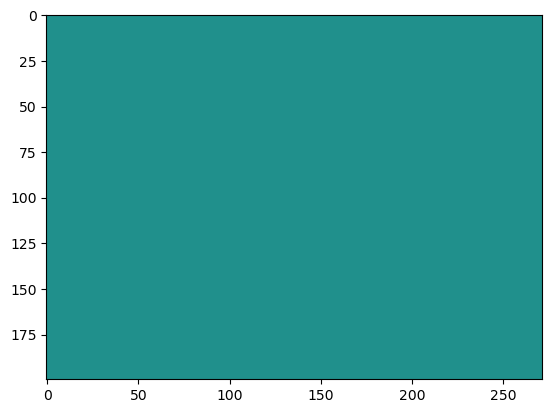

1
tensor([0., 0., 0.])


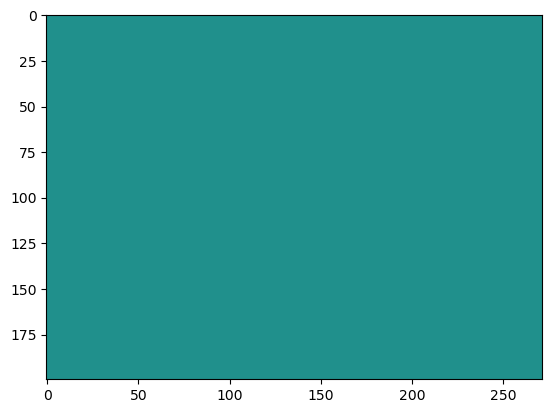

2
tensor([0.0305, 0.0258, 0.0237])


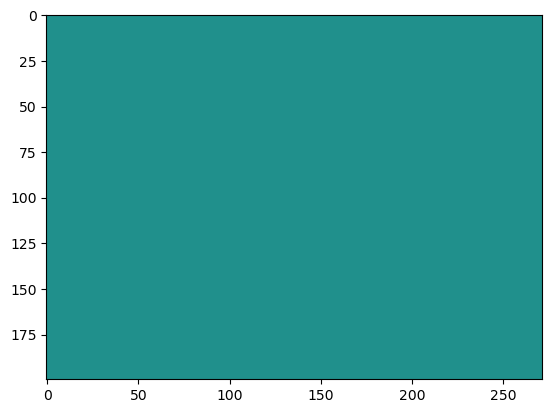

3
tensor([0.0309, 0.0261, 0.0241])


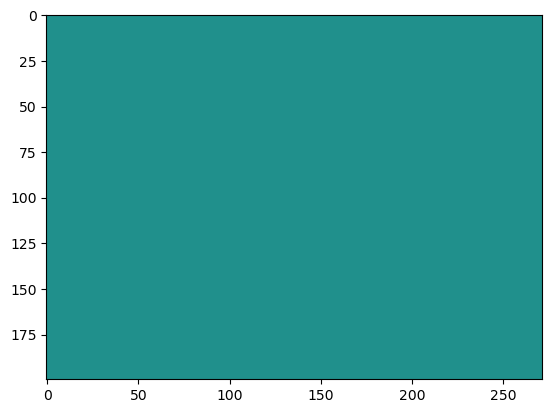

4
tensor([0.0000, 0.0261, 0.0000])


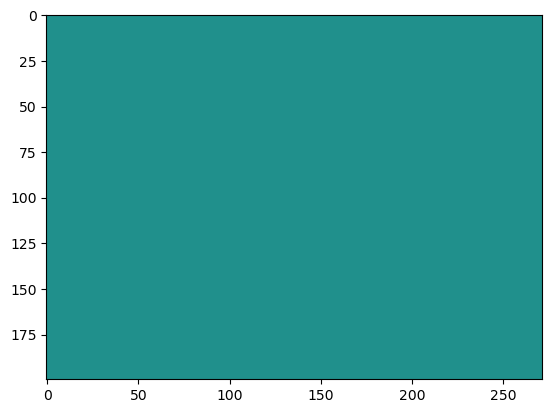

5
tensor([0.0324, 0.0276, 0.0257])


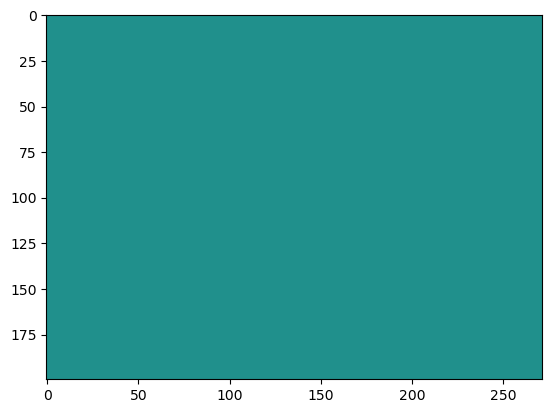

6
tensor([0.0351, 0.0303, 0.0285])


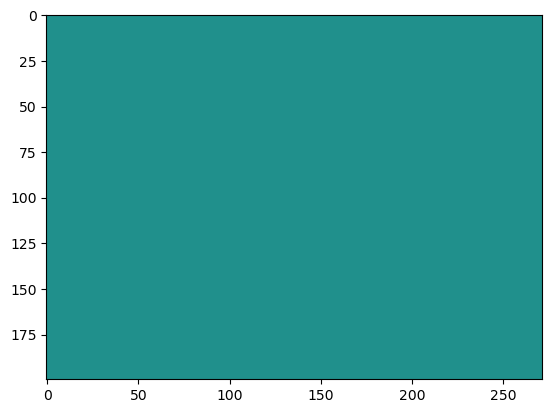

7
tensor([0.0380, 0.0331, 0.0315])


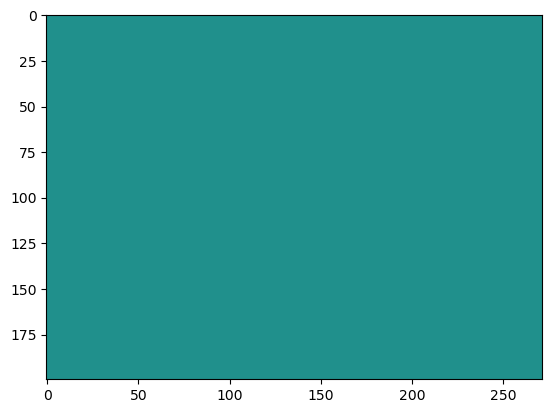

8
tensor([0.0399, 0.0350, 0.0335])


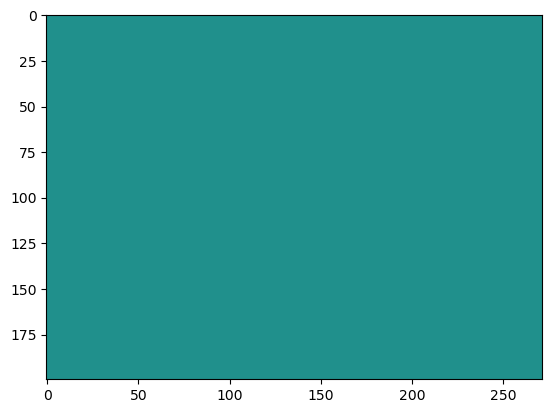

9
tensor([0.0406, 0.0357, 0.0343])


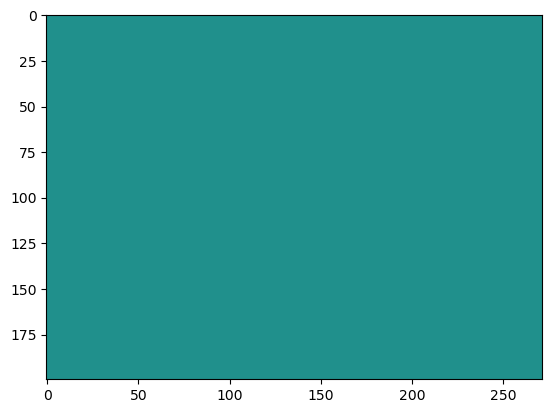

10
tensor([0., 0., 0.])


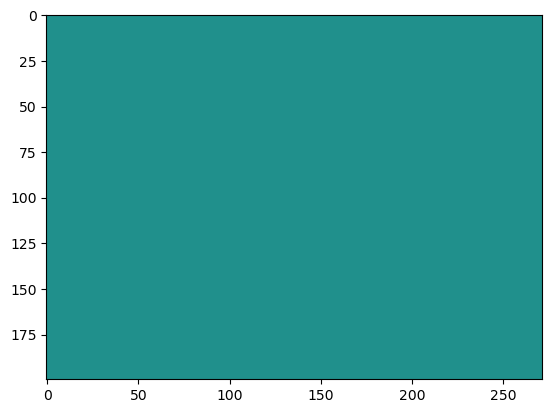

11
tensor([0., 0., 0.])


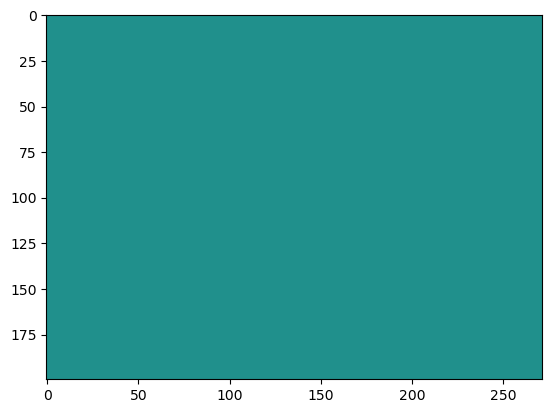

12
tensor([0., 0., 0.])


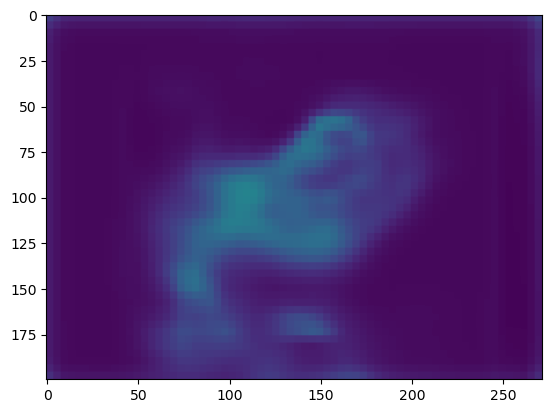

13
tensor([0., 0., 0.])


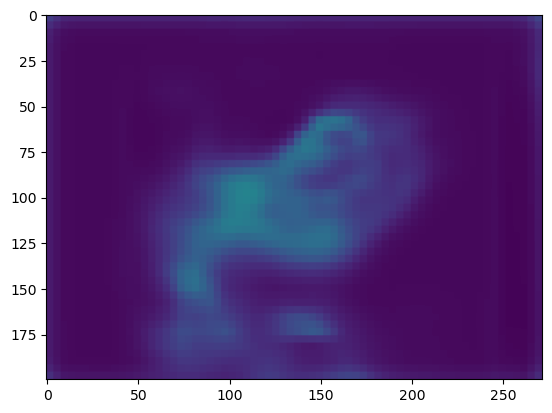

14
tensor([0., 0., 0.])


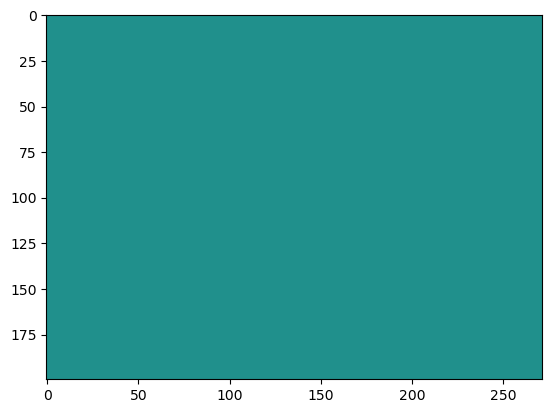

15
tensor([0.0779, 0.0671, 0.0653])


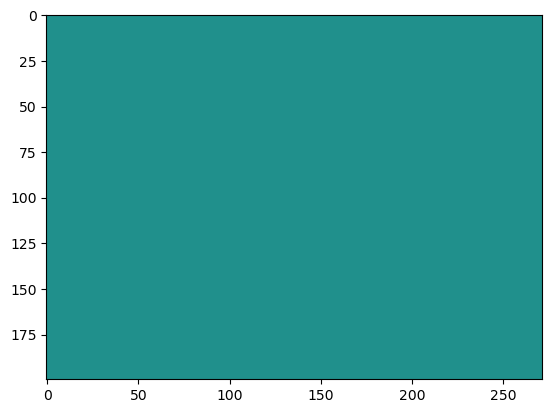

16
tensor([0., 0., 0.])


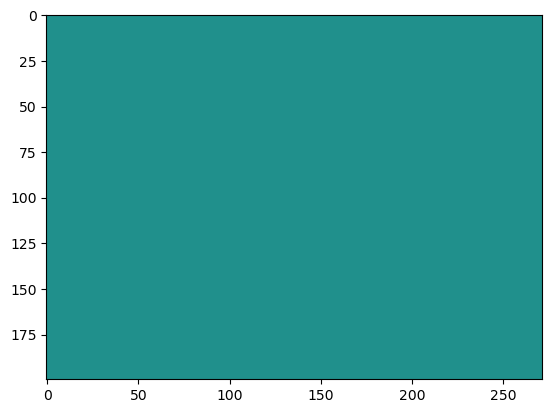

17
tensor([0., 0., 0.])


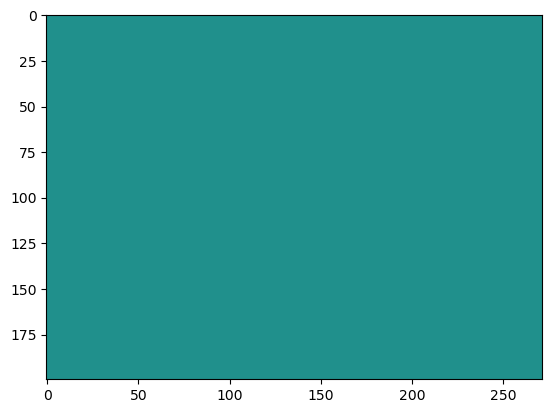

18
tensor([0., 0., 0.])


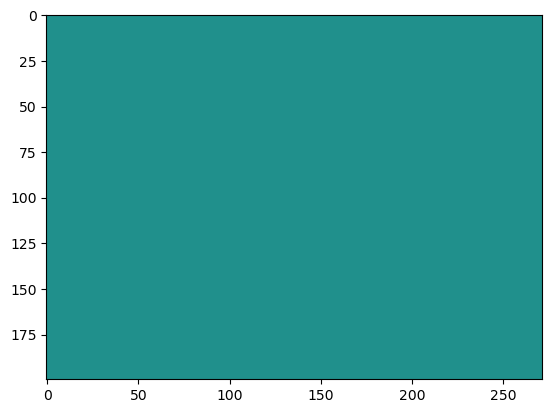

19
tensor([0., 0., 0.])


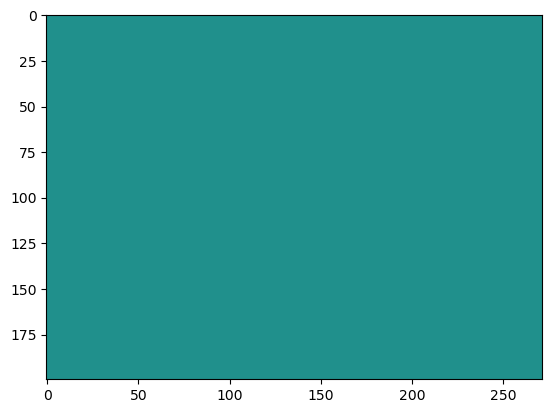

20
tensor([0., 0., 0.])


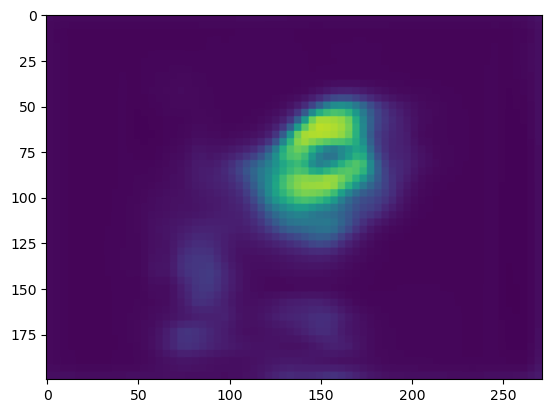

21
tensor([0., 0., 0.])


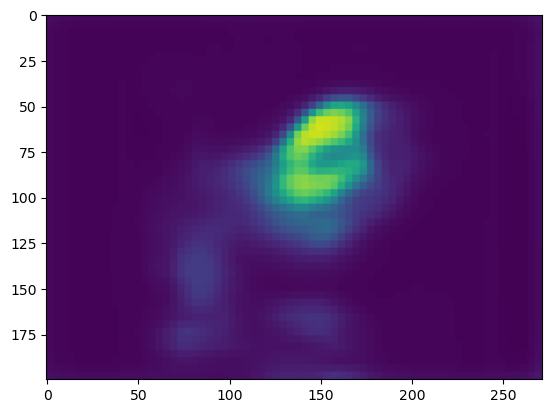

22
tensor([0., 0., 0.])


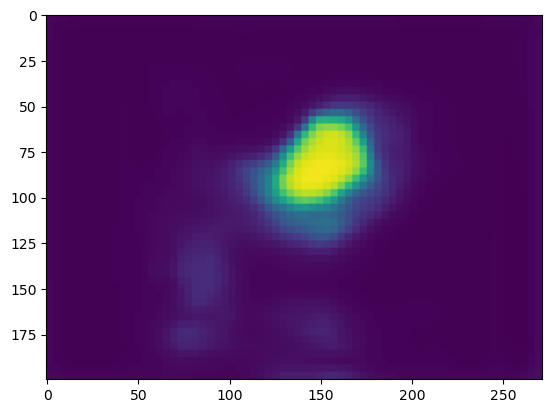

23
tensor([0., 0., 0.])


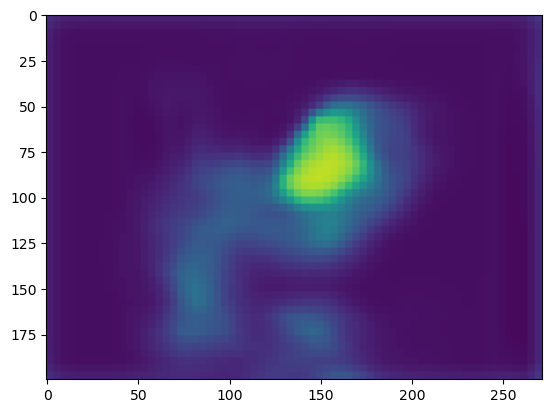

24
tensor([0., 0., 0.])


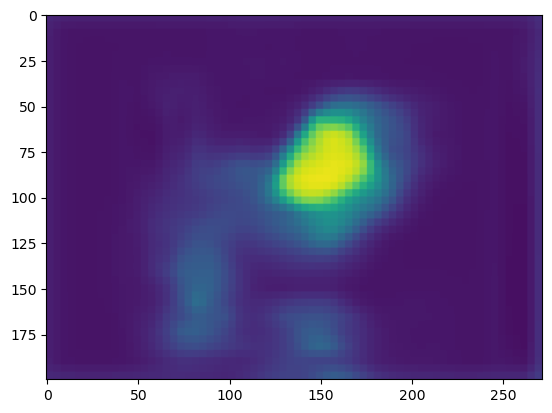

25
tensor([0., 0., 0.])


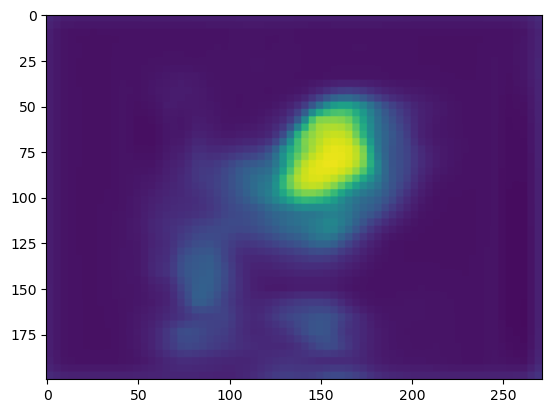

26
tensor([0., 0., 0.])


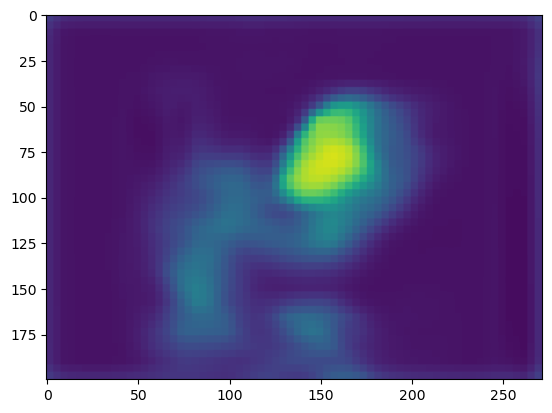

27
tensor([0., 0., 0.])


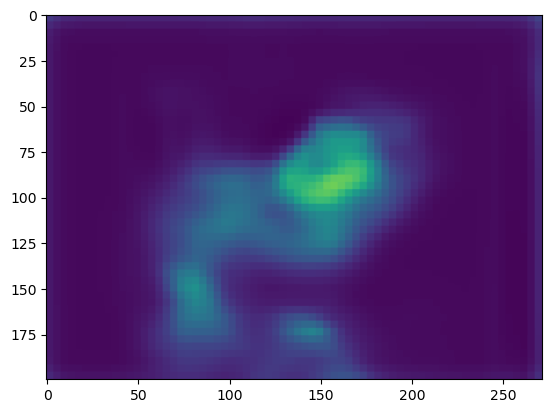

28
tensor([0., 0., 0.])


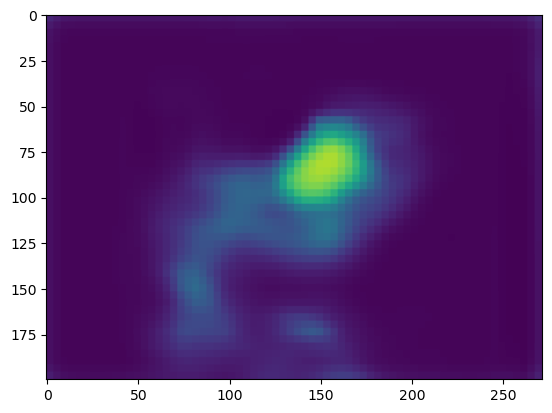

29
tensor([0., 0., 0.])


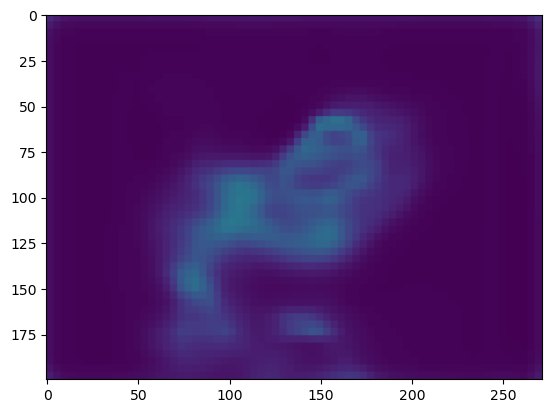

30
tensor([0., 0., 0.])


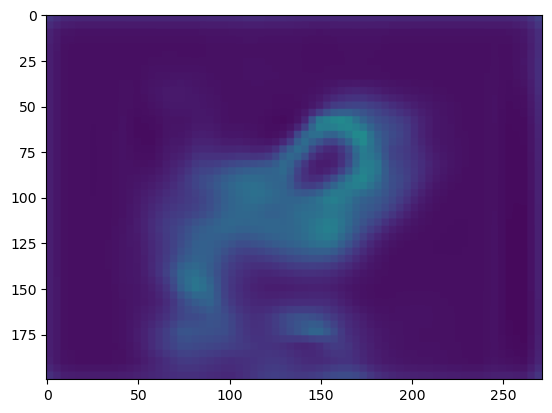

31
tensor([0., 0., 0.])


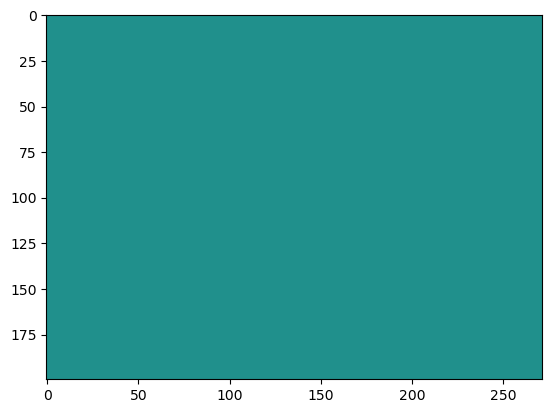

32
tensor([0.0343, 0.0286, 0.0273])


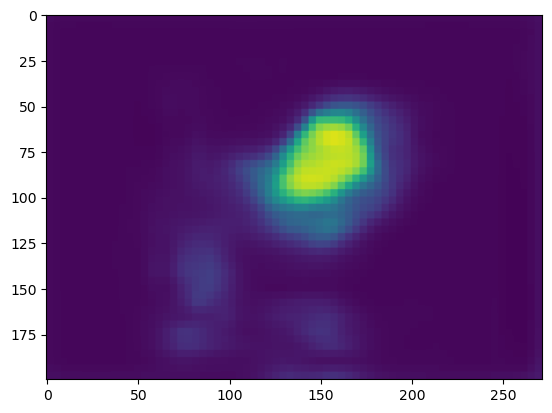

33
tensor([0., 0., 0.])


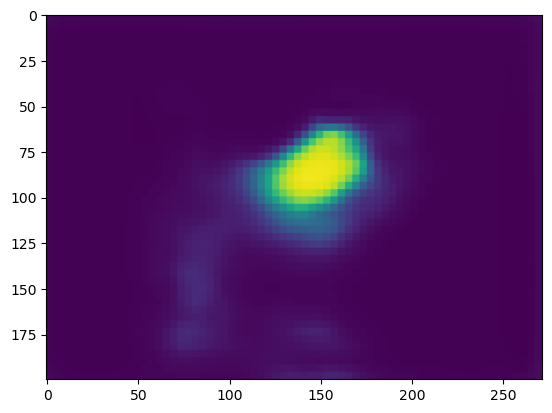

34
tensor([0.0136, 0.0118, 0.0108])


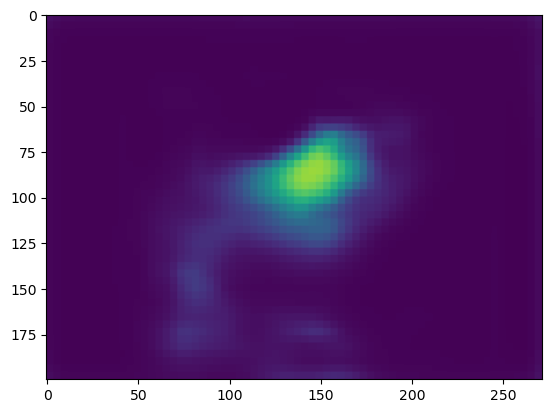

35
tensor([0.0157, 0.0137, 0.0128])


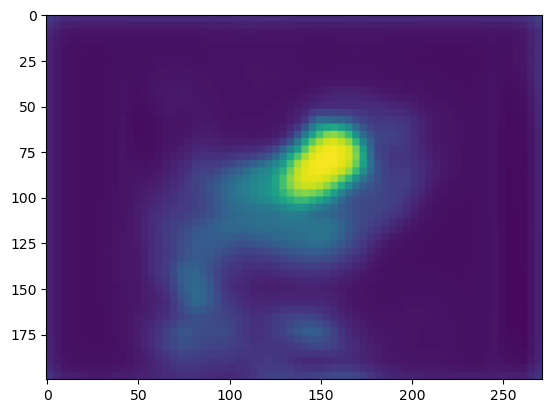

36
tensor([0.0189, 0.0168, 0.0162])


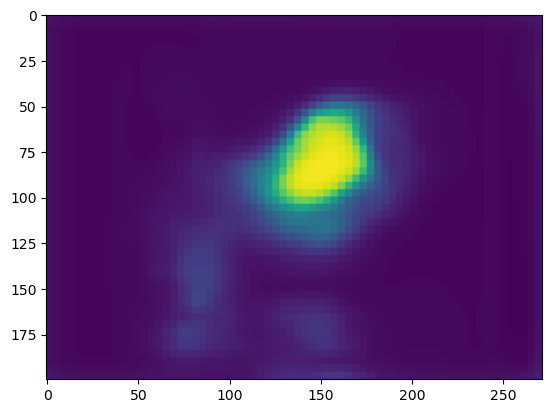

37
tensor([0.0257, 0.0235, 0.0236])


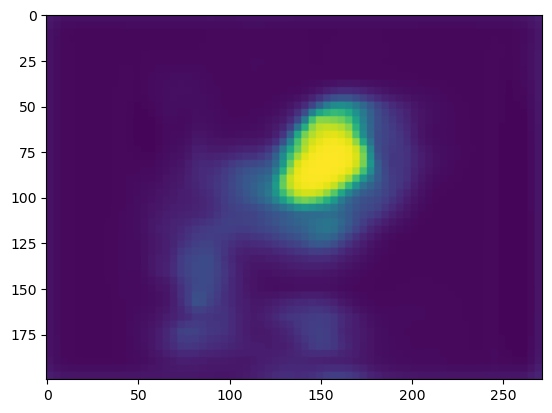

38
tensor([0.0359, 0.0335, 0.0353])


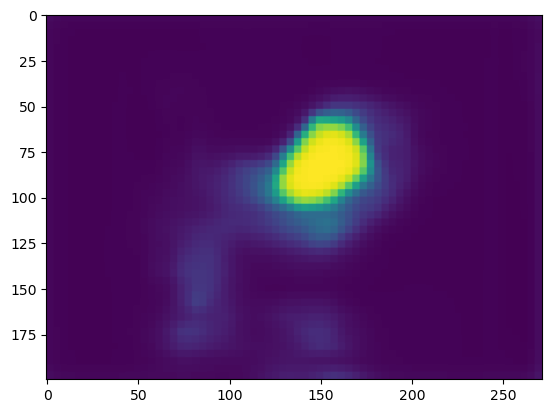

39
tensor([0.0465, 0.0440, 0.0481])


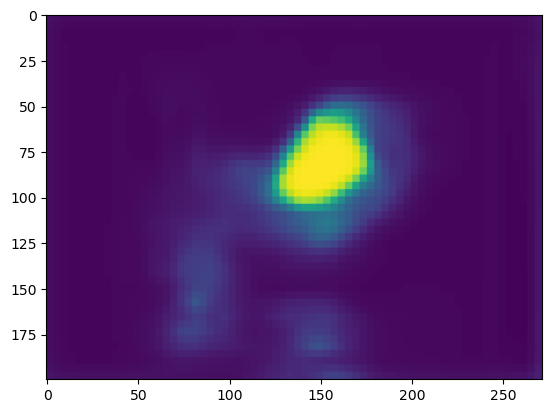

40
tensor([0.0531, 0.0505, 0.0563])


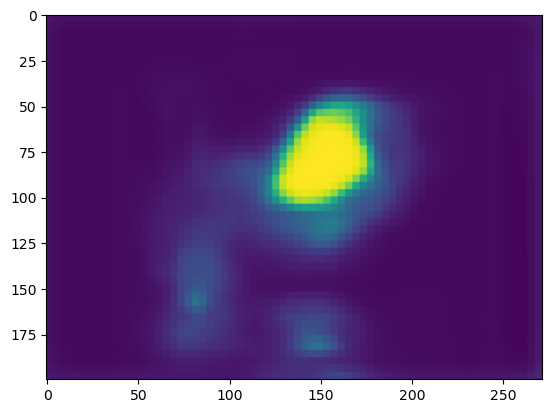

41
tensor([0., 0., 0.])


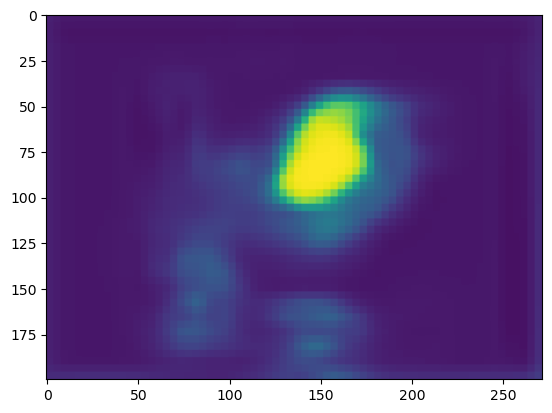

42
tensor([0., 0., 0.])


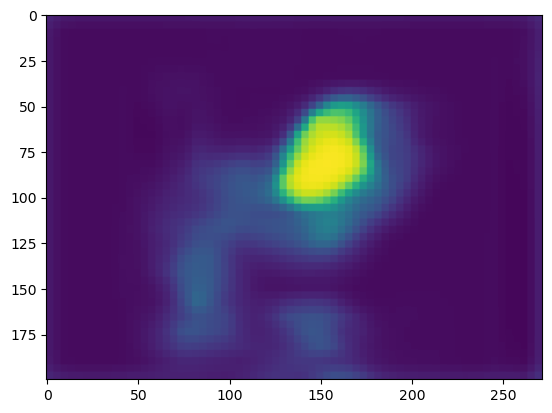

43
tensor([0., 0., 0.])


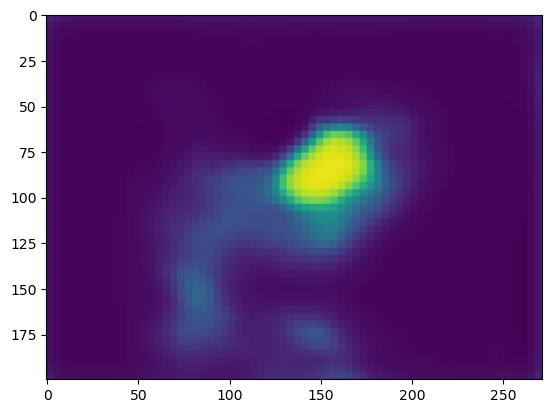

44
tensor([0., 0., 0.])


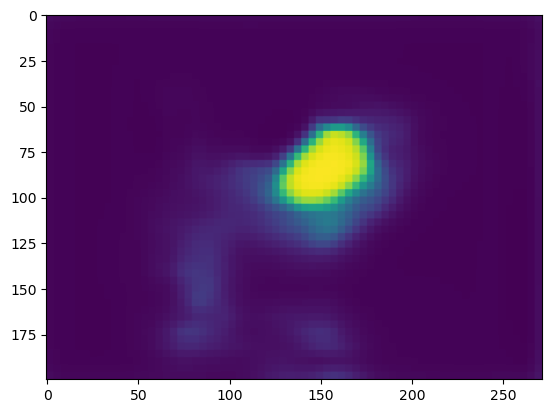

45
tensor([0., 0., 0.])


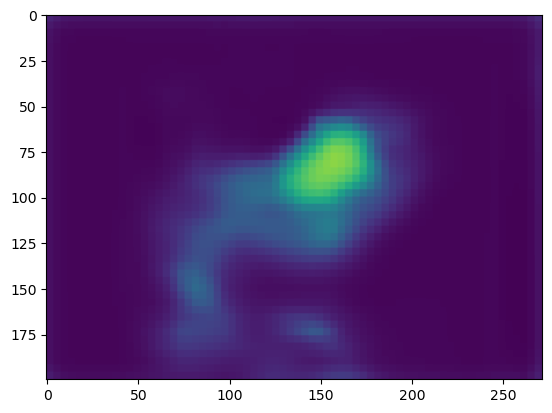

46
tensor([0., 0., 0.])


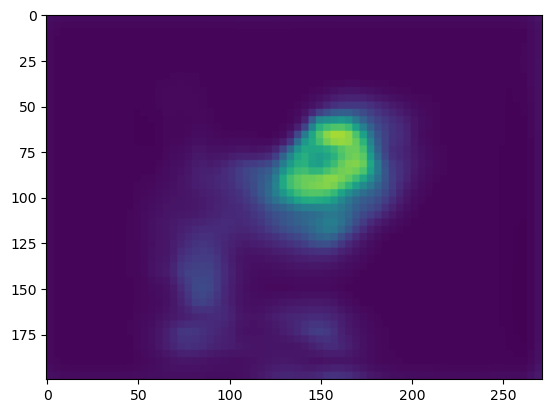

47
tensor([0.0376, 0.0319, 0.0307])


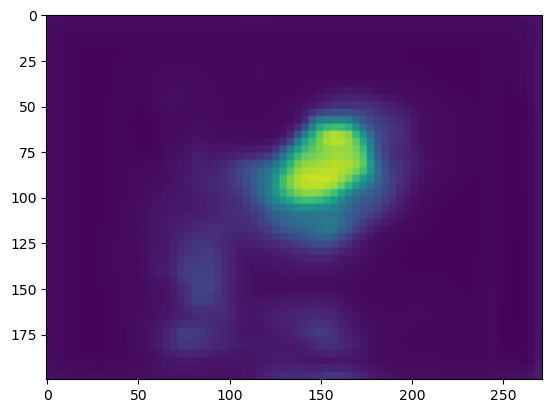

48
tensor([0.0388, 0.0324, 0.0314])


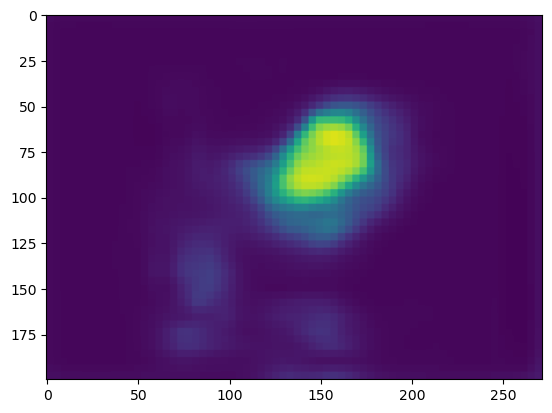

49
tensor([0., 0., 0.])


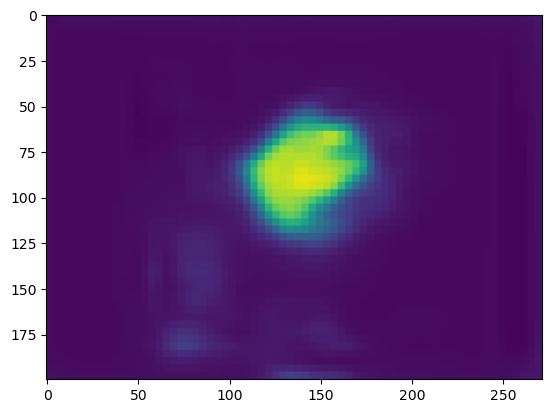

50
tensor([0.0183, 0.0160, 0.0152])


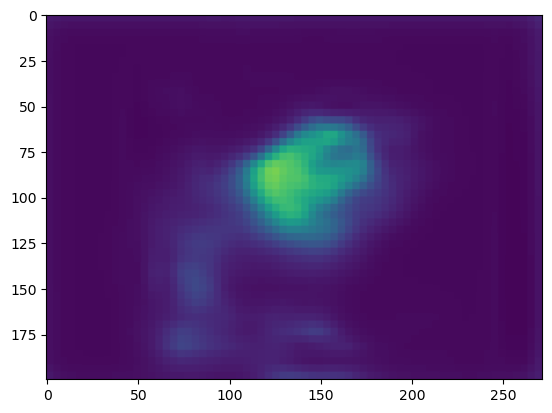

51
tensor([0.0238, 0.0210, 0.0208])


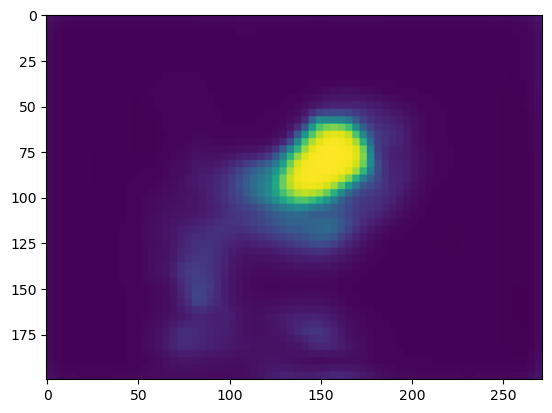

52
tensor([0.0337, 0.0305, 0.0318])


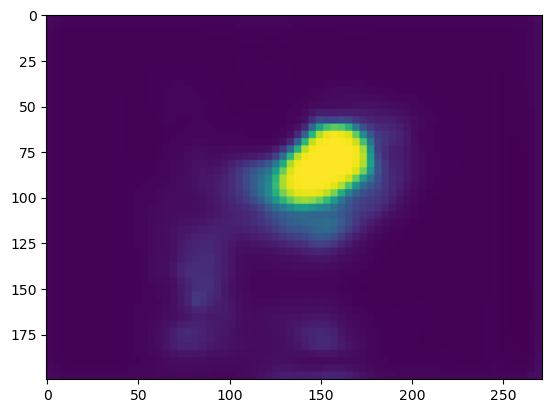

53
tensor([0.0532, 0.0497, 0.0551])


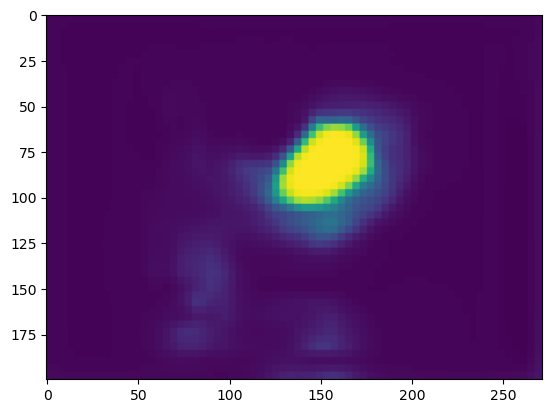

54
tensor([0.0811, 0.0774, 0.0909])


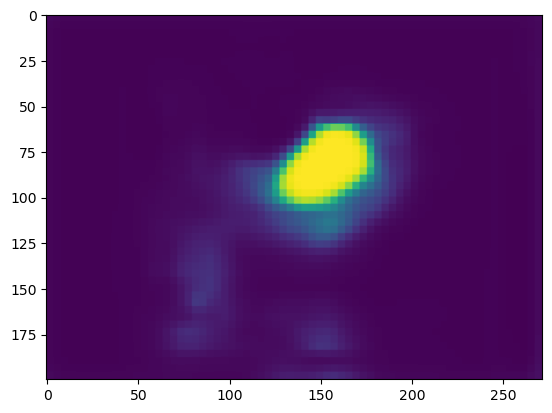

55
tensor([0.1082, 0.1045, 0.1273])


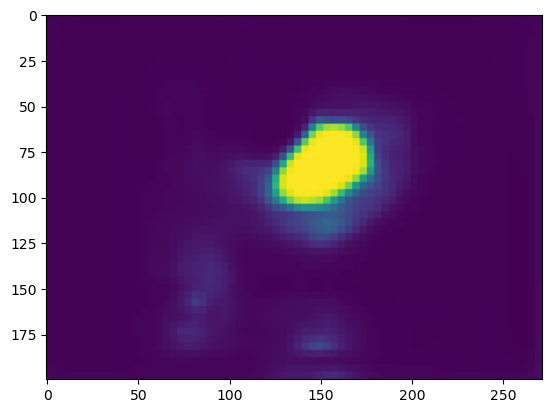

56
tensor([0.1218, 0.1180, 0.1457])


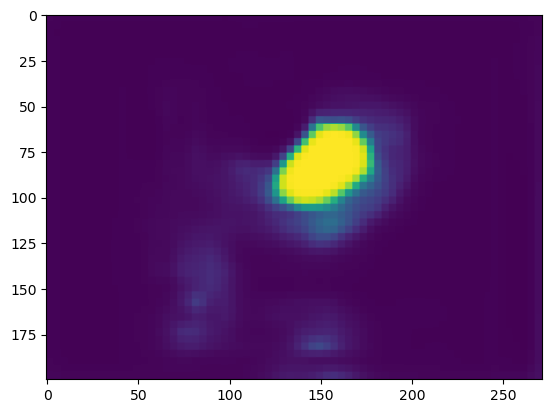

57
tensor([0., 0., 0.])


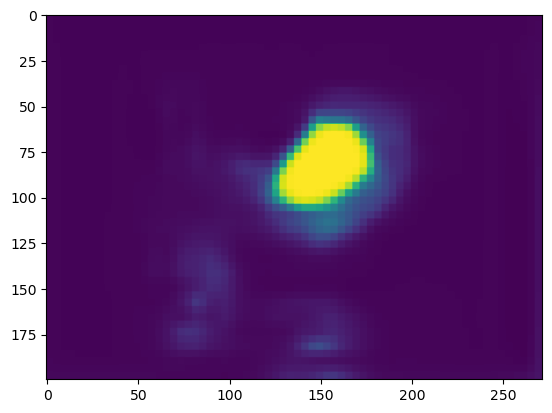

58
tensor([0., 0., 0.])


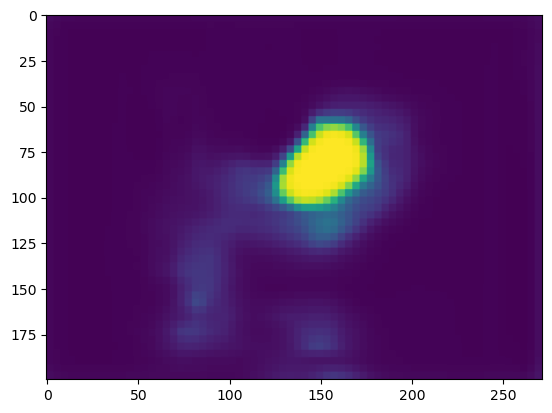

59
tensor([0., 0., 0.])


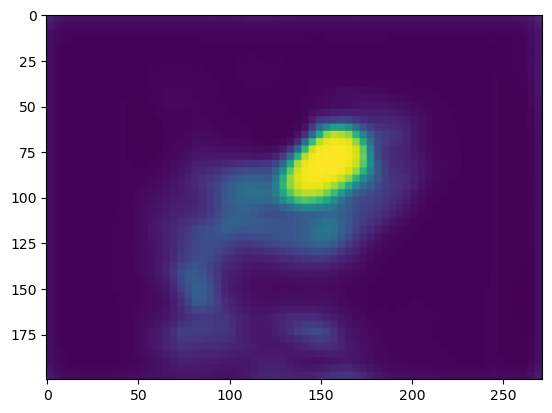

60
tensor([0., 0., 0.])


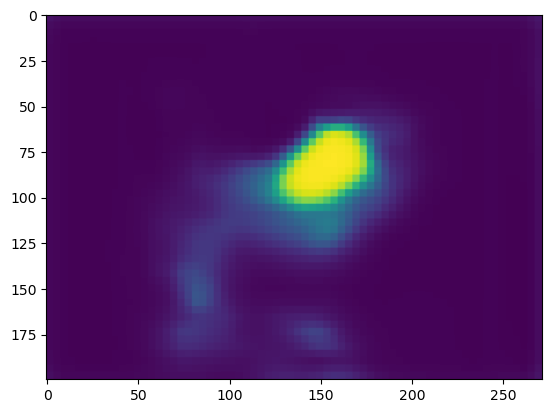

61
tensor([0., 0., 0.])


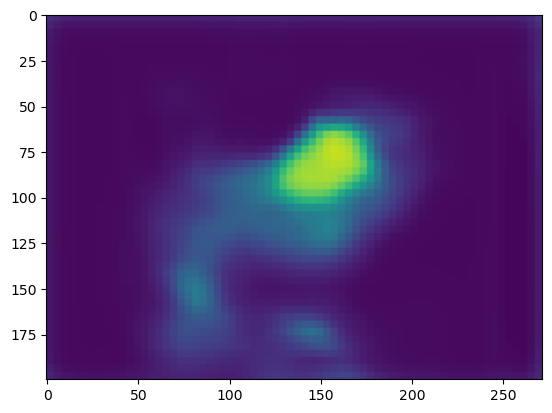

62
tensor([0., 0., 0.])


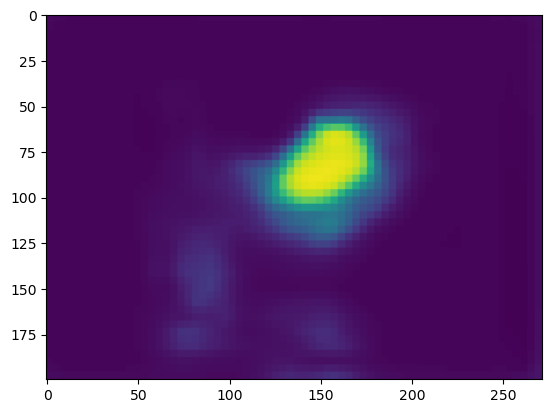

63
tensor([0.0429, 0.0362, 0.0355])


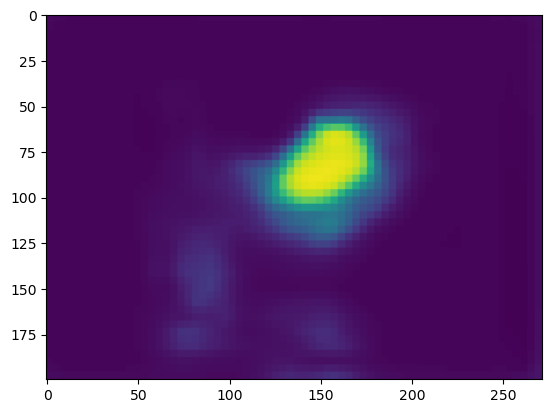

64
tensor([0.0398, 0.0332, 0.0324])


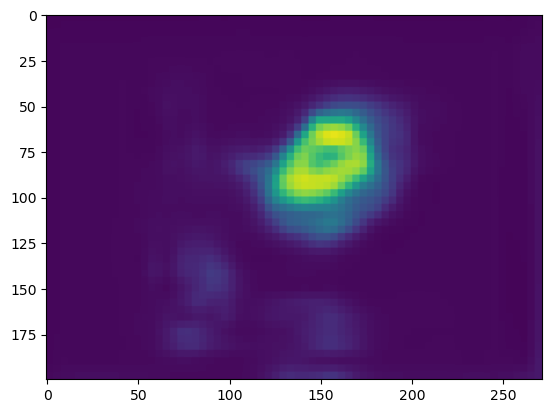

65
tensor([0., 0., 0.])


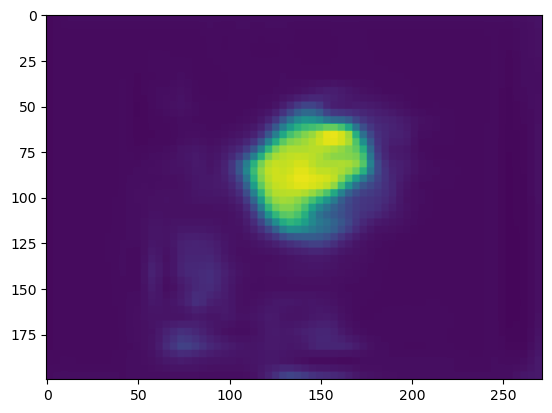

66
tensor([0.0212, 0.0186, 0.0181])


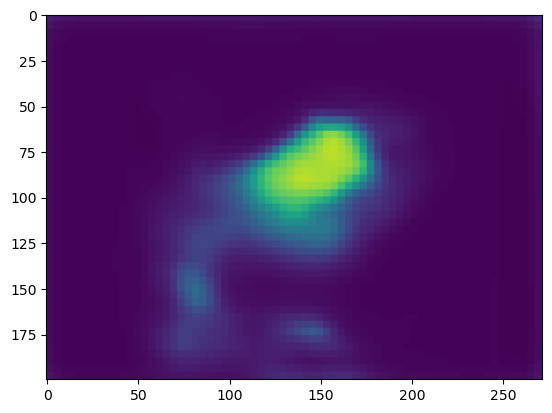

67
tensor([0.0308, 0.0274, 0.0282])


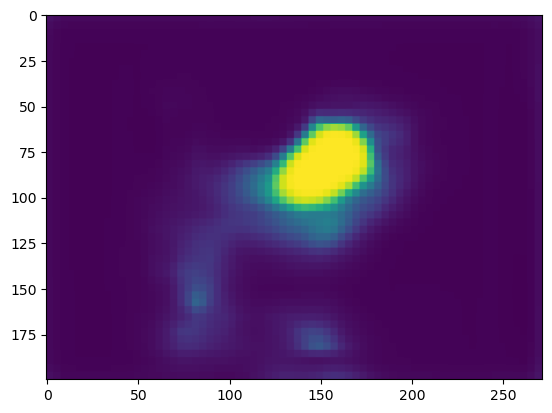

68
tensor([0.0494, 0.0451, 0.0495])


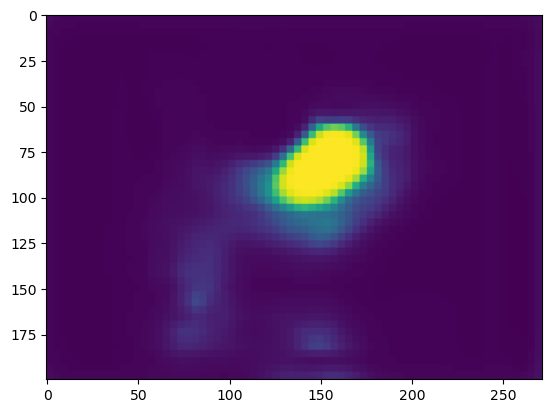

69
tensor([0.0853, 0.0801, 0.0946])


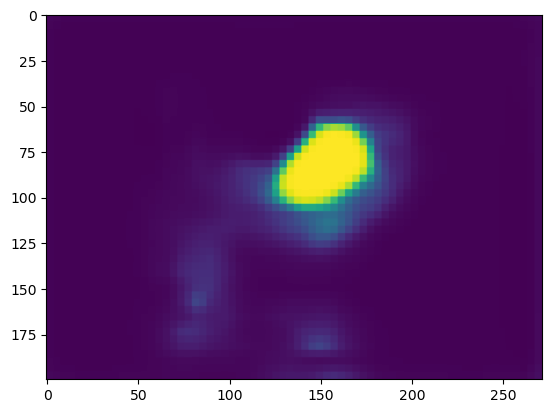

70
tensor([0.1343, 0.1288, 0.1603])


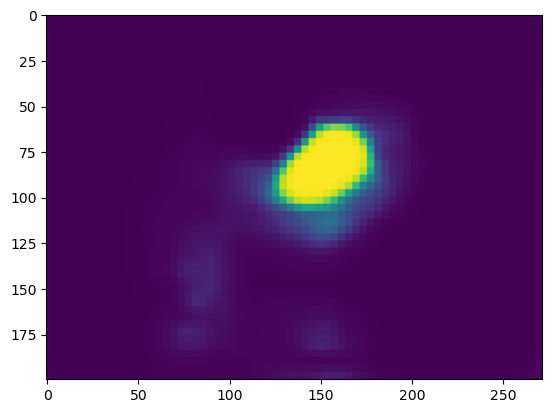

71
tensor([0.1768, 0.1714, 0.2190])


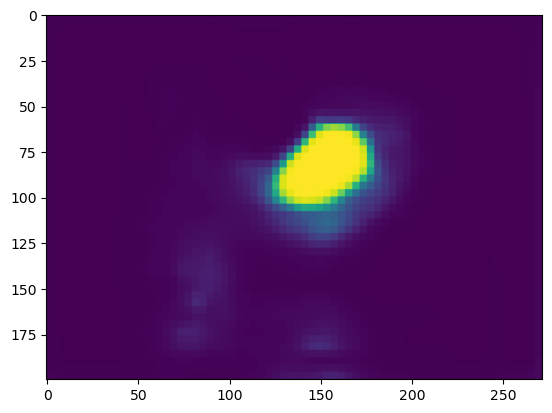

72
tensor([0.1932, 0.1879, 0.2420])


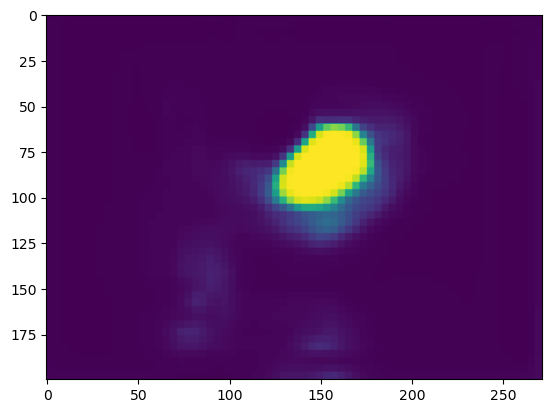

73
tensor([0., 0., 0.])


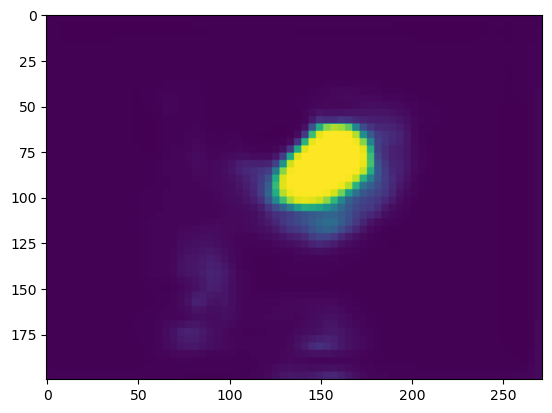

74
tensor([0., 0., 0.])


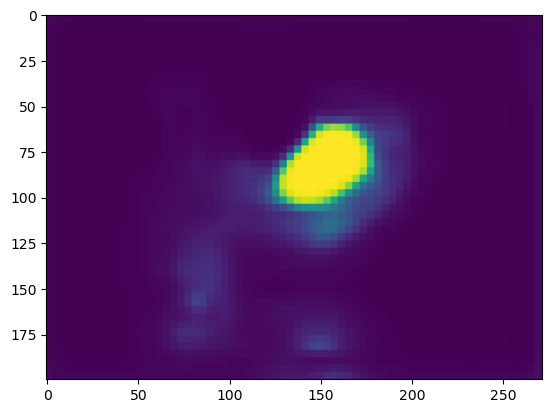

75
tensor([0., 0., 0.])


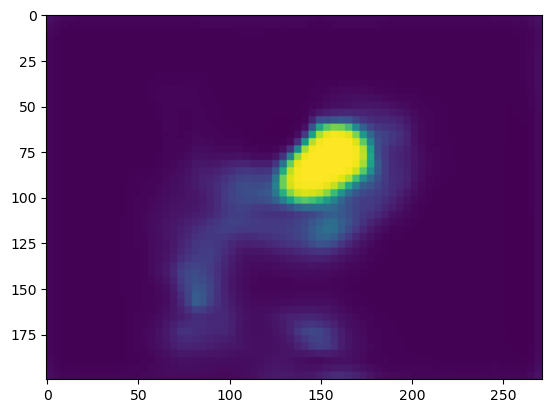

76
tensor([0., 0., 0.])


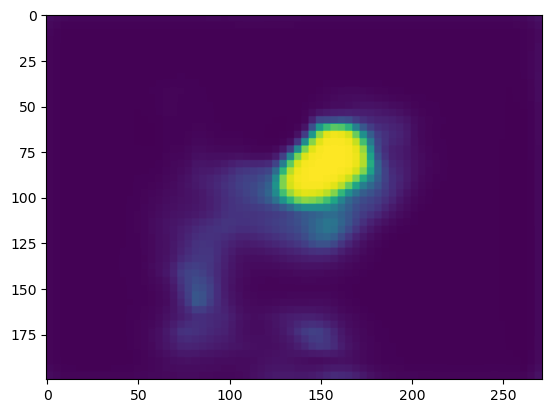

77
tensor([0., 0., 0.])


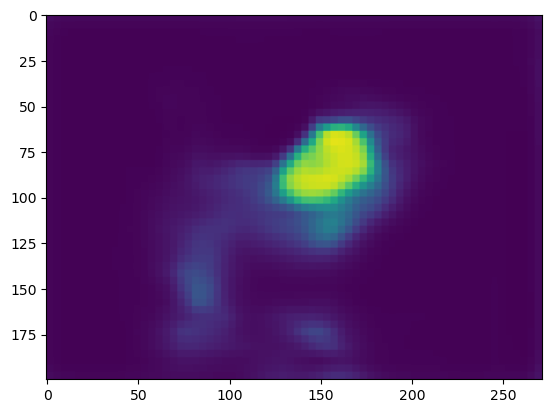

78
tensor([0., 0., 0.])


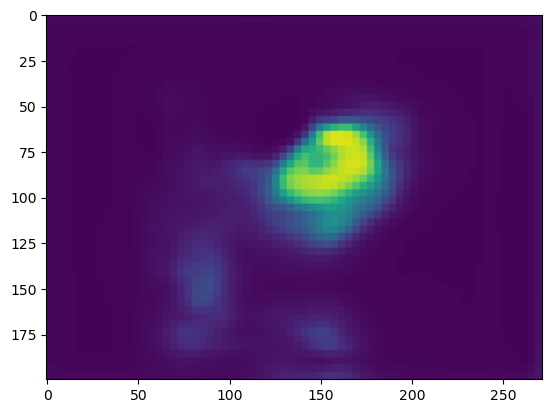

79
tensor([0.0430, 0.0364, 0.0356])


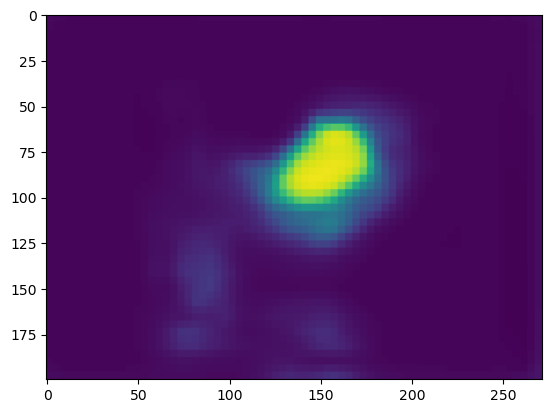

80
tensor([0.0405, 0.0339, 0.0331])


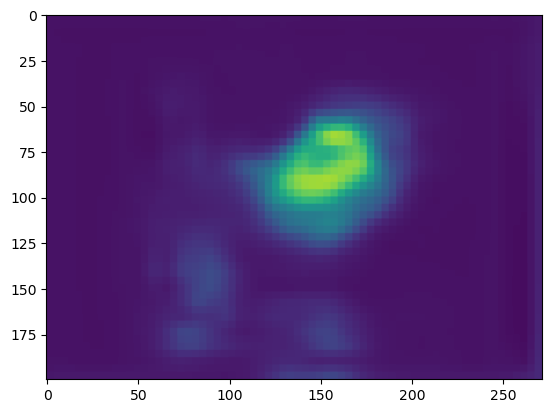

81
tensor([0., 0., 0.])


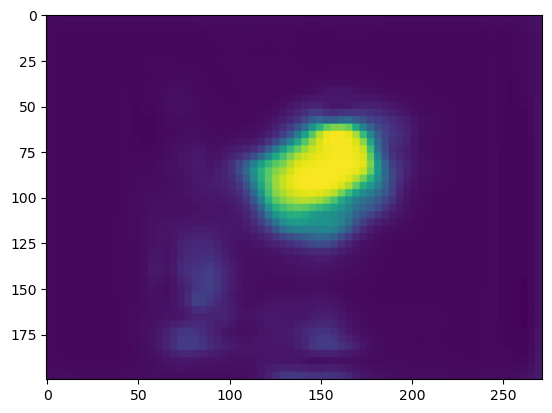

82
tensor([0.0238, 0.0208, 0.0206])


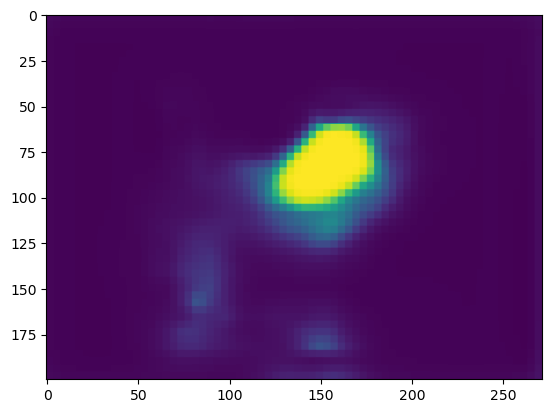

83
tensor([0.0366, 0.0325, 0.0343])


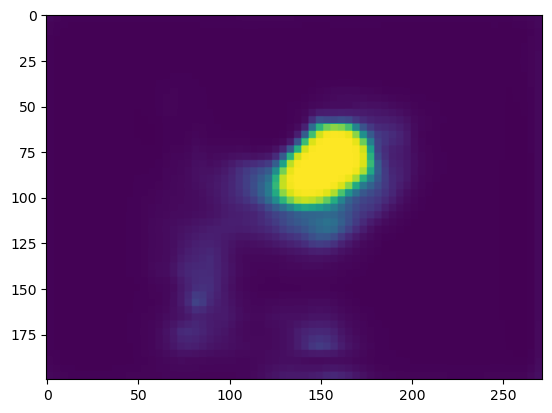

84
tensor([0.0610, 0.0554, 0.0627])


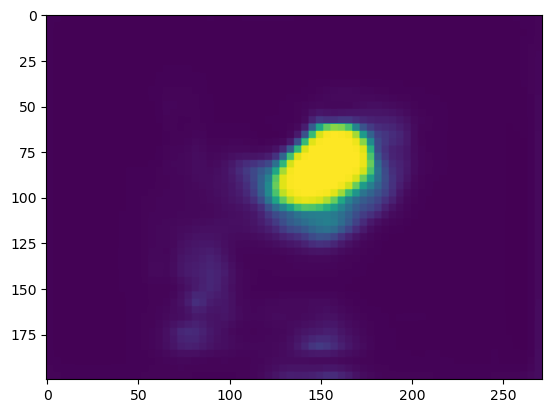

85
tensor([0.1074, 0.1001, 0.1216])


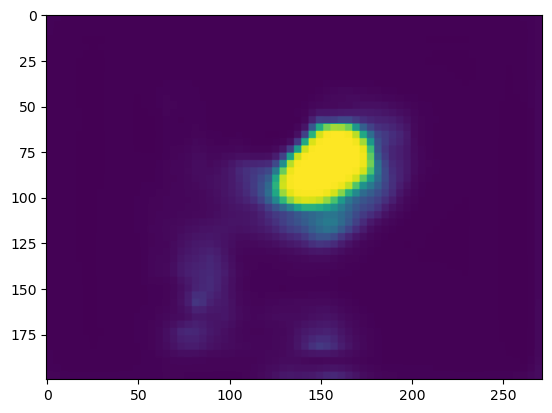

86
tensor([0.1699, 0.1619, 0.2061])


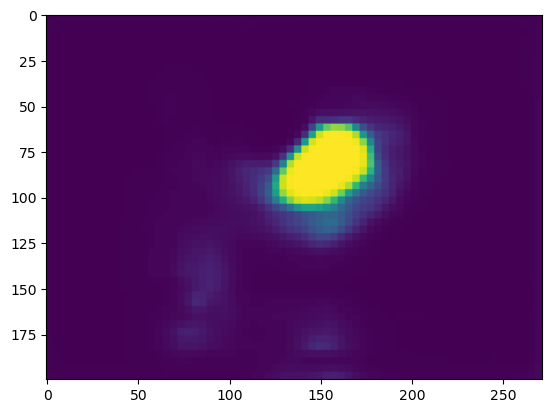

87
tensor([0.2219, 0.2143, 0.2780])


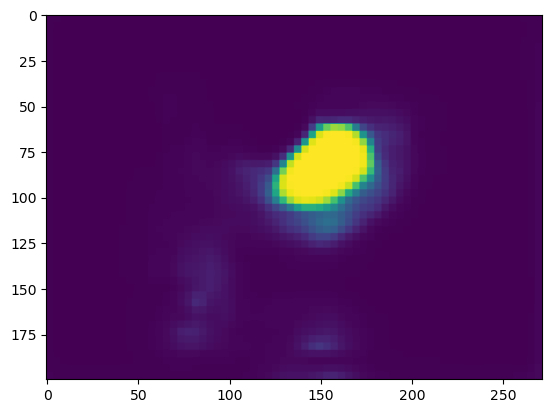

88
tensor([0.2422, 0.2351, 0.3065])


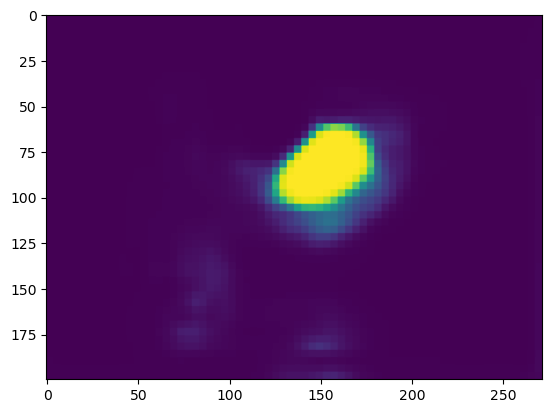

89
tensor([0., 0., 0.])


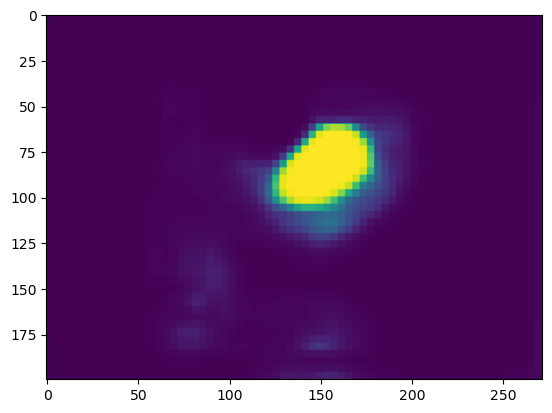

90
tensor([0., 0., 0.])


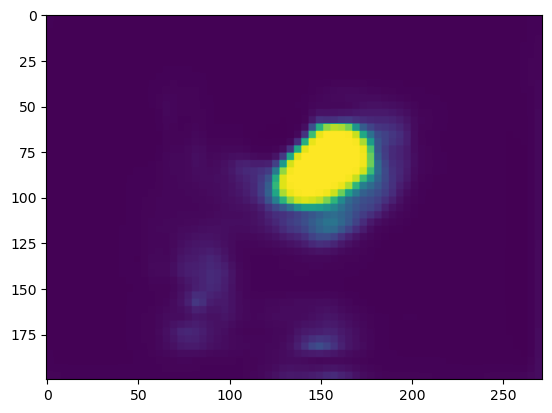

91
tensor([0., 0., 0.])


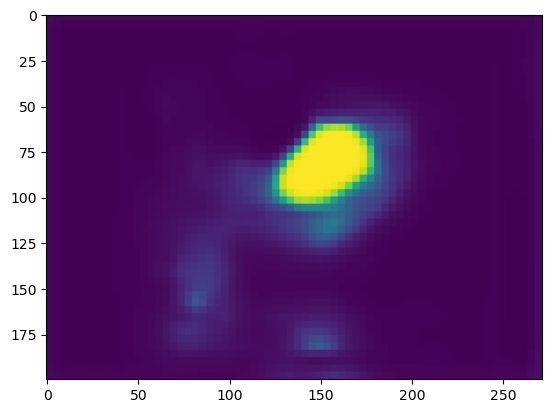

92
tensor([0., 0., 0.])


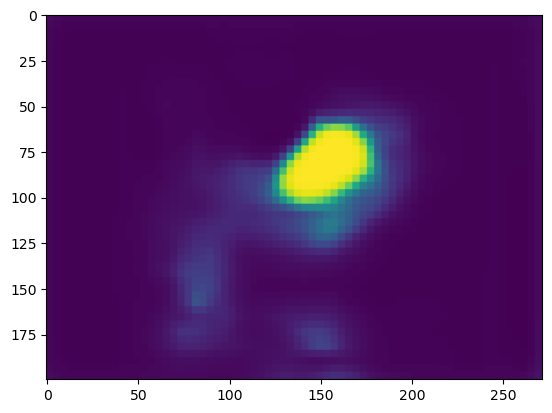

93
tensor([0., 0., 0.])


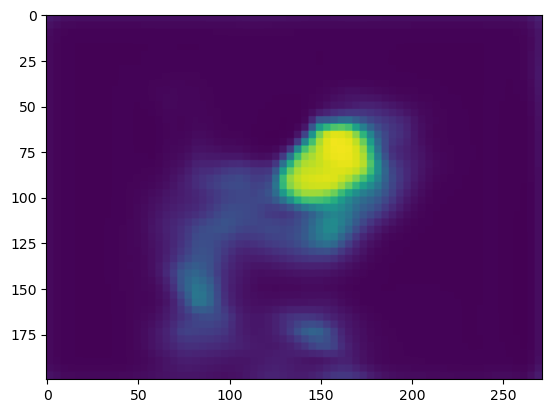

94
tensor([0., 0., 0.])


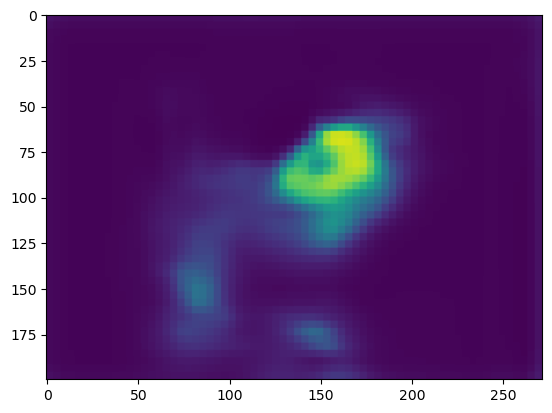

95
tensor([0.0430, 0.0364, 0.0357])


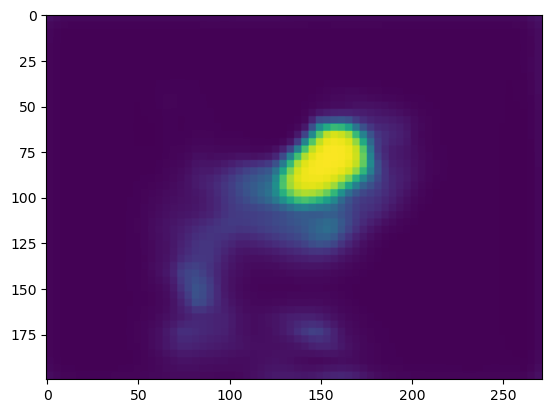

96
tensor([0.0412, 0.0344, 0.0337])


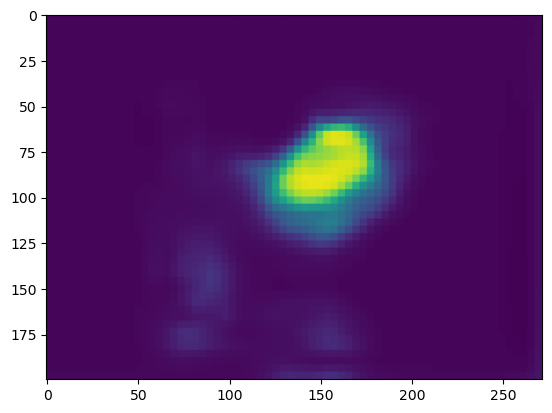

97
tensor([0., 0., 0.])


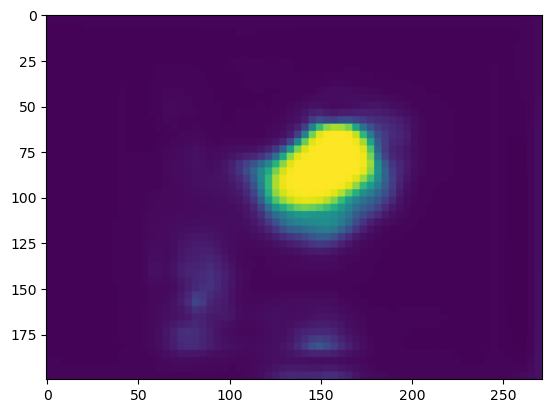

98
tensor([0.0253, 0.0221, 0.0221])


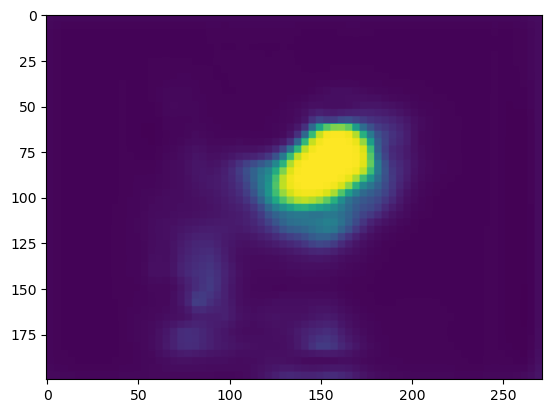

99
tensor([0.0388, 0.0344, 0.0366])


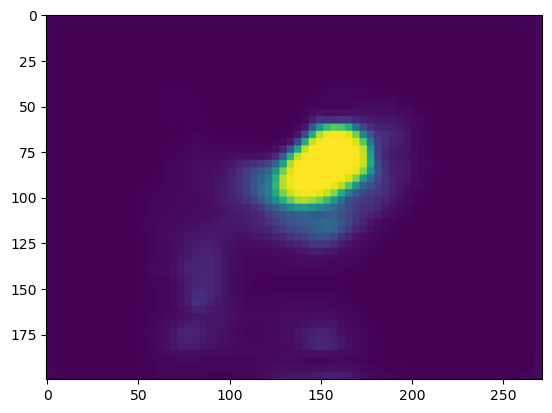

100
tensor([0.0625, 0.0564, 0.0641])


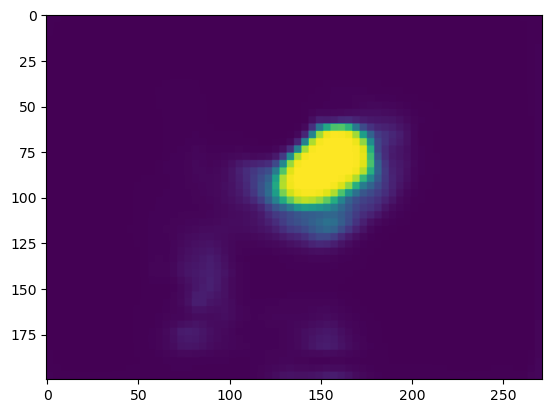

101
tensor([0., 0., 0.])


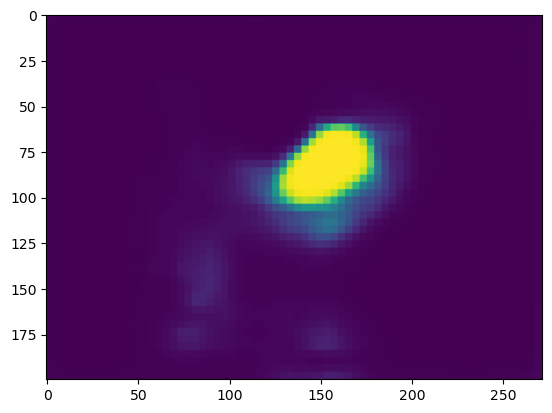

102
tensor([0., 0., 0.])


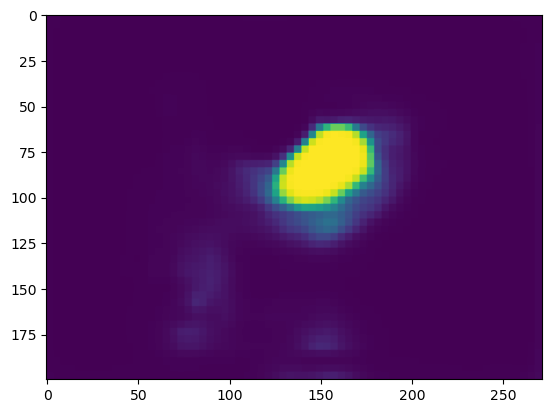

103
tensor([0.2240, 0.2145, 0.2782])


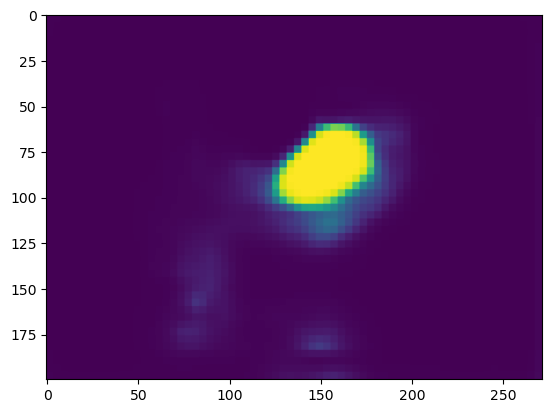

104
tensor([0.2534, 0.2447, 0.3194])


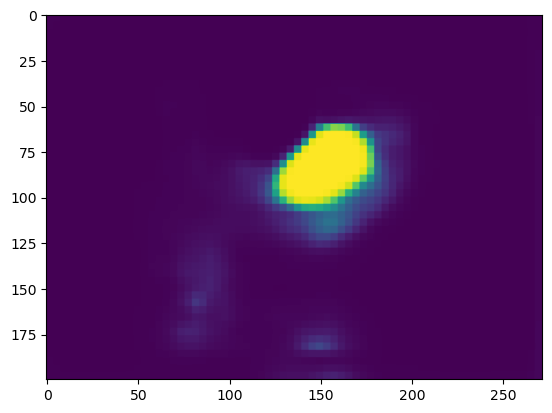

105
tensor([0., 0., 0.])


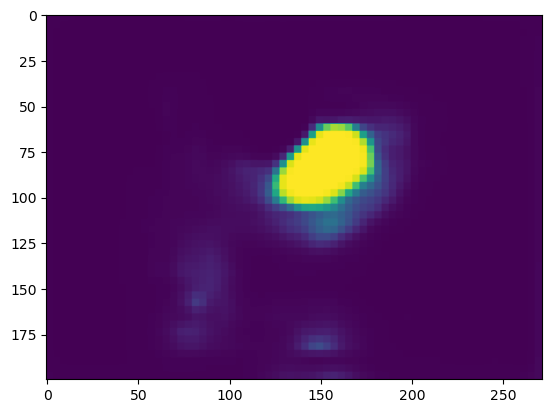

106
tensor([0., 0., 0.])


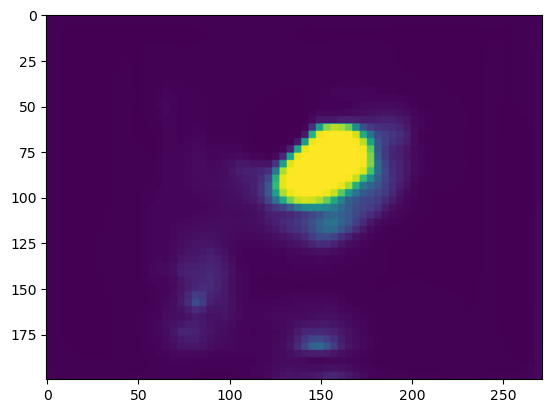

107
tensor([0., 0., 0.])


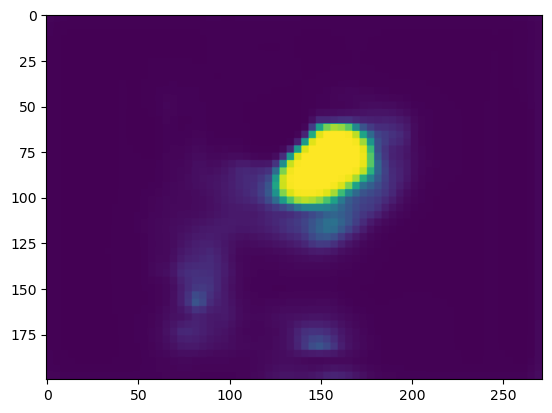

108
tensor([0., 0., 0.])


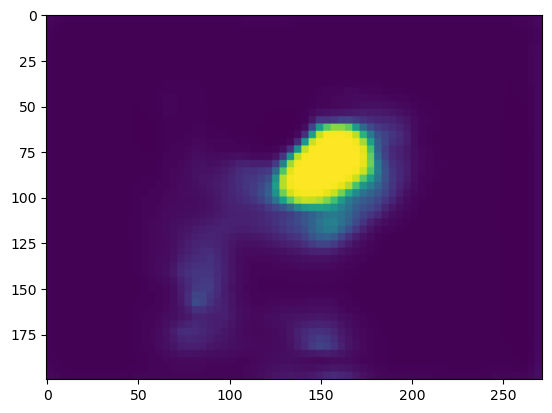

109
tensor([0., 0., 0.])


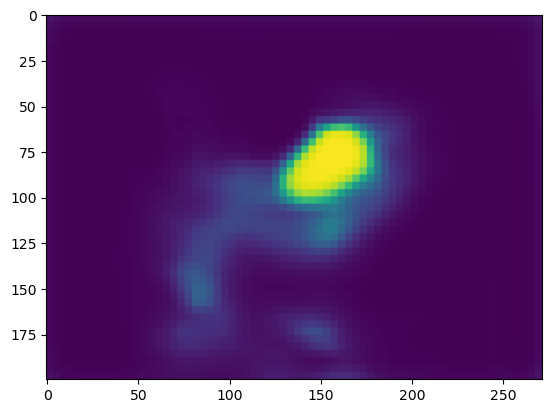

110
tensor([0., 0., 0.])


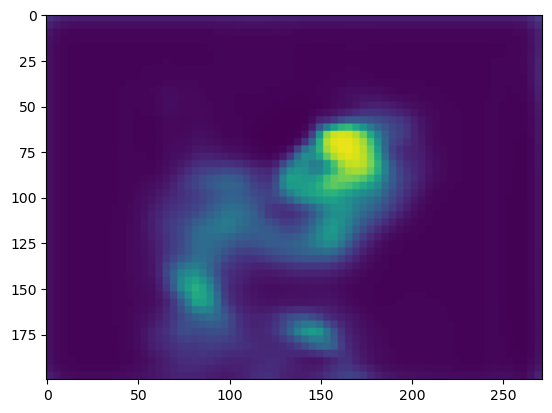

111
tensor([0.0431, 0.0000, 0.0000])


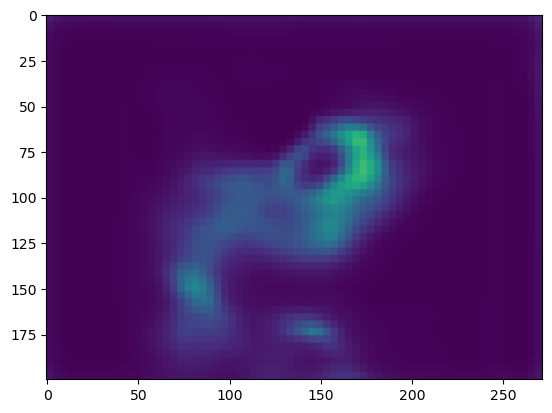

112
tensor([0.0417, 0.0349, 0.0342])


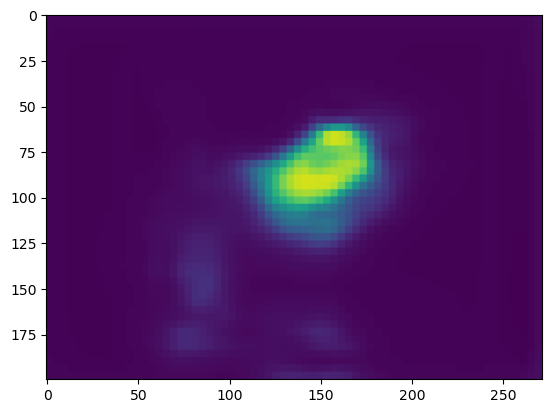

113
tensor([0., 0., 0.])


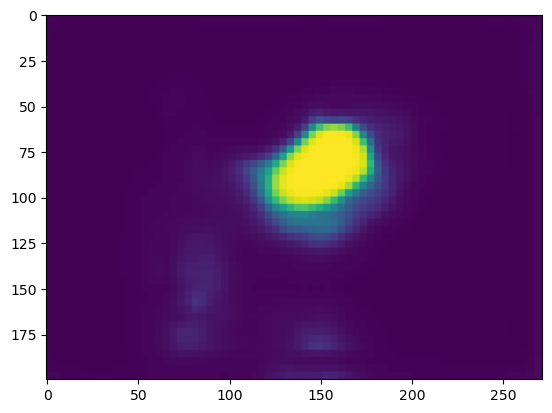

114
tensor([0.0261, 0.0229, 0.0230])


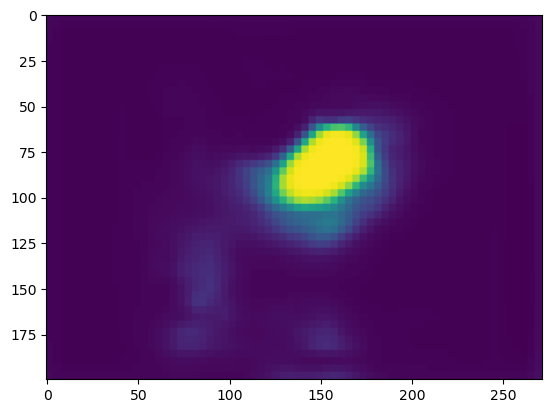

115
tensor([0.0388, 0.0345, 0.0367])


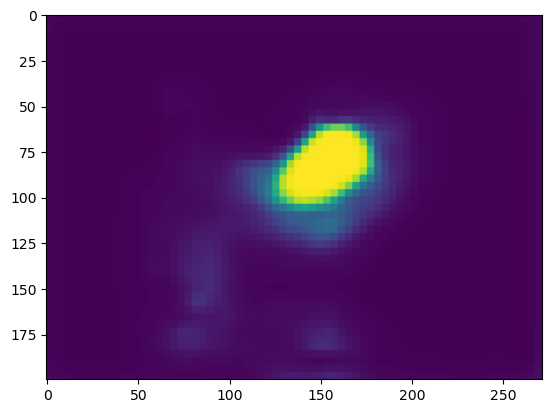

116
tensor([0., 0., 0.])


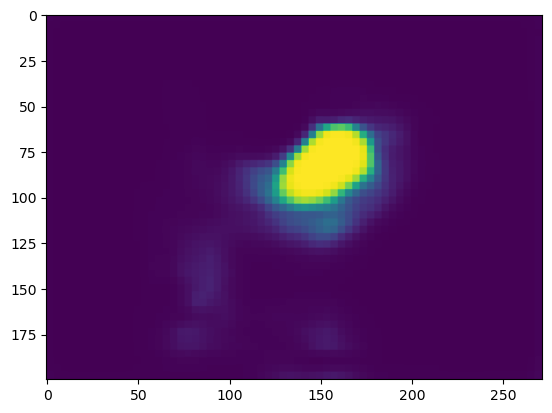

117
tensor([0., 0., 0.])


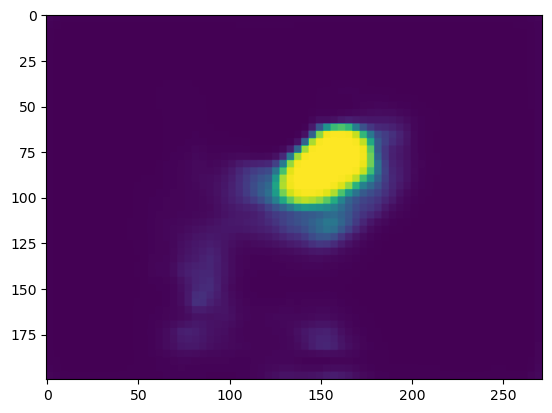

118
tensor([0., 0., 0.])


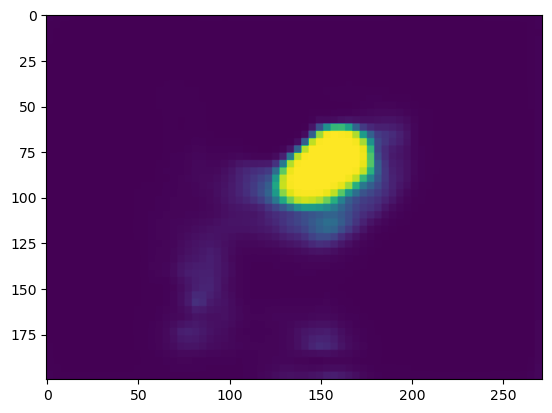

119
tensor([0., 0., 0.])


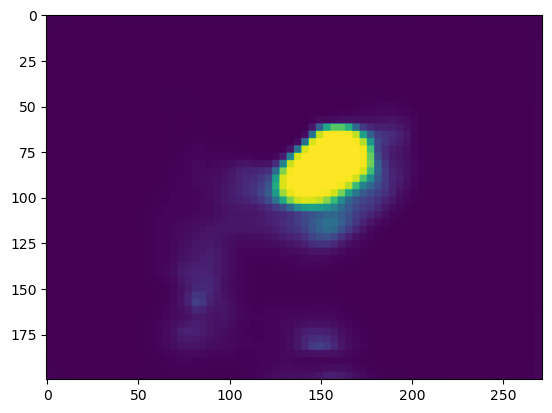

120
tensor([0., 0., 0.])


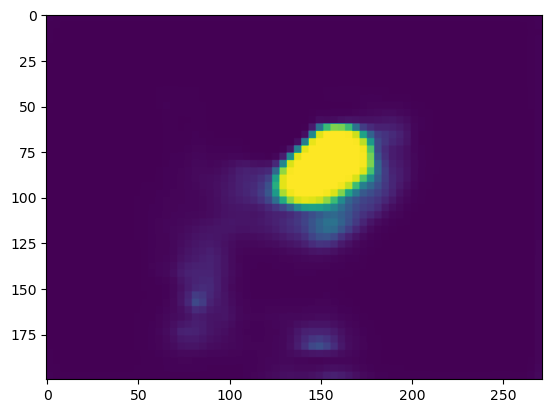

121
tensor([0., 0., 0.])


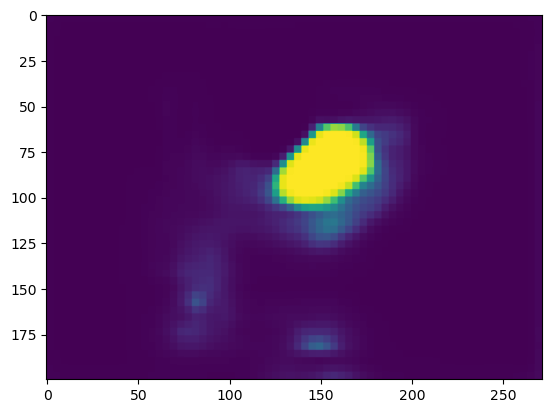

122
tensor([0., 0., 0.])


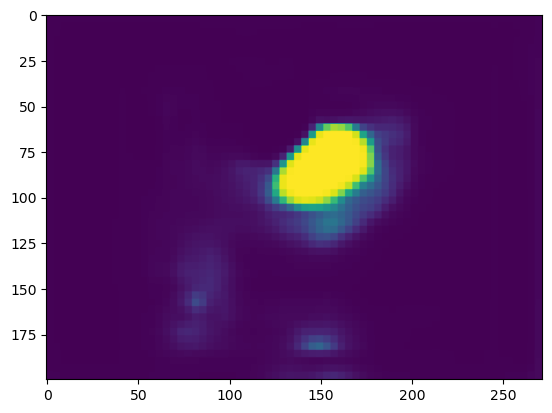

123
tensor([0., 0., 0.])


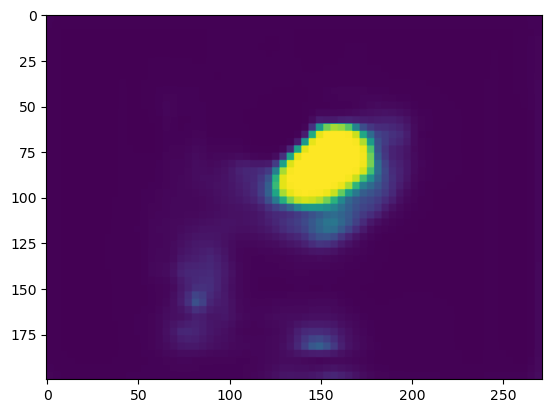

124
tensor([0., 0., 0.])


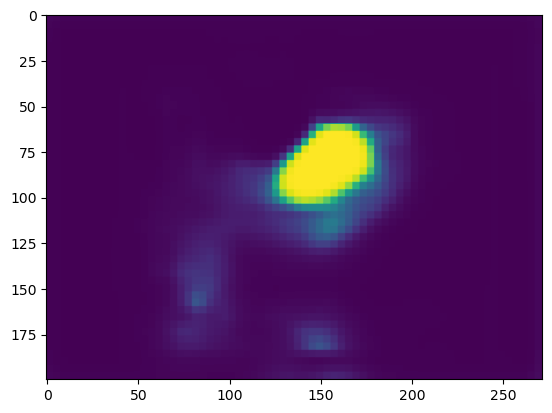

125
tensor([0., 0., 0.])


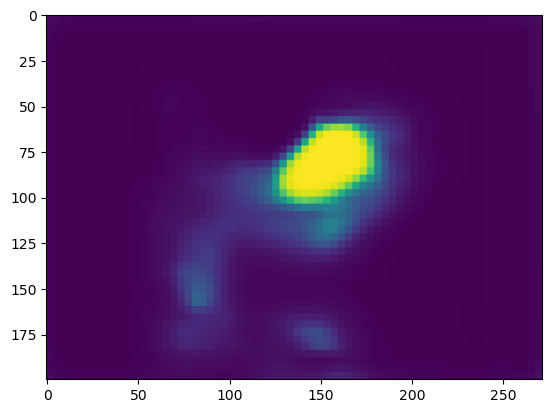

126
tensor([0., 0., 0.])


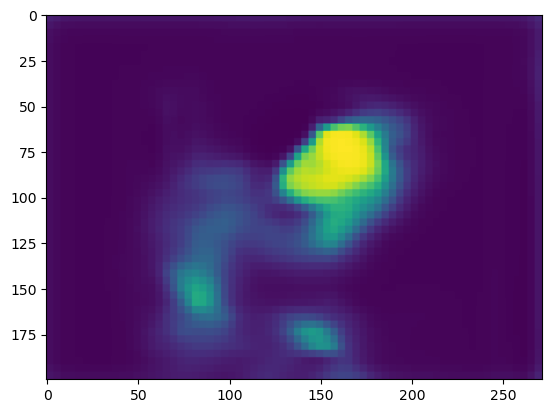

127
tensor([0., 0., 0.])


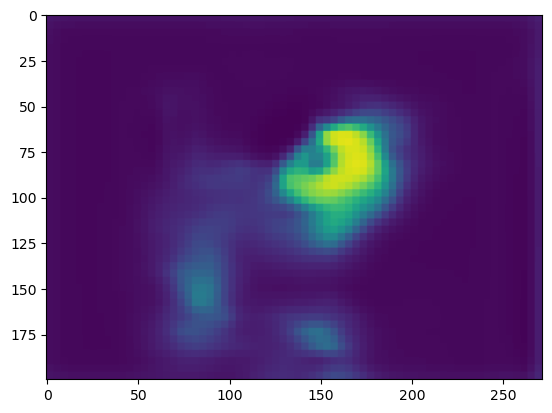

128
tensor([0.0421, 0.0352, 0.0346])


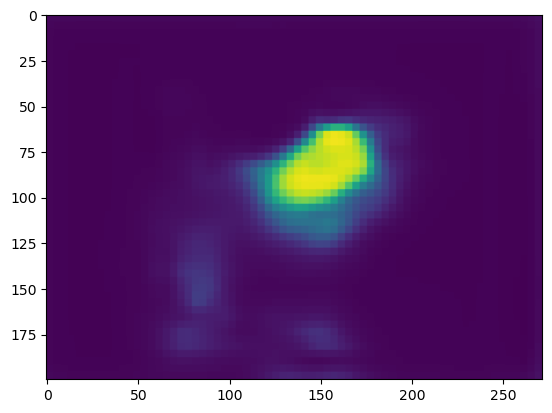

129
tensor([0., 0., 0.])


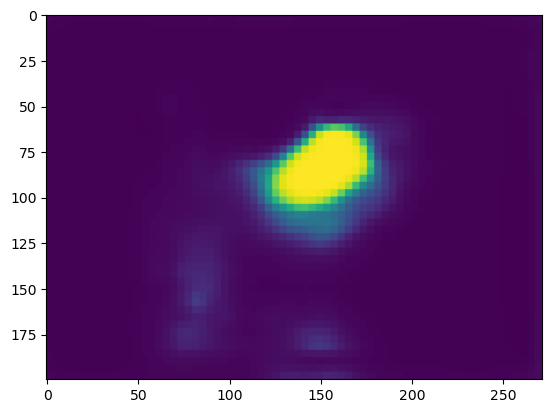

130
tensor([0.0266, 0.0233, 0.0234])


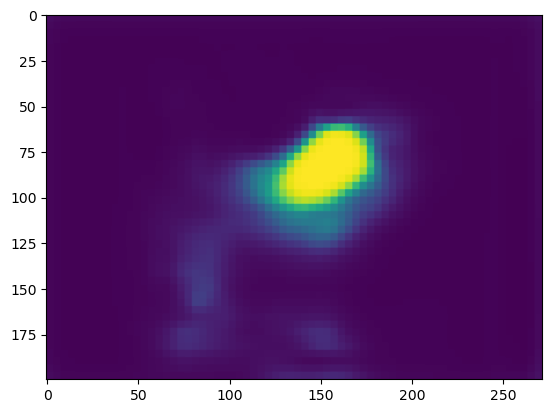

131
tensor([0., 0., 0.])


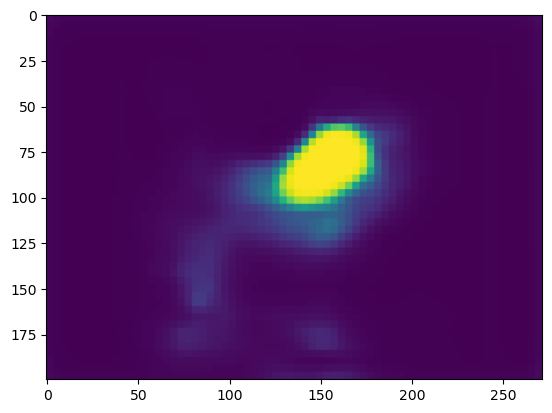

132
tensor([0., 0., 0.])


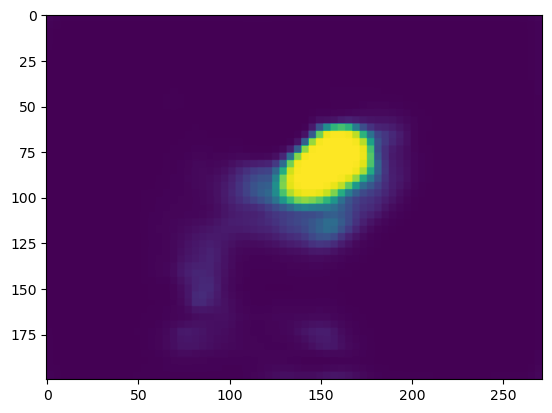

133
tensor([0., 0., 0.])


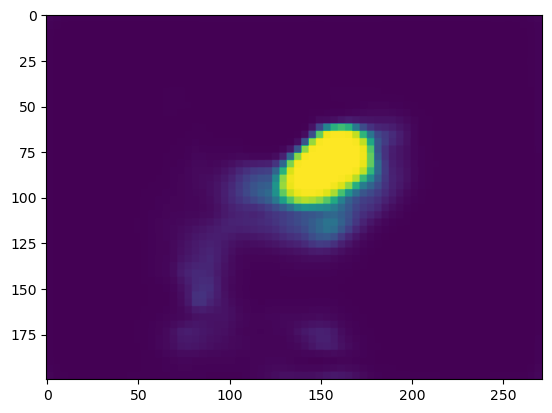

134
tensor([0., 0., 0.])


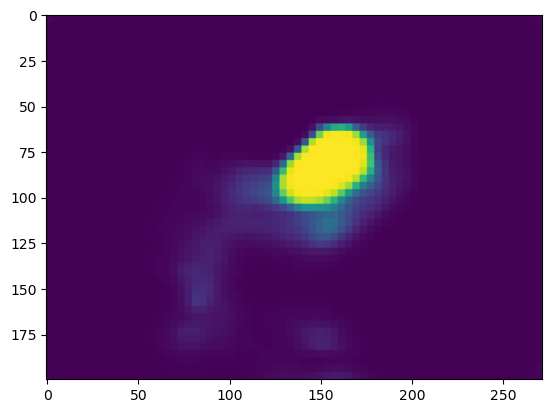

135
tensor([0., 0., 0.])


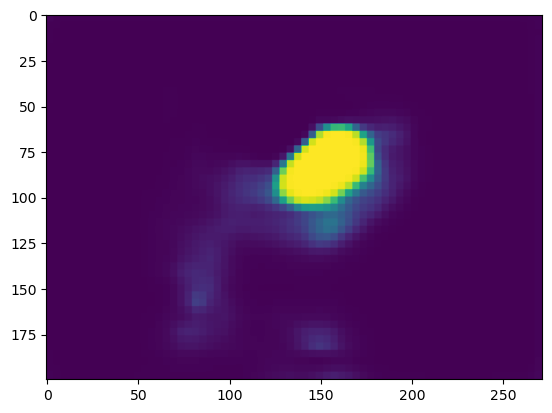

136
tensor([0., 0., 0.])


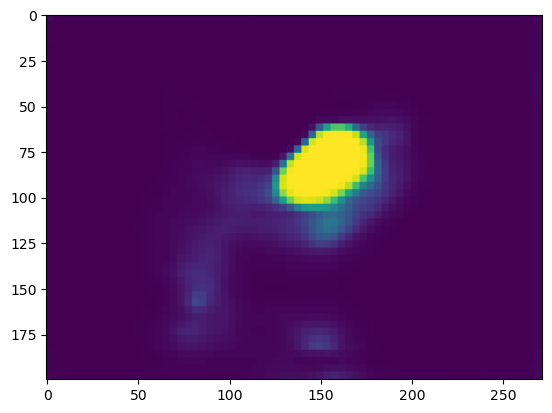

137
tensor([0., 0., 0.])


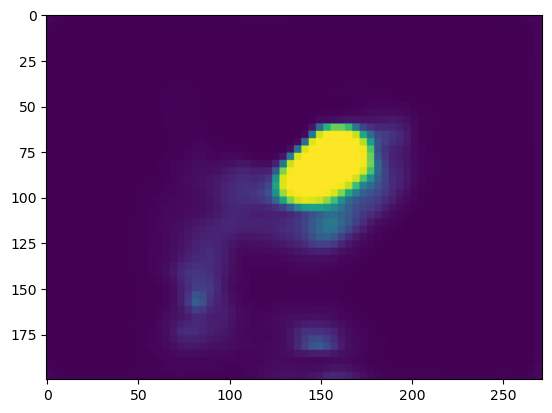

138
tensor([0., 0., 0.])


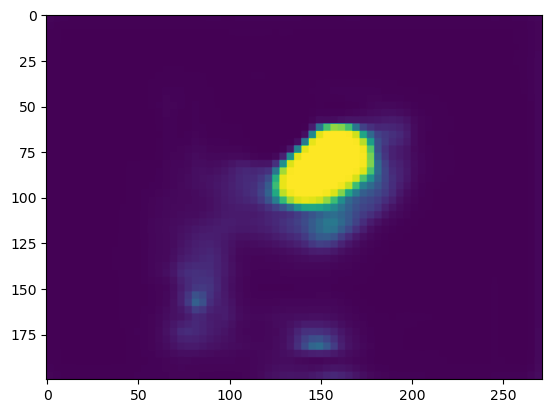

139
tensor([0., 0., 0.])


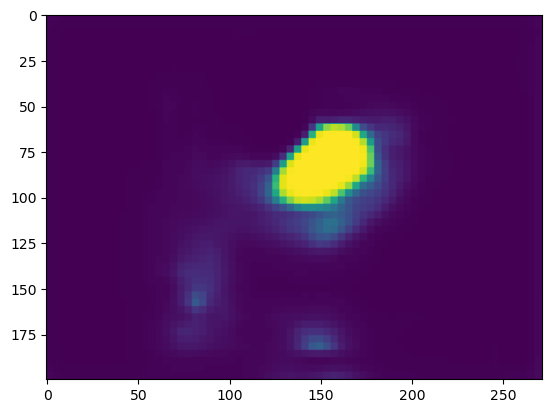

140
tensor([0., 0., 0.])


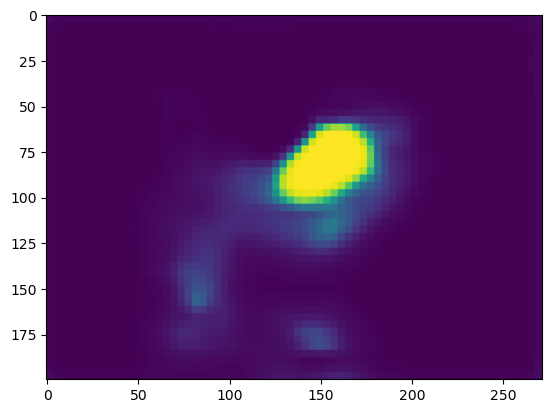

141
tensor([0., 0., 0.])


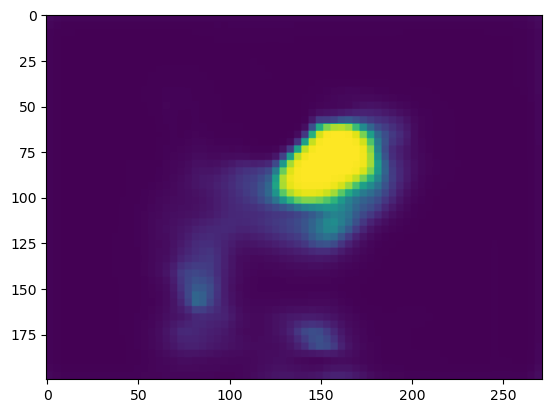

142
tensor([0., 0., 0.])


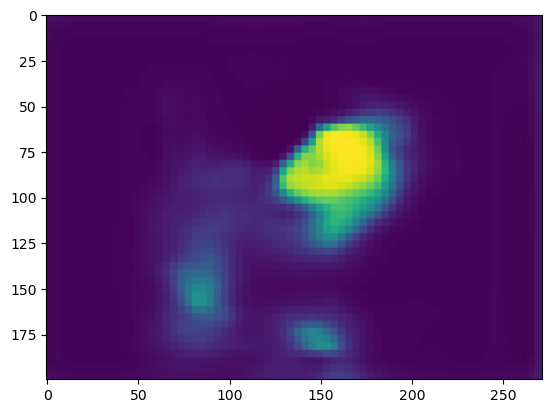

143
tensor([0., 0., 0.])


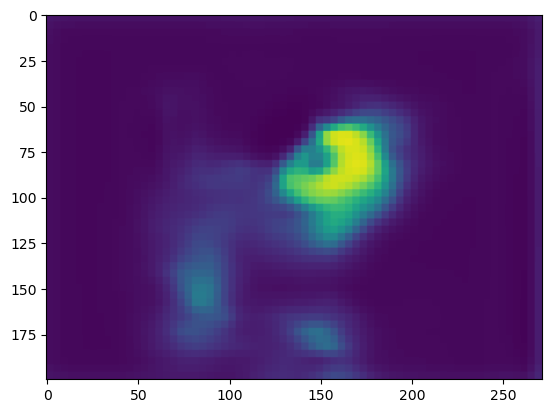

144
tensor([0., 0., 0.])


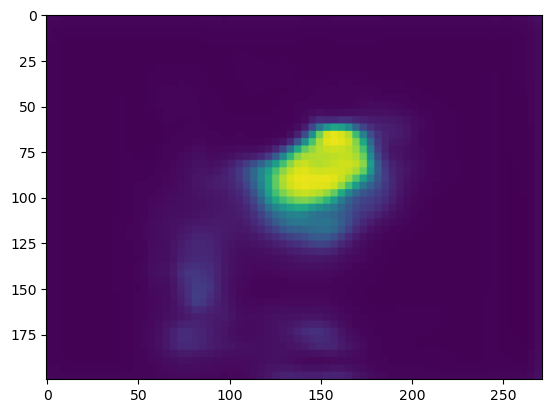

145
tensor([0., 0., 0.])


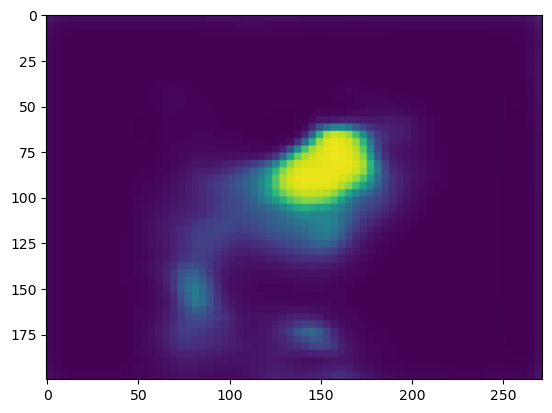

146
tensor([0., 0., 0.])


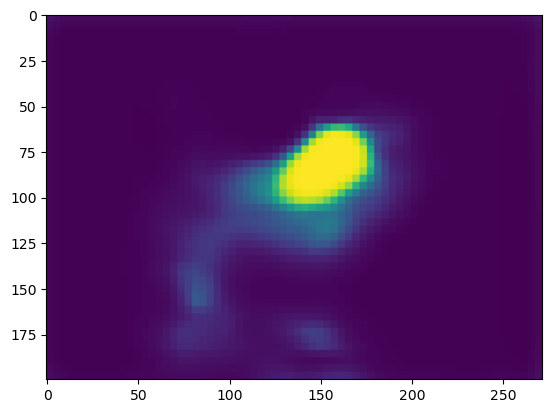

147
tensor([0., 0., 0.])


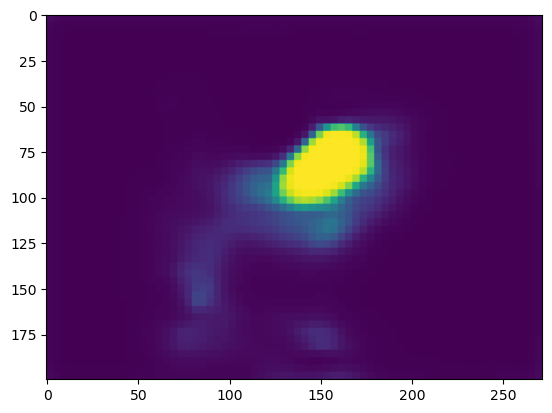

148
tensor([0., 0., 0.])


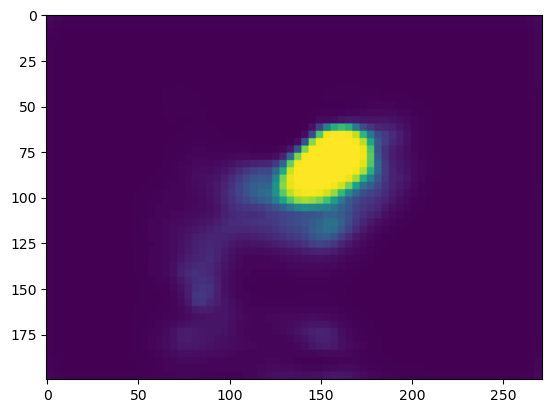

149
tensor([0., 0., 0.])


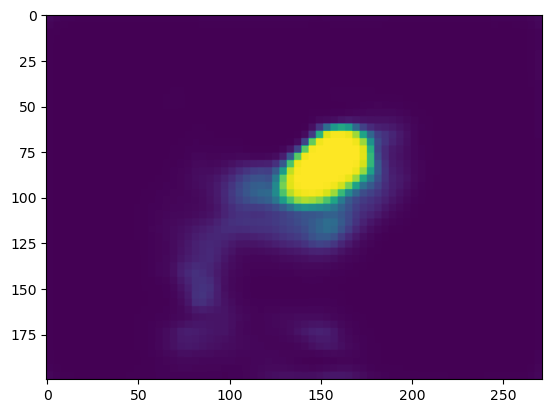

150
tensor([0., 0., 0.])


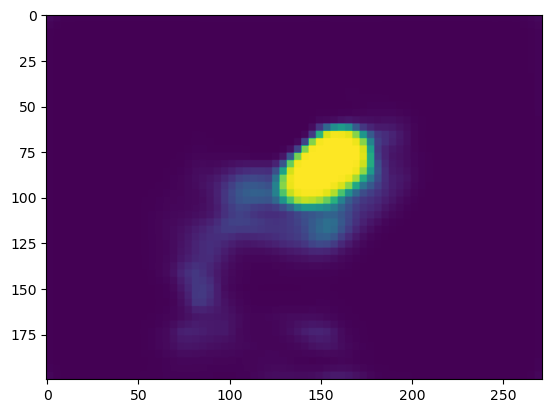

151
tensor([0., 0., 0.])


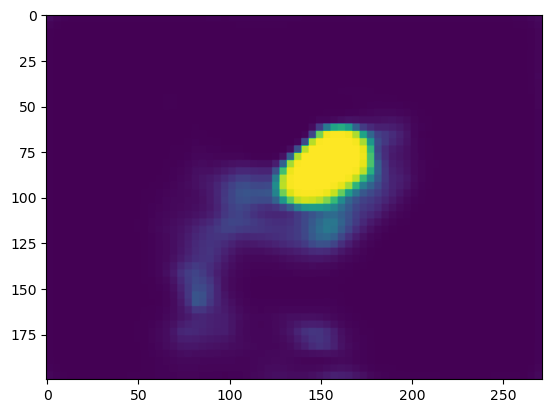

152
tensor([0., 0., 0.])


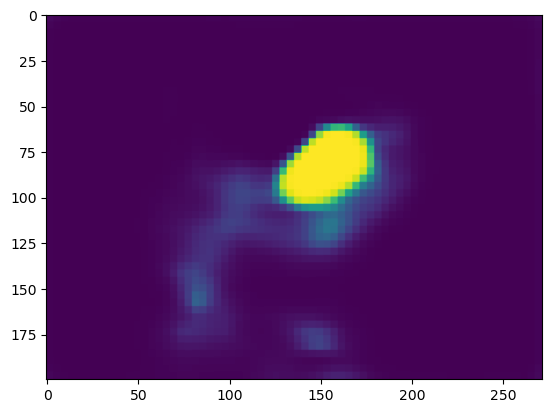

153
tensor([0., 0., 0.])


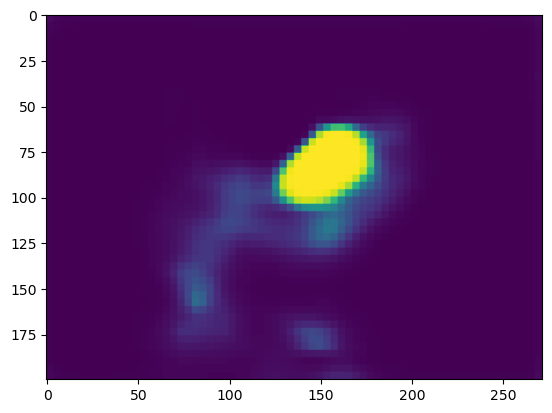

154
tensor([0., 0., 0.])


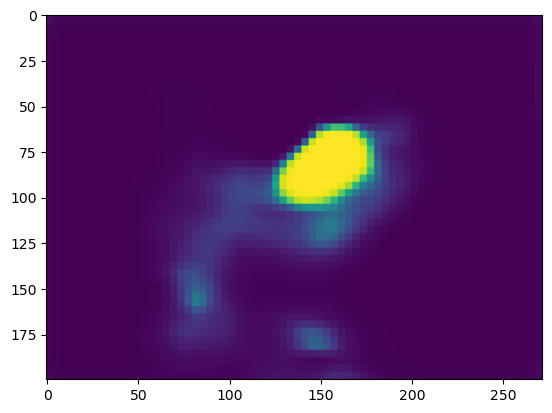

155
tensor([0., 0., 0.])


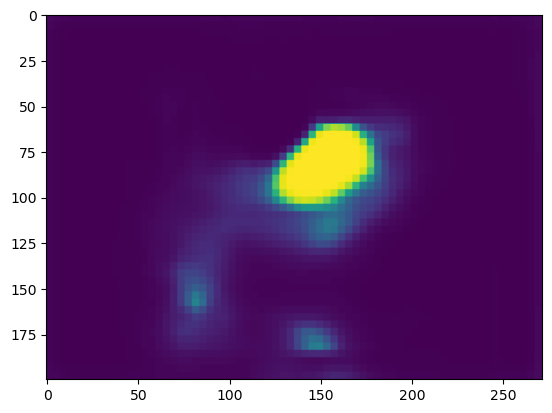

156
tensor([0., 0., 0.])


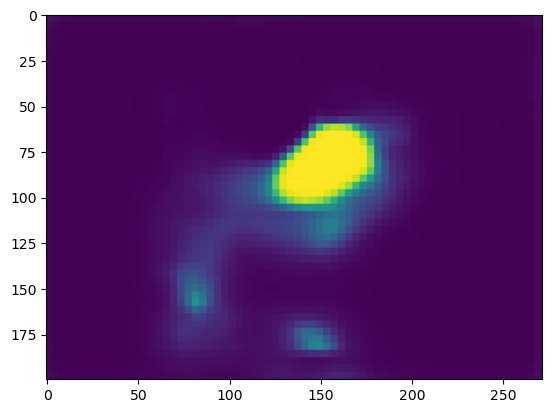

157
tensor([0., 0., 0.])


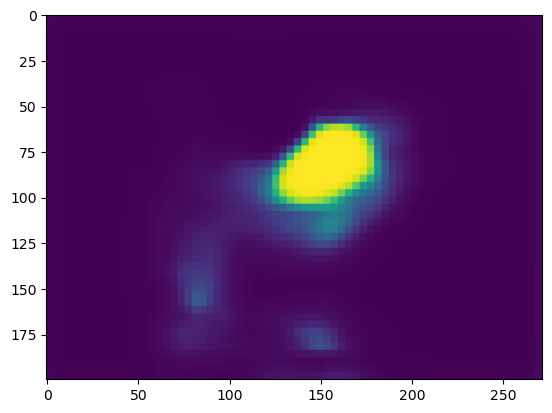

158
tensor([0., 0., 0.])


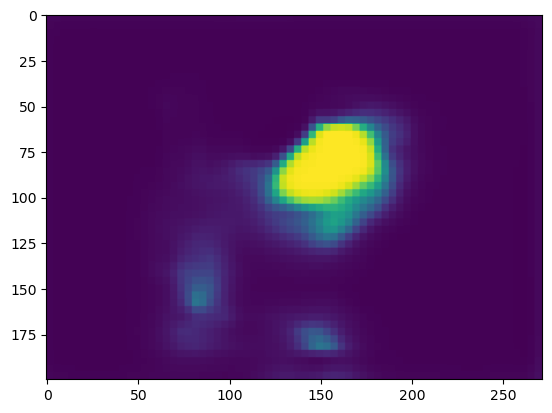

159
tensor([0., 0., 0.])


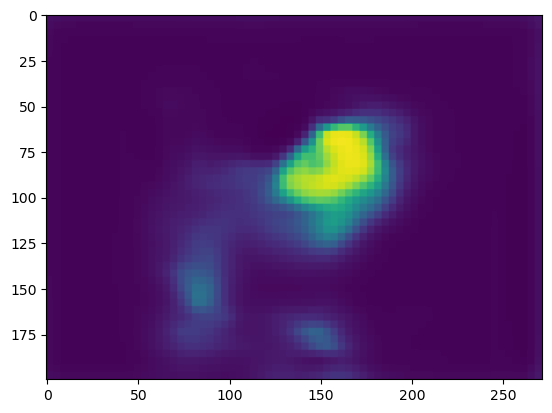

160
tensor([0., 0., 0.])


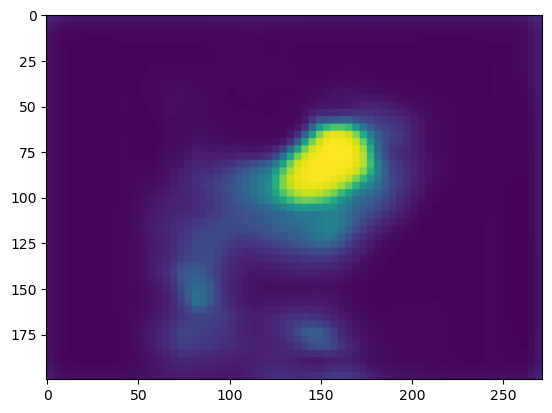

161
tensor([0., 0., 0.])


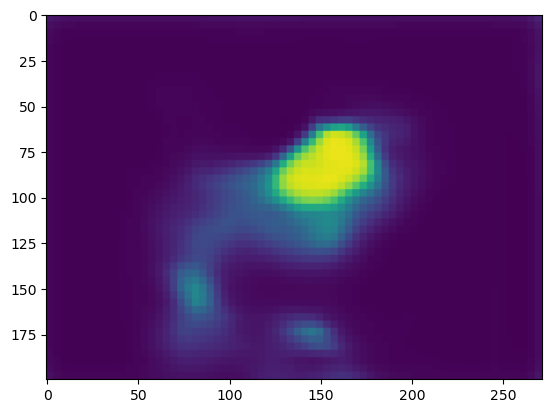

162
tensor([0., 0., 0.])


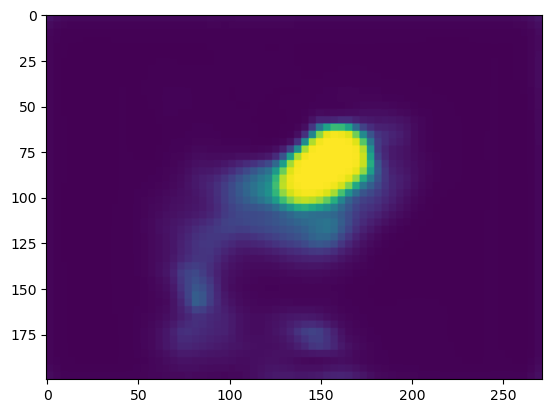

163
tensor([0., 0., 0.])


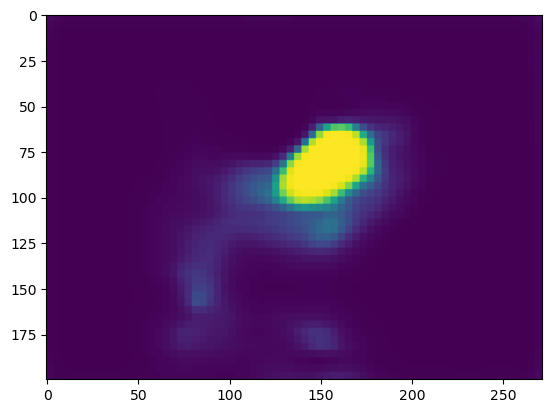

164
tensor([0., 0., 0.])


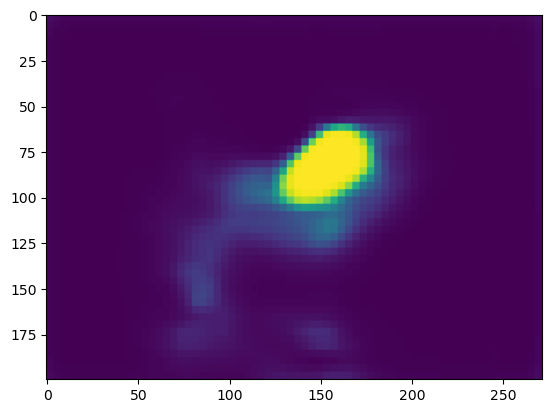

165
tensor([0., 0., 0.])


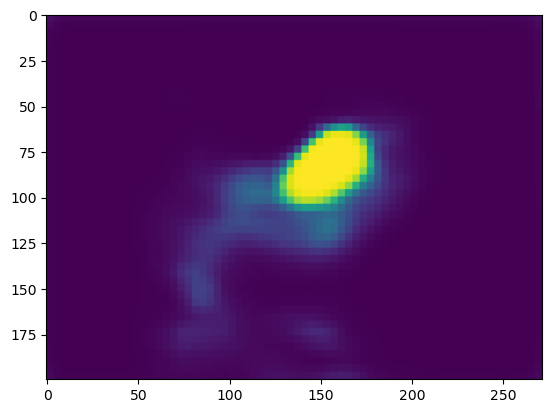

166
tensor([0., 0., 0.])


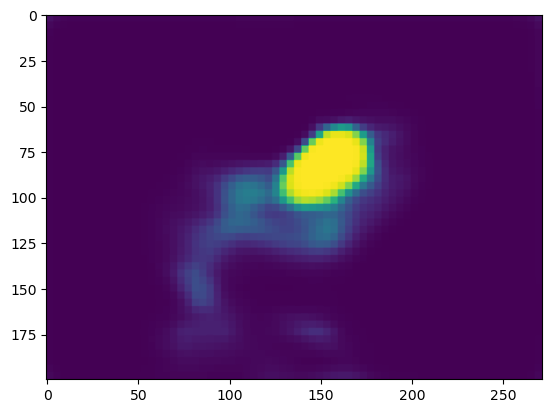

167
tensor([0., 0., 0.])


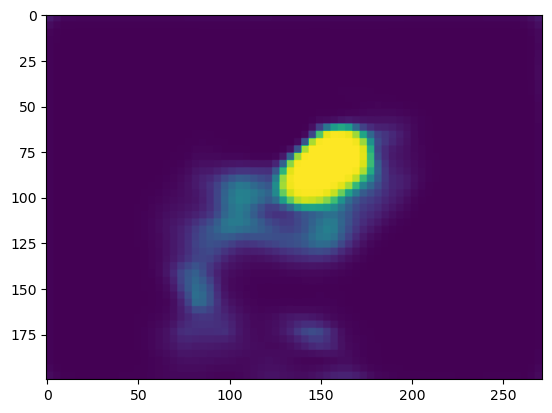

168
tensor([0., 0., 0.])


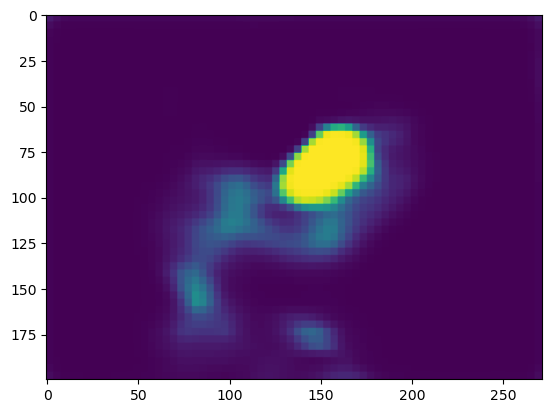

169
tensor([0., 0., 0.])


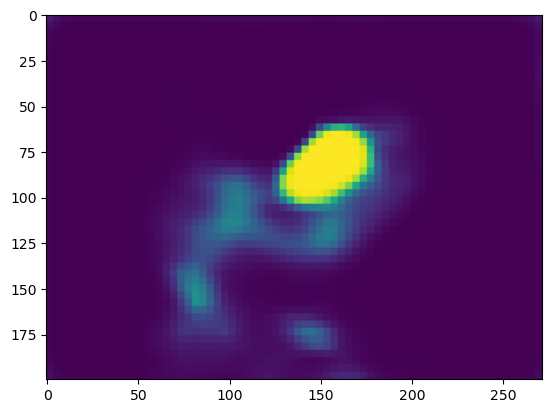

170
tensor([0., 0., 0.])


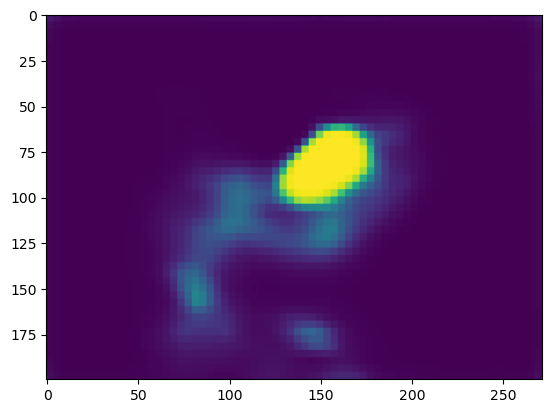

171
tensor([0., 0., 0.])


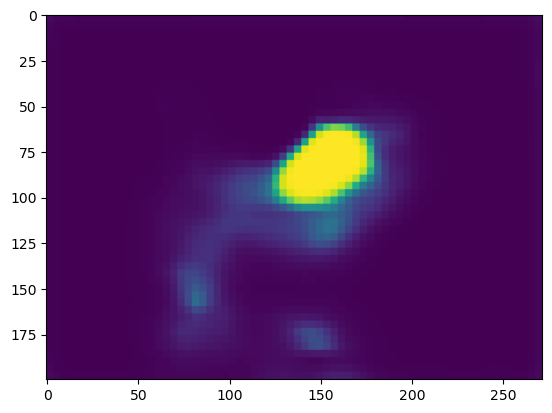

172
tensor([0., 0., 0.])


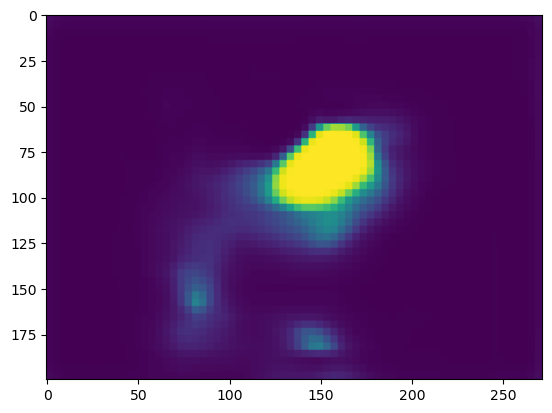

173
tensor([0., 0., 0.])


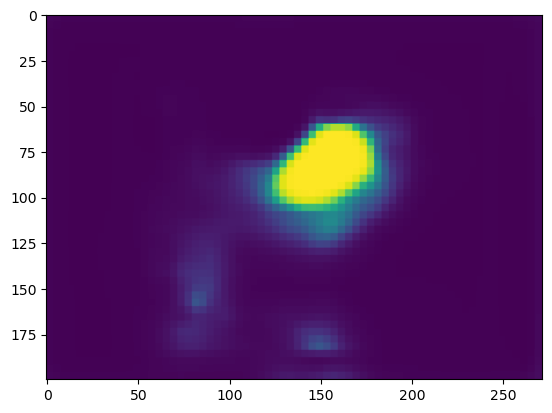

174
tensor([0., 0., 0.])


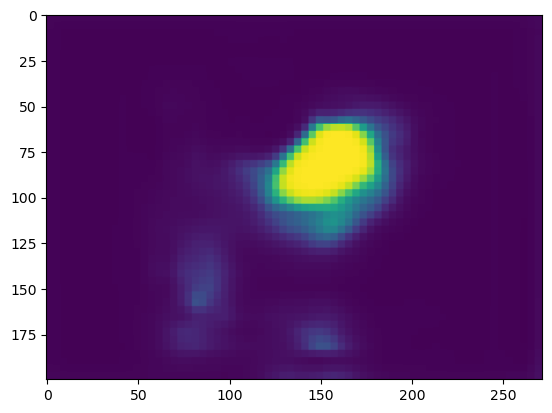

175
tensor([0., 0., 0.])


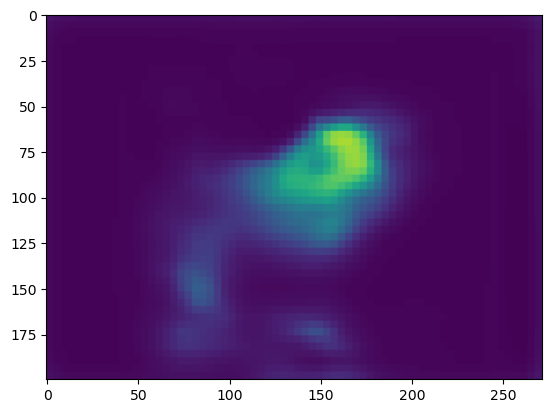

176
tensor([0., 0., 0.])


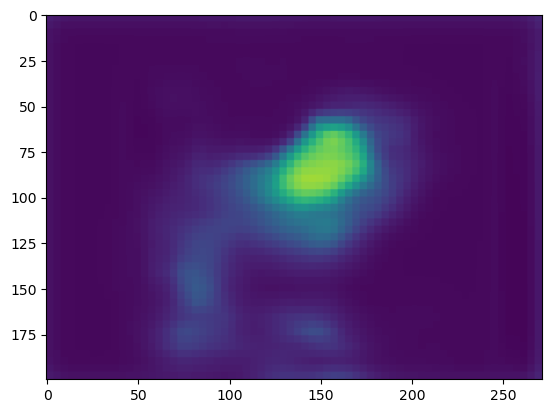

177
tensor([0., 0., 0.])


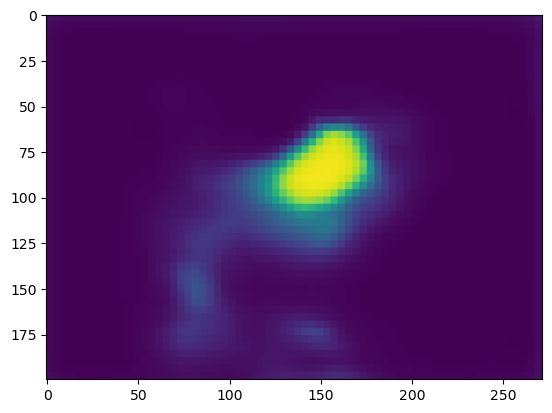

178
tensor([0., 0., 0.])


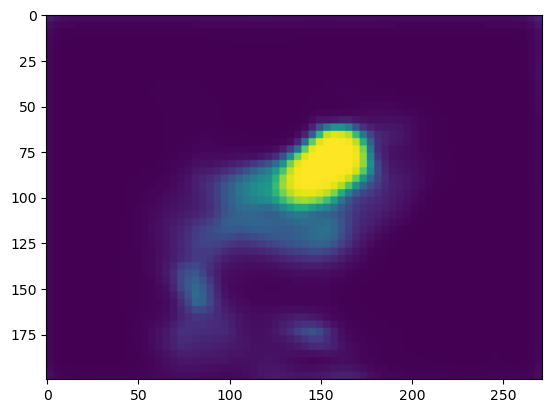

179
tensor([0., 0., 0.])


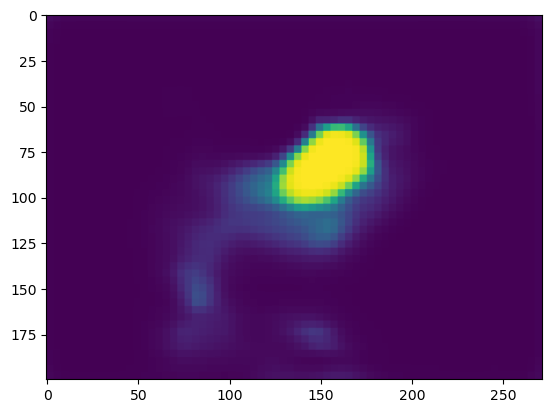

180
tensor([0., 0., 0.])


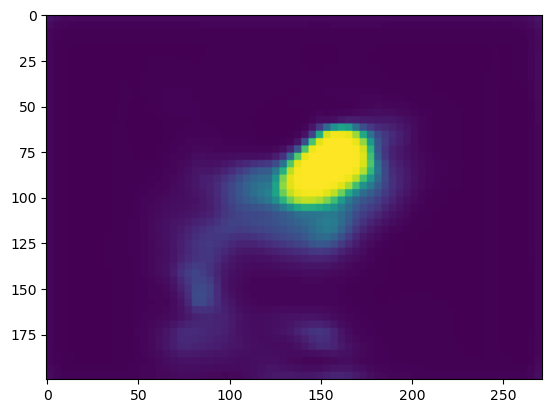

181
tensor([0., 0., 0.])


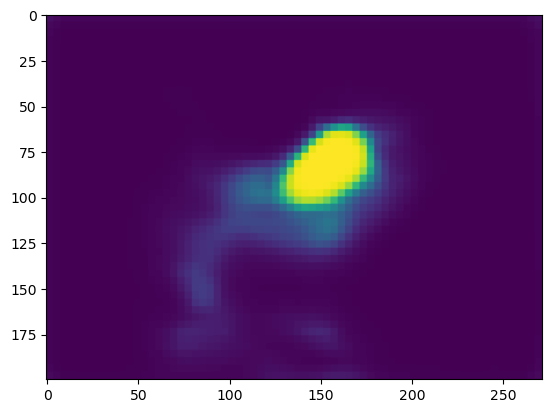

182
tensor([0., 0., 0.])


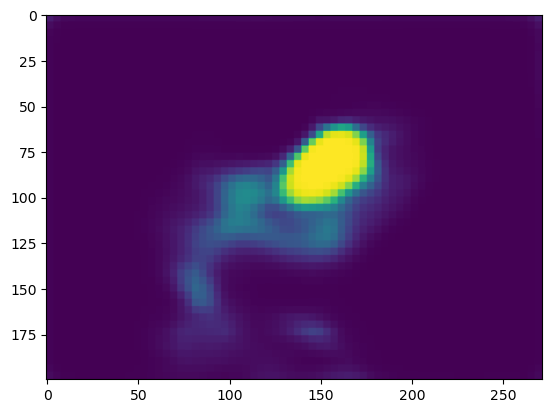

183
tensor([0., 0., 0.])


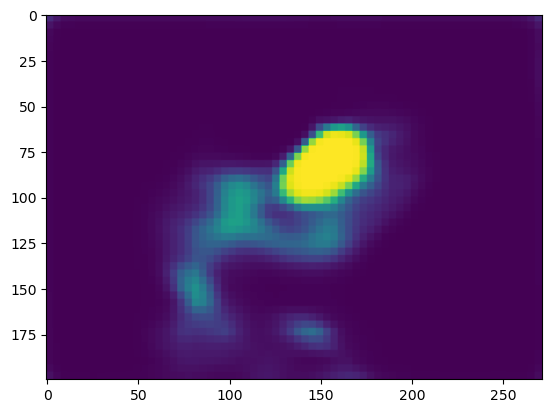

184
tensor([0., 0., 0.])


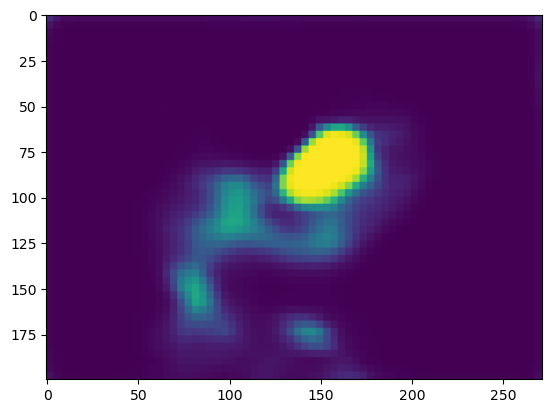

185
tensor([0., 0., 0.])


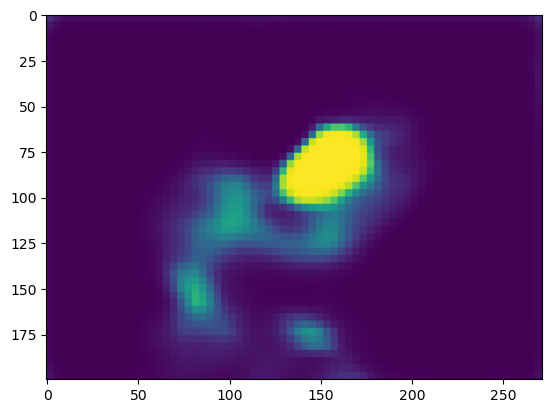

186
tensor([0., 0., 0.])


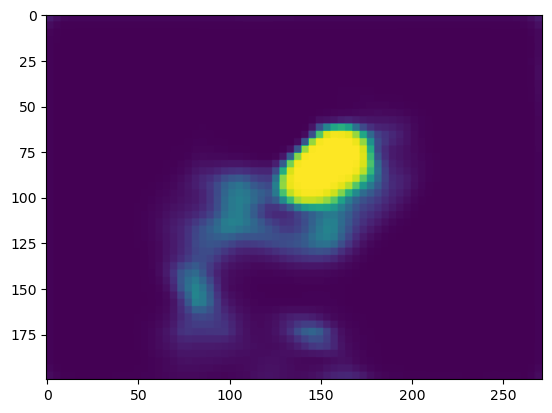

187
tensor([0., 0., 0.])


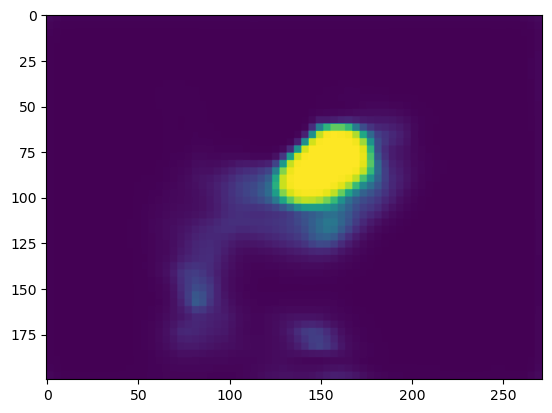

188
tensor([0., 0., 0.])


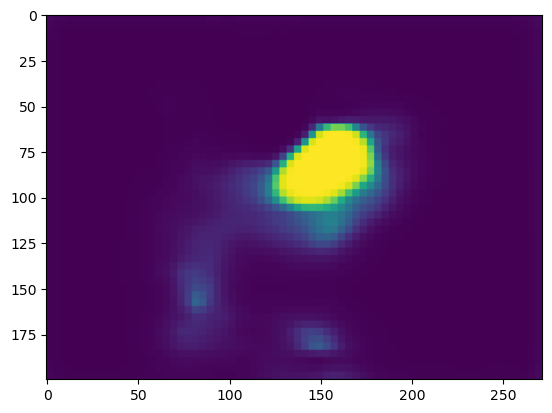

189
tensor([0., 0., 0.])


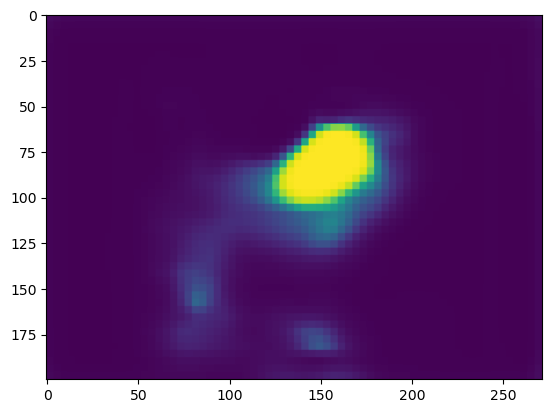

190
tensor([0., 0., 0.])


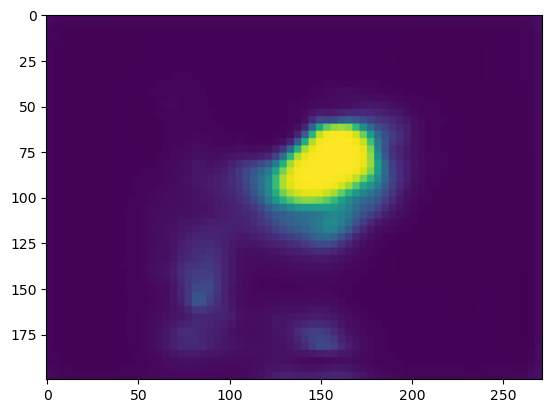

191
tensor([0., 0., 0.])


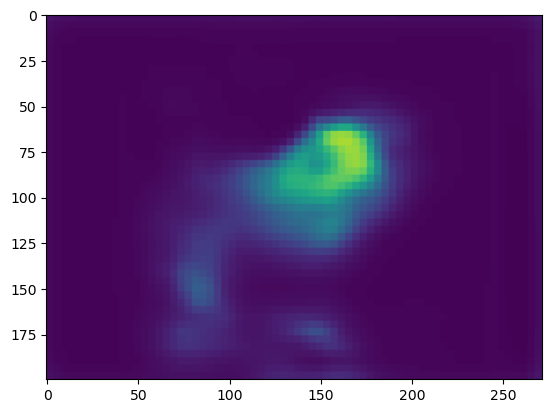

192
tensor([0., 0., 0.])


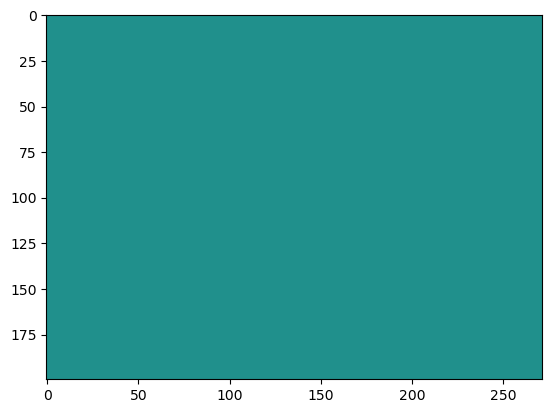

193
tensor([0., 0., 0.])


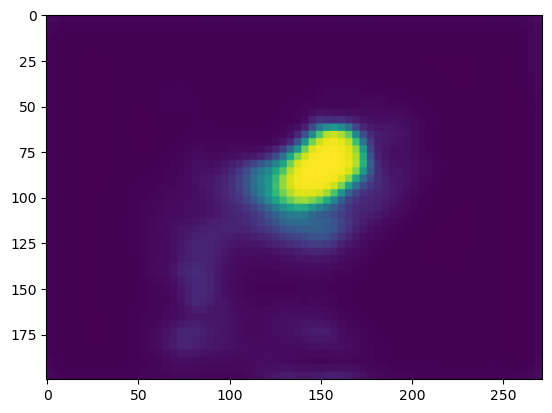

194
tensor([0., 0., 0.])


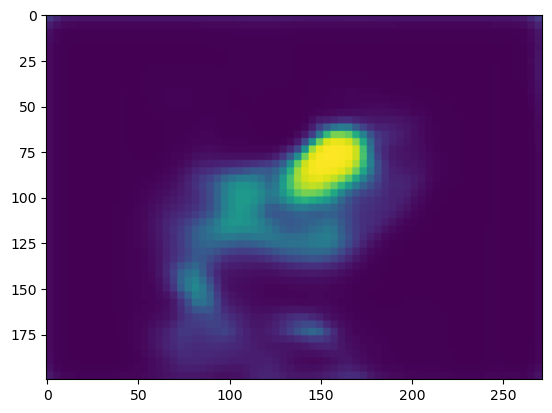

195
tensor([0., 0., 0.])


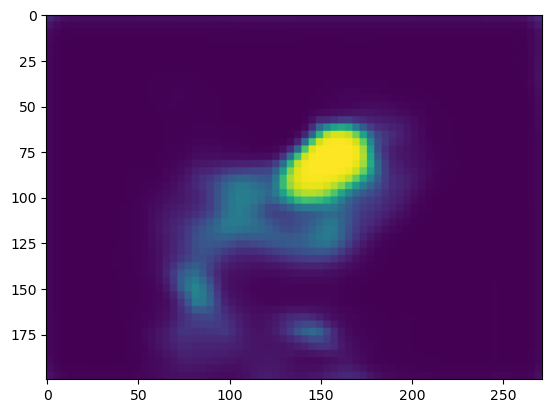

196
tensor([0., 0., 0.])


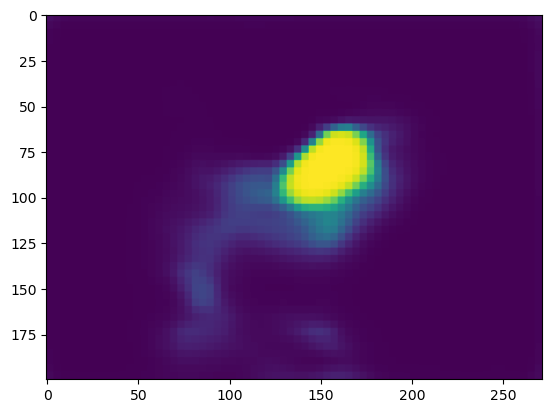

197
tensor([0.0568, 0.0514, 0.0574])


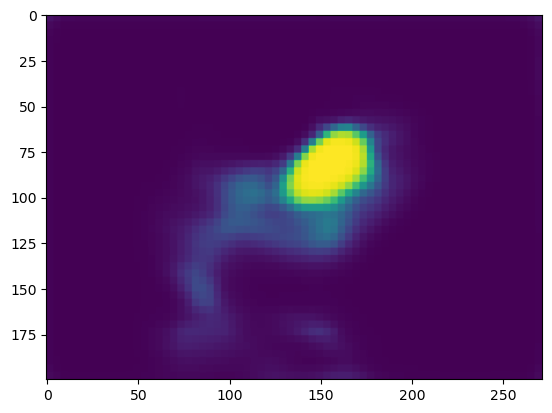

198
tensor([0.0774, 0.0714, 0.0832])


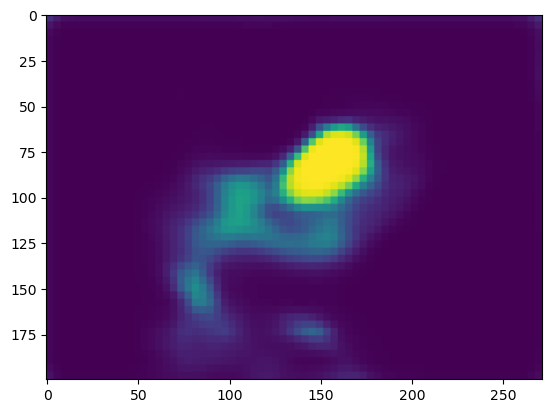

199
tensor([0.0838, 0.0776, 0.0915])


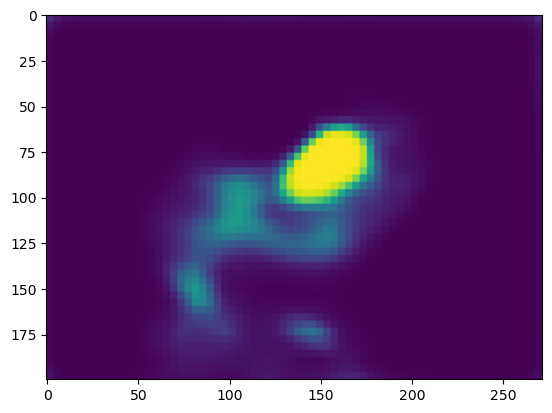

200
tensor([0., 0., 0.])


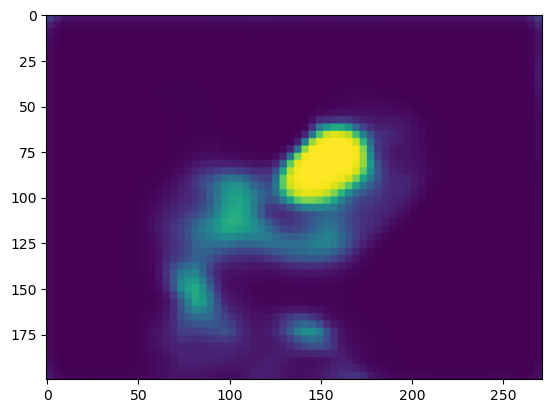

201
tensor([0., 0., 0.])


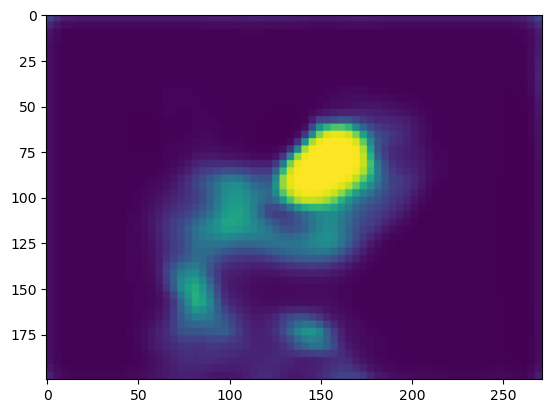

202
tensor([0., 0., 0.])


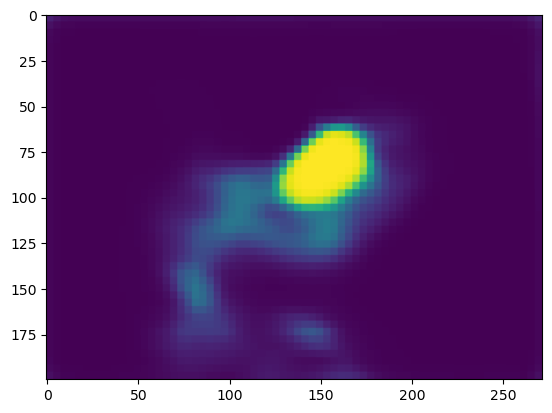

203
tensor([0., 0., 0.])


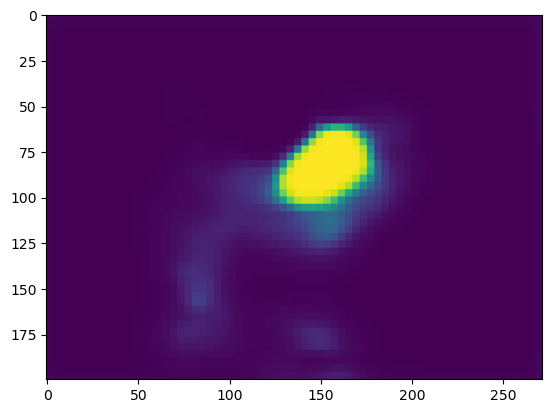

204
tensor([0., 0., 0.])


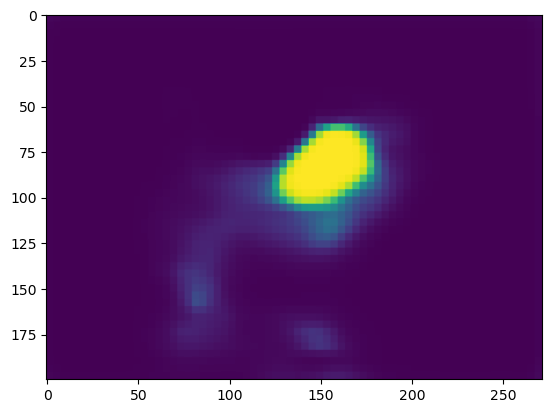

205
tensor([0., 0., 0.])


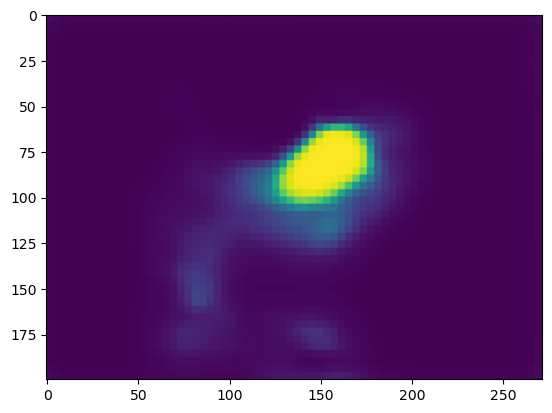

206
tensor([0., 0., 0.])


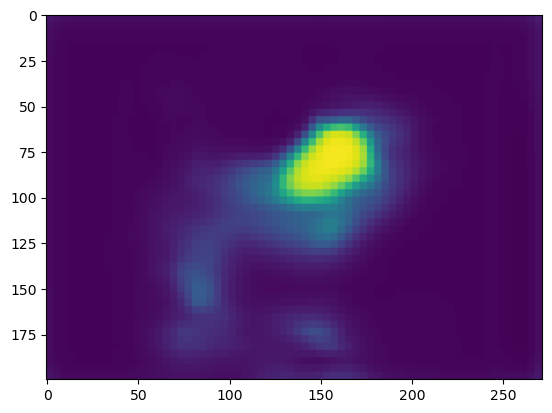

207
tensor([0., 0., 0.])


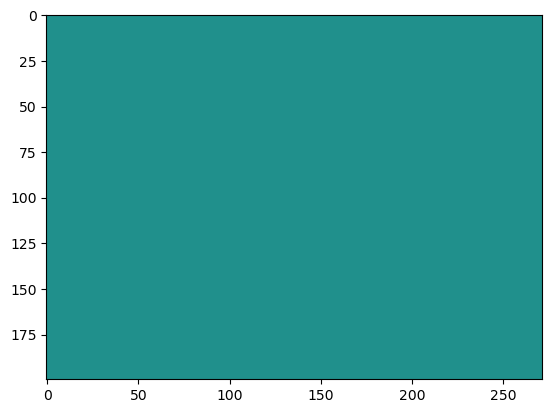

208
tensor([0., 0., 0.])


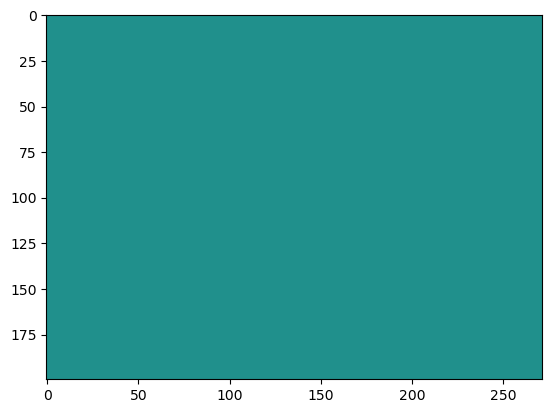

209
tensor([0., 0., 0.])


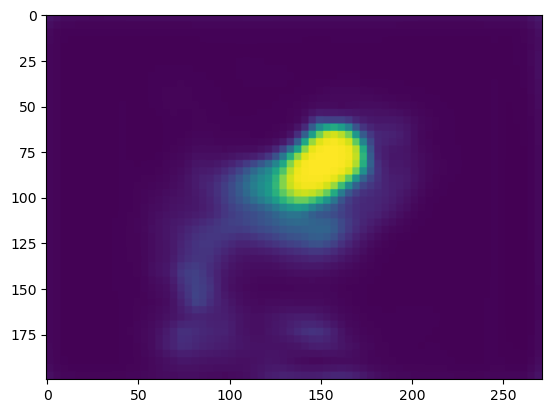

210
tensor([0., 0., 0.])


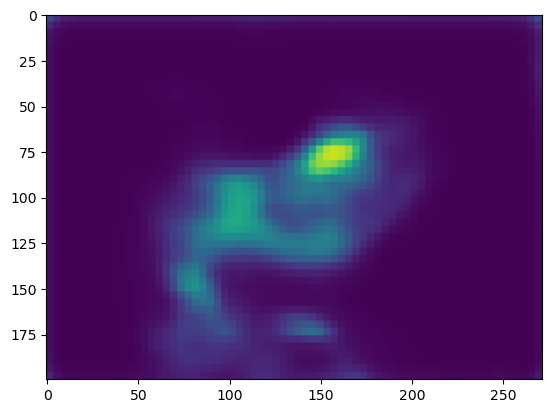

211
tensor([0., 0., 0.])


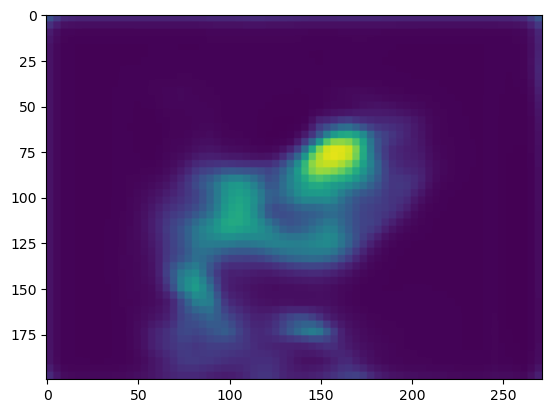

212
tensor([0., 0., 0.])


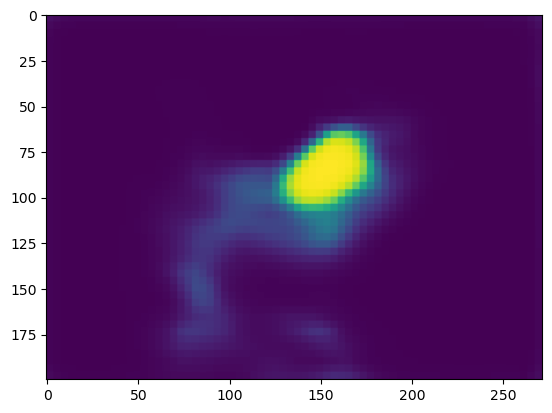

213
tensor([0., 0., 0.])


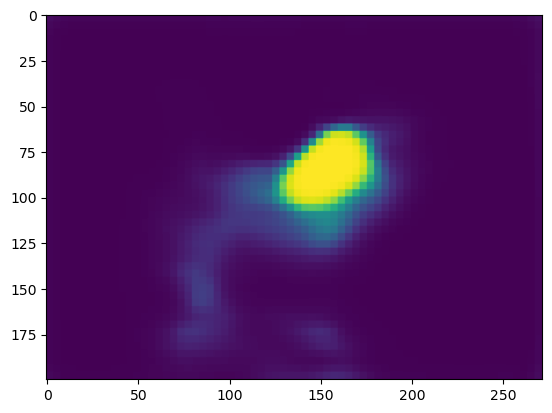

214
tensor([0., 0., 0.])


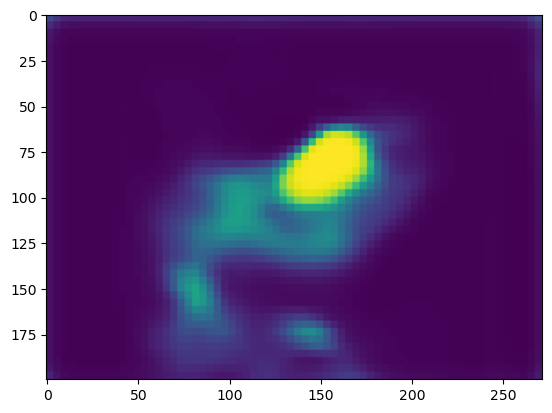

215
tensor([0., 0., 0.])


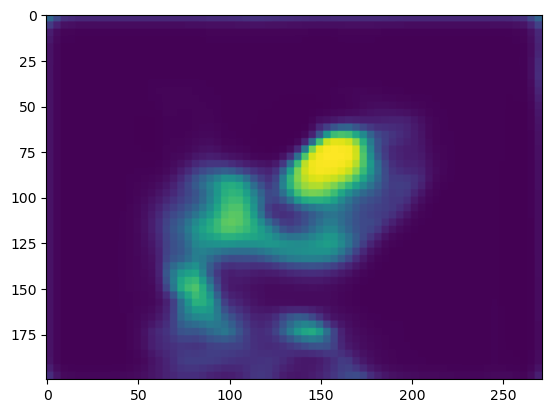

216
tensor([0., 0., 0.])


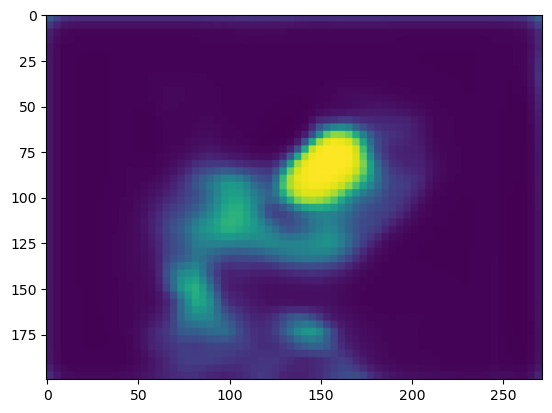

217
tensor([0., 0., 0.])


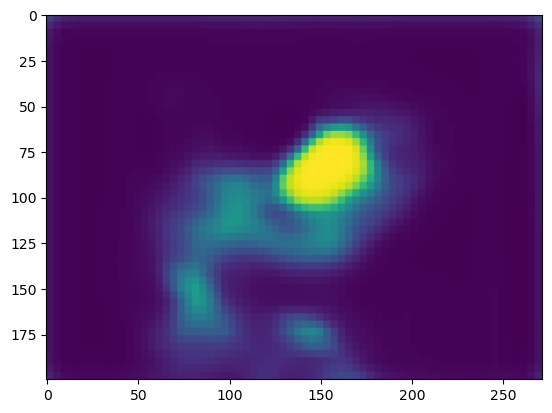

218
tensor([0., 0., 0.])


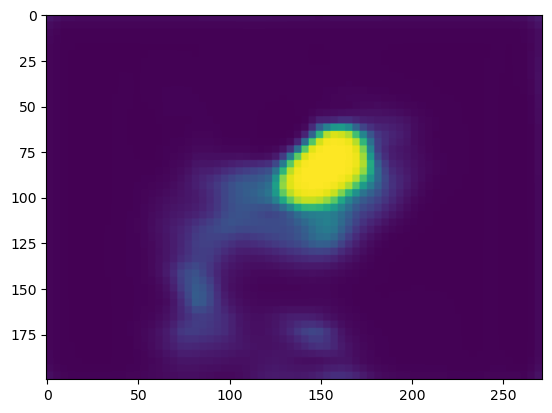

219
tensor([0., 0., 0.])


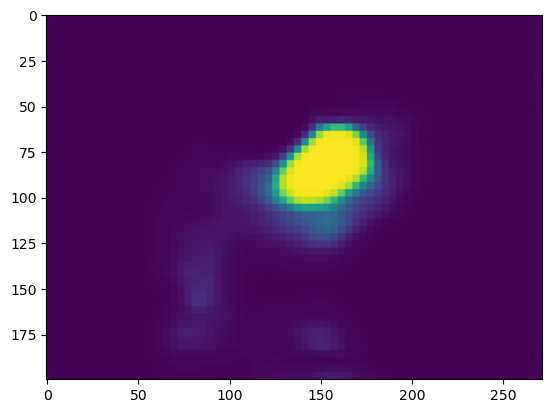

220
tensor([0., 0., 0.])


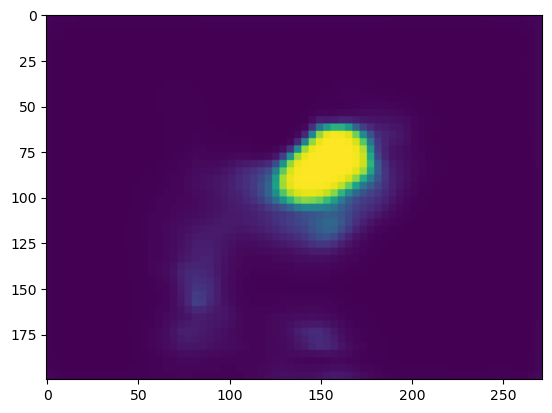

221
tensor([0., 0., 0.])


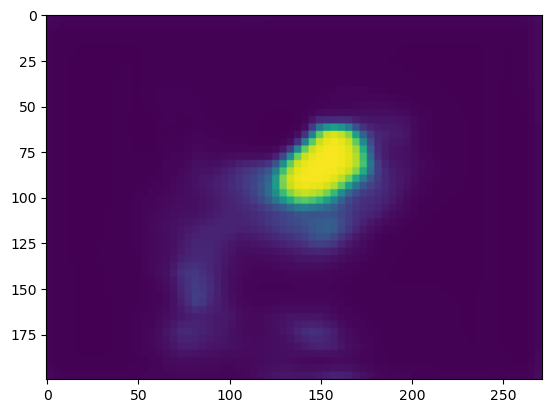

222
tensor([0., 0., 0.])


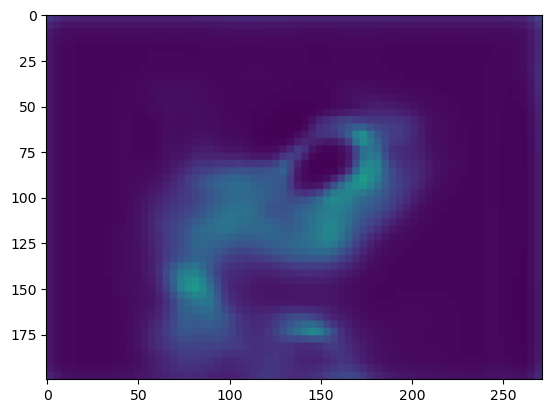

223
tensor([0., 0., 0.])


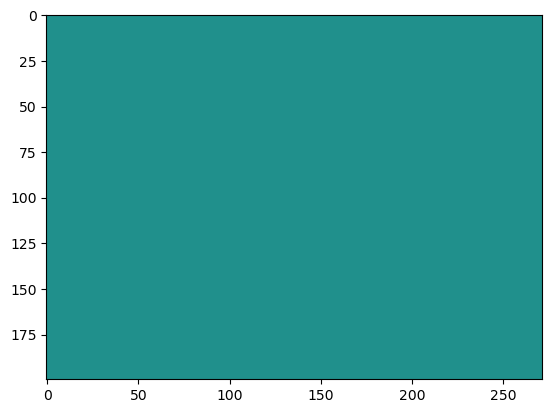

224
tensor([0., 0., 0.])


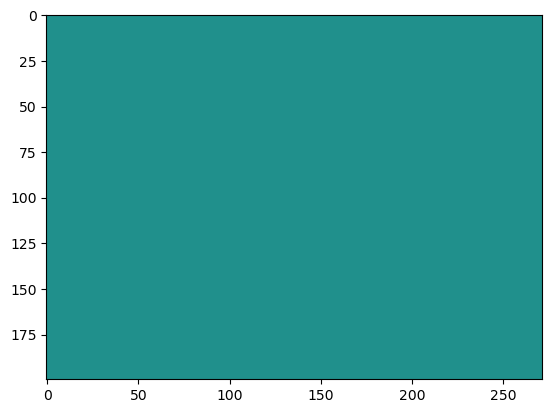

225
tensor([0., 0., 0.])


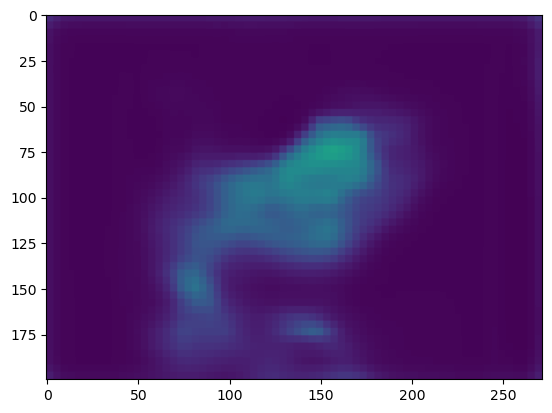

226
tensor([0., 0., 0.])


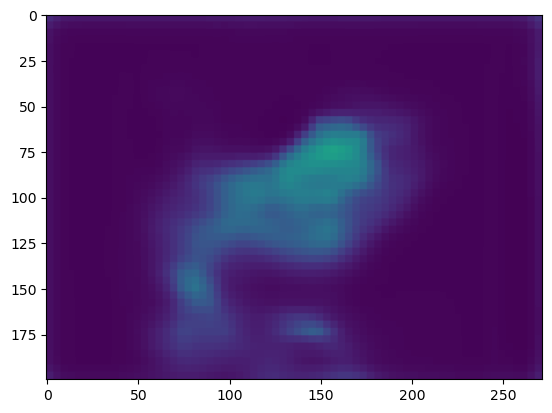

227
tensor([0., 0., 0.])


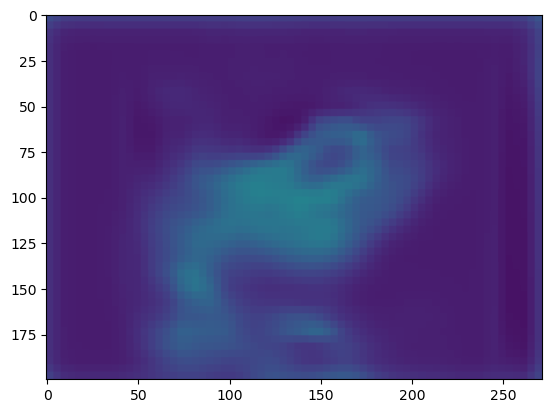

228
tensor([0., 0., 0.])


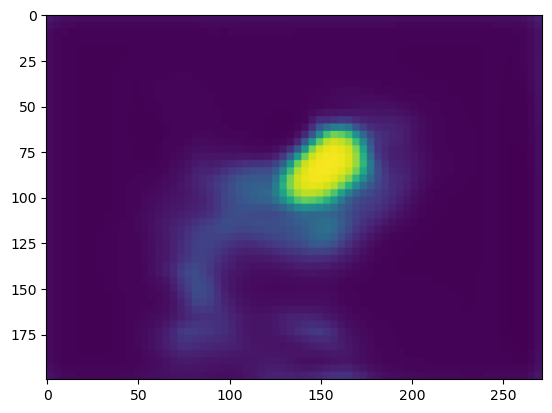

229
tensor([0., 0., 0.])


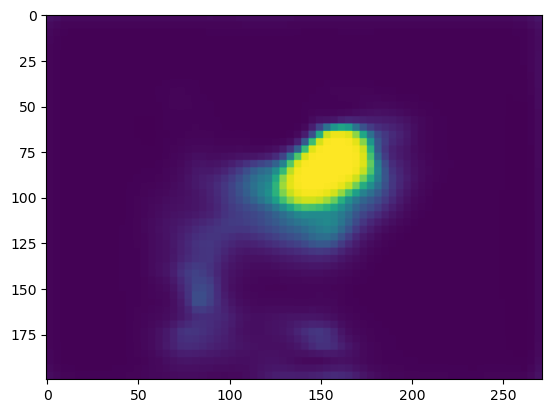

230
tensor([0., 0., 0.])


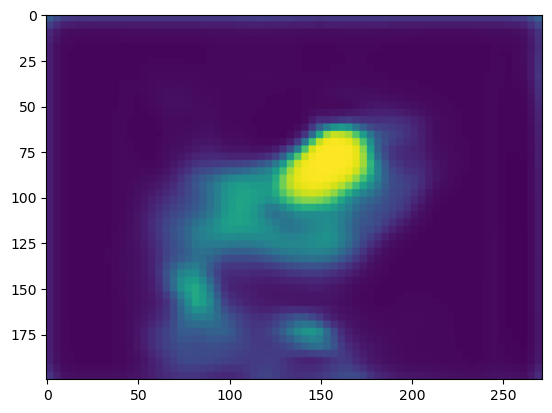

231
tensor([0., 0., 0.])


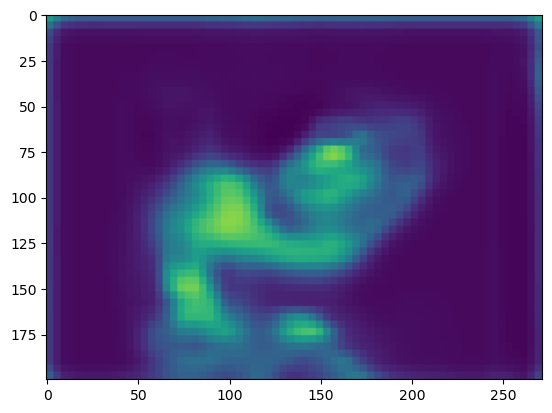

232
tensor([0., 0., 0.])


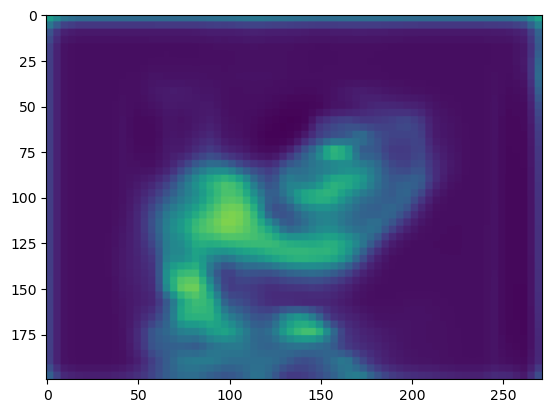

233
tensor([0., 0., 0.])


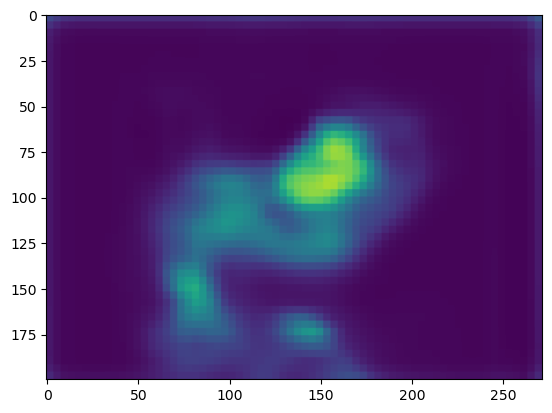

234
tensor([0., 0., 0.])


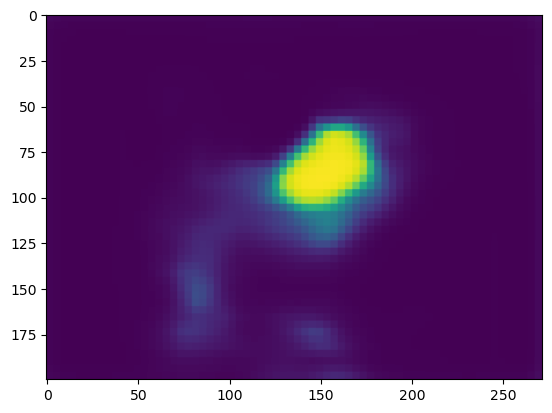

235
tensor([0., 0., 0.])


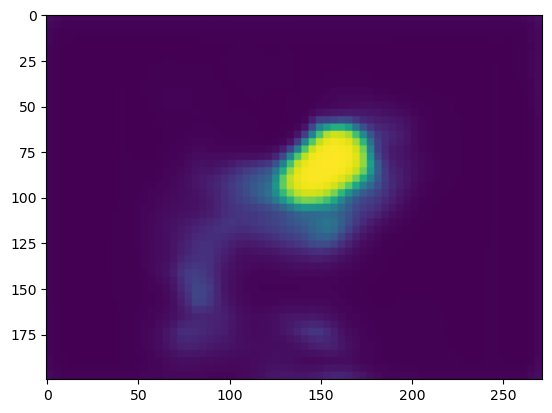

236
tensor([0., 0., 0.])


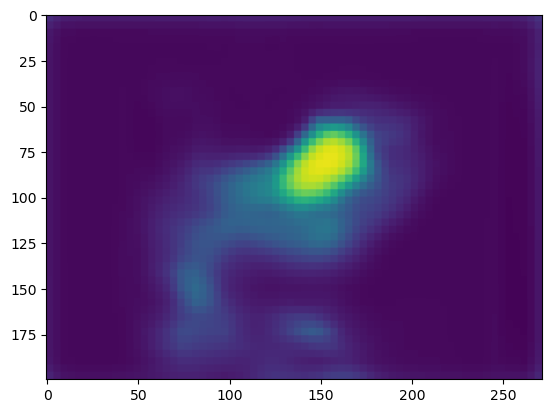

237
tensor([0., 0., 0.])


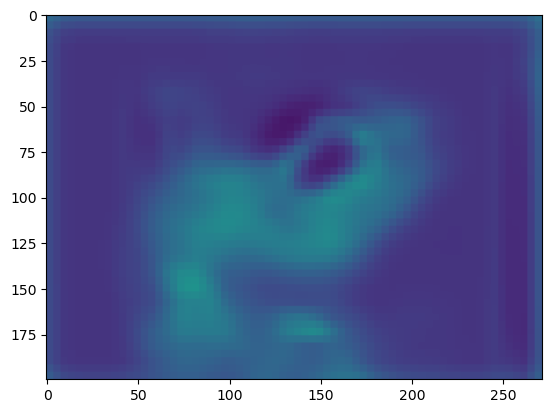

238
tensor([0., 0., 0.])


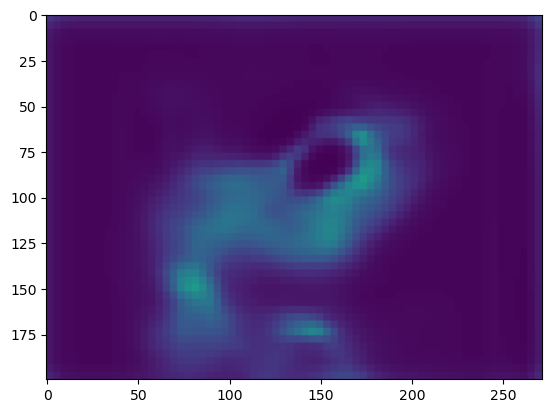

239
tensor([0., 0., 0.])


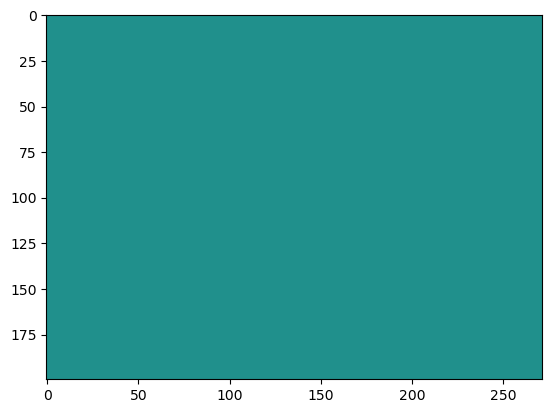

240
tensor([0.0605, 0.0600, 0.0550])


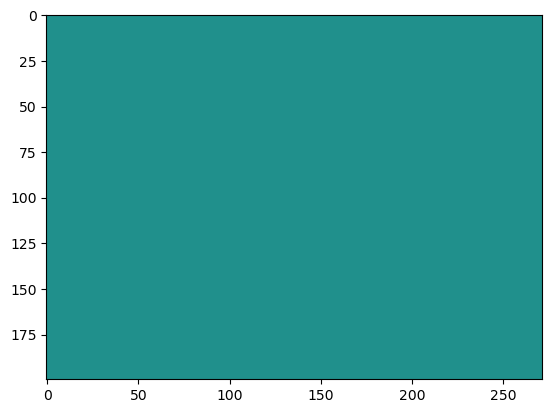

241
tensor([0., 0., 0.])


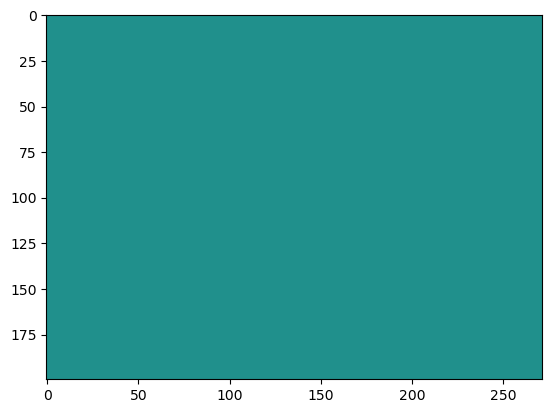

242
tensor([0.0226, 0.0242, 0.0204])


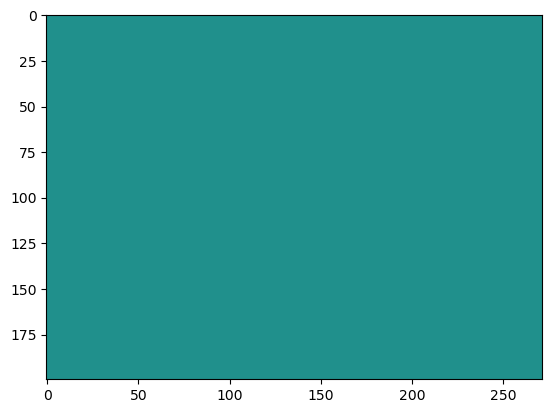

243
tensor([0.0282, 0.0299, 0.0261])


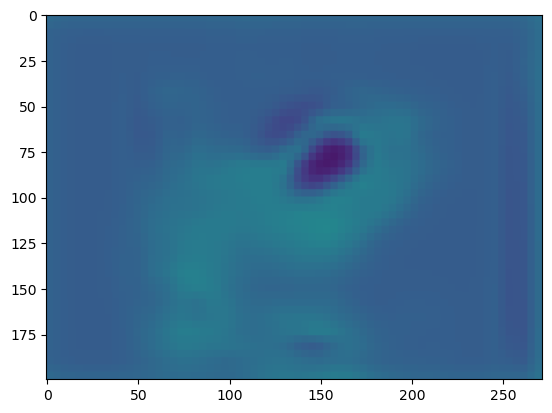

244
tensor([0.0372, 0.0394, 0.0357])


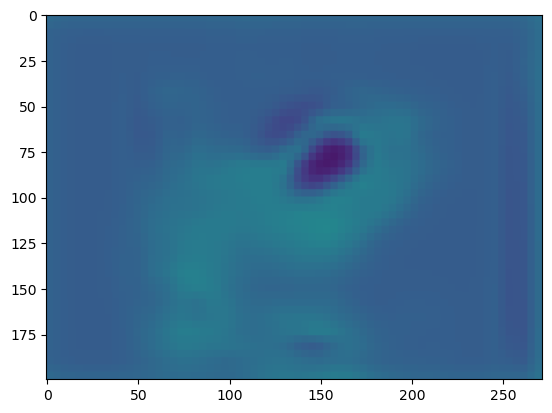

245
tensor([0.0500, 0.0526, 0.0499])


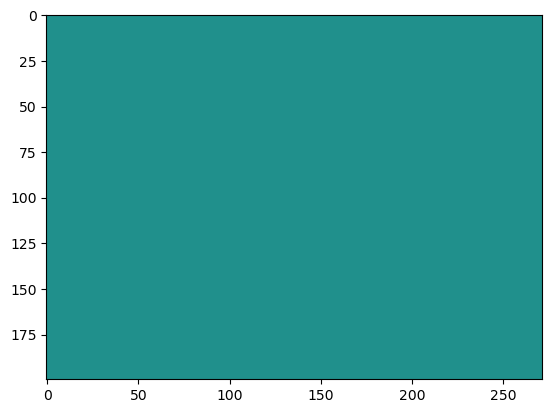

246
tensor([0.0621, 0.0650, 0.0636])


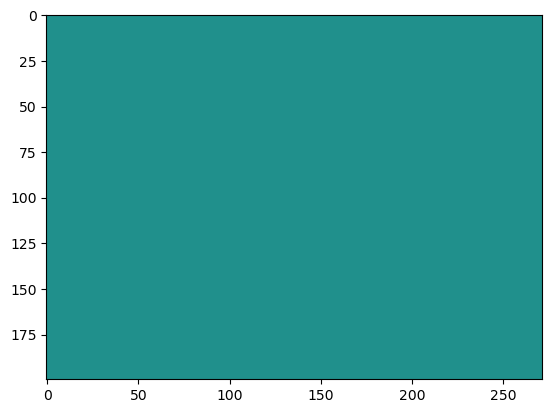

247
tensor([0.0670, 0.0699, 0.0693])


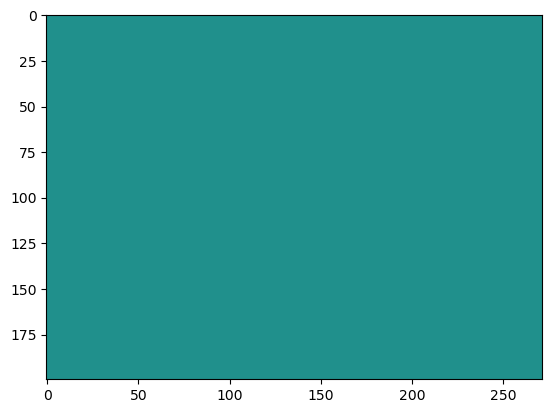

248
tensor([0., 0., 0.])


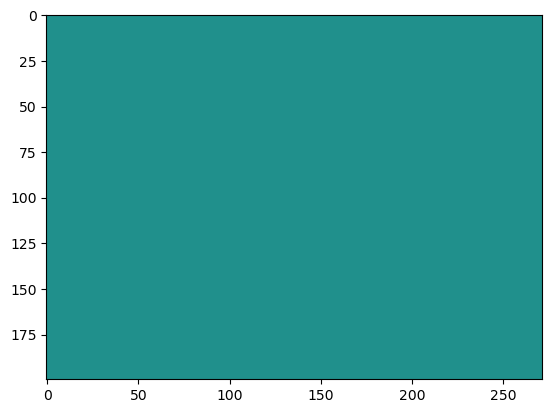

249
tensor([0., 0., 0.])


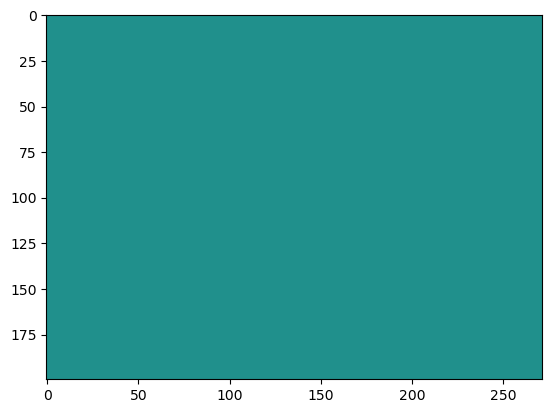

250
tensor([0., 0., 0.])


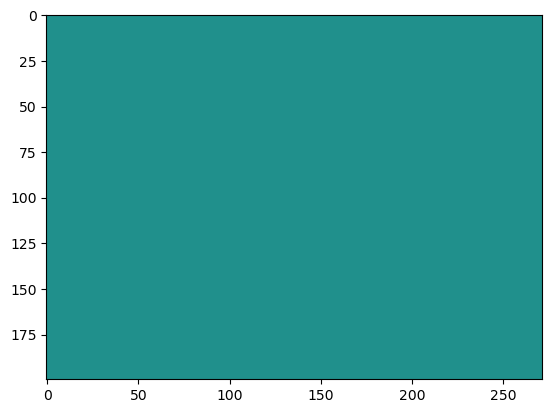

251
tensor([0., 0., 0.])


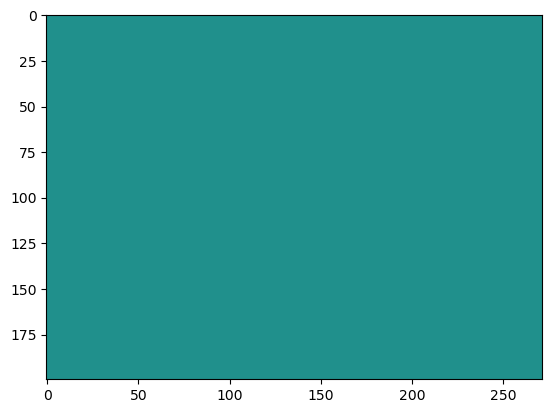

252
tensor([0., 0., 0.])


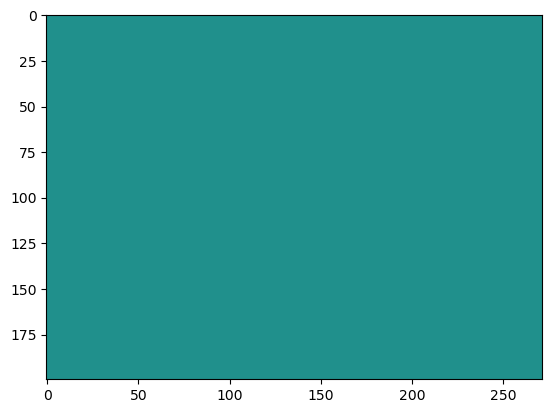

253
tensor([0., 0., 0.])


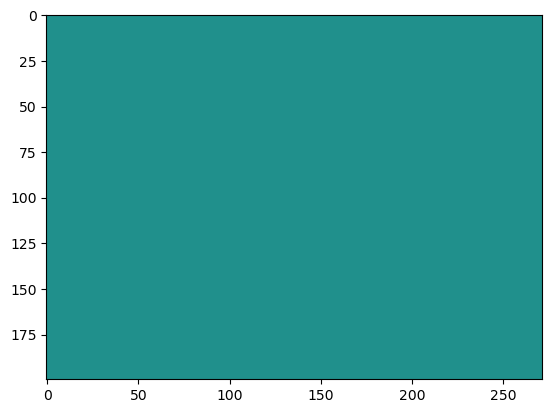

254
tensor([0., 0., 0.])


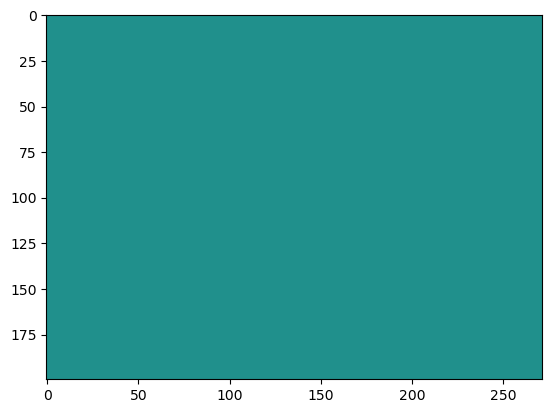

255
tensor([0.0651, 0.0652, 0.0609])


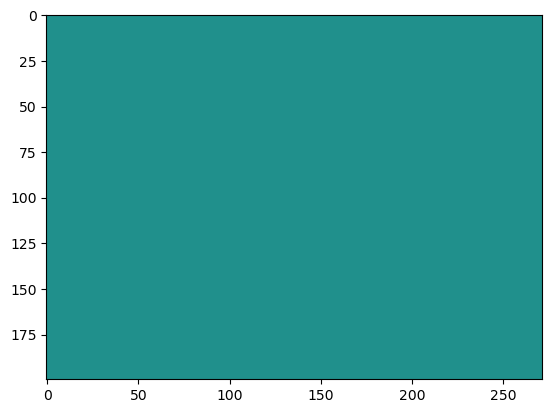

In [35]:
for i in range(256):
    print(i)
    print(cate_pred_list[3].flatten(start_dim=1, end_dim=2)[0, i, :].detach().cpu())
    plt.imshow(ins_pred_list[3][0, i, :, :].detach().cpu(), vmin=0, vmax=1); plt.show()

In [151]:
model = SOLO.load_from_checkpoint("checkpoints/solo_epoch=35.ckpt")
model

SOLO(
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(256, eps=1e

In [152]:
batch = next(iter(train_loader))
batch[1]

(tensor([2]),)

In [153]:
img, label_list, mask_list, bbox_list = batch
backout = model.backbone(img.cuda())
fpn_feat_list = list(backout.values())

cate_pred_list, ins_pred_list = model.head.forward(fpn_feat_list, evaluate=True)
nms_sorted_scores, nms_sorted_labels, nms_sorted_ins = model.head.PostProcess(ins_pred_list, cate_pred_list, (img.shape[-2], img.shape[-1]))

0
tensor([0.7974, 0.1850, 0.2067])


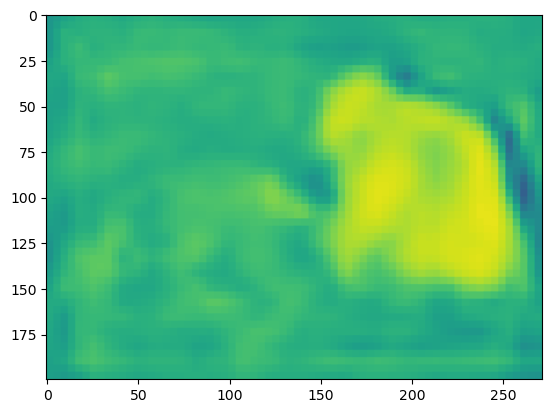

1
tensor([0.9075, 0.0000, 0.0000])


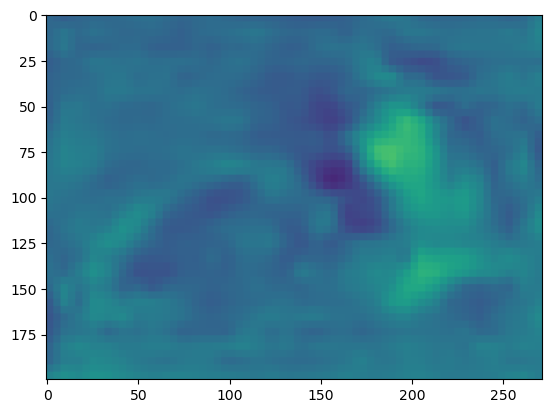

2
tensor([0.9196, 0.0661, 0.0000])


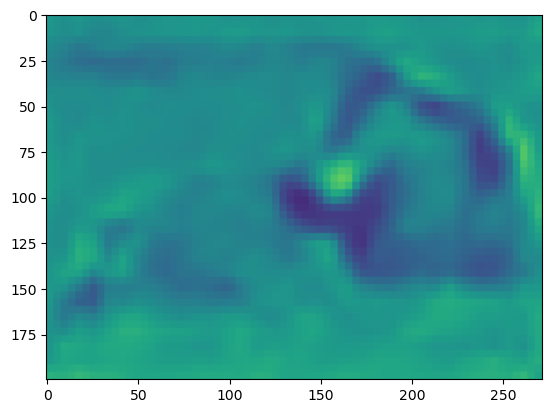

3
tensor([0.0000, 0.0883, 0.0000])


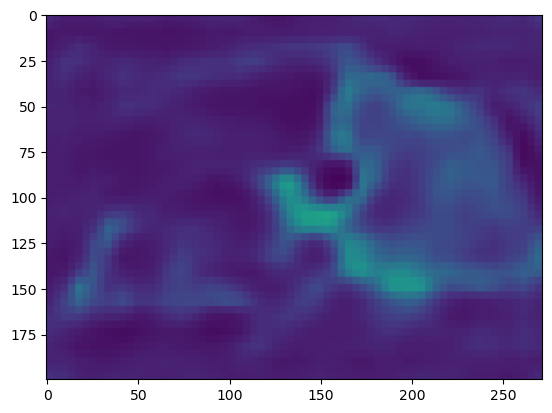

4
tensor([0.0000, 0.1056, 0.0848])


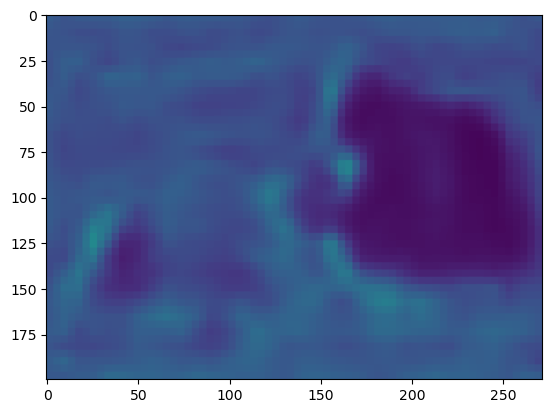

5
tensor([0.0000, 0.2191, 0.0848])


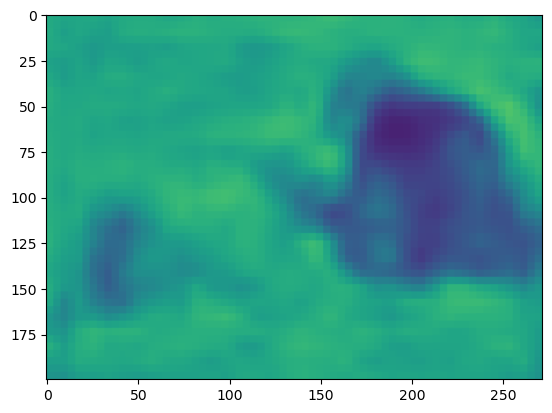

6
tensor([0.0000, 0.0000, 0.1297])


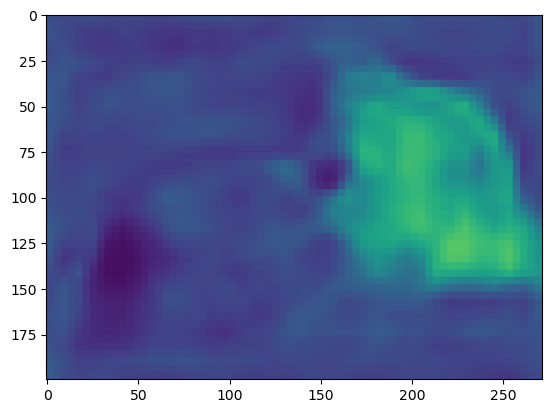

7
tensor([0.0000, 0.2218, 0.2839])


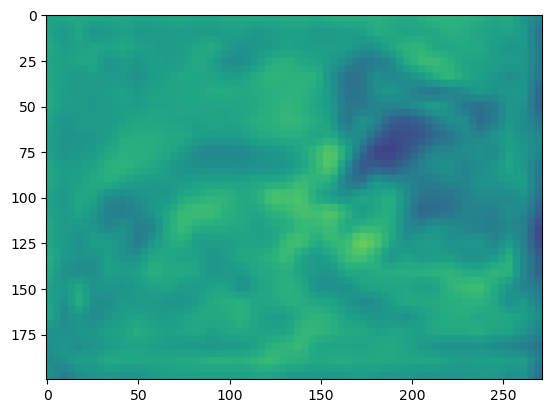

8
tensor([0.6327, 0.2350, 0.2982])


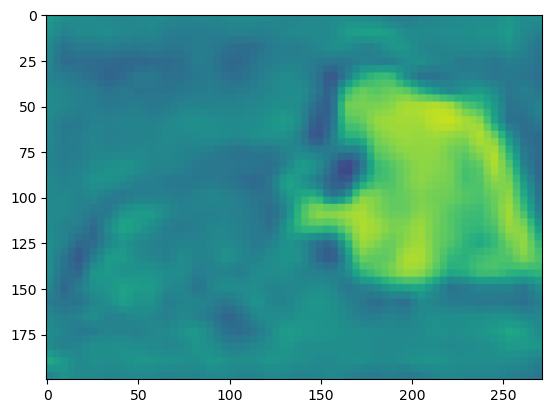

9
tensor([0.0000, 0.2376, 0.3582])


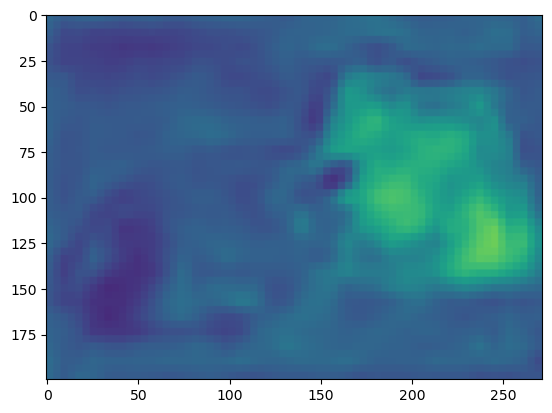

10
tensor([0.0000, 0.3133, 0.4555])


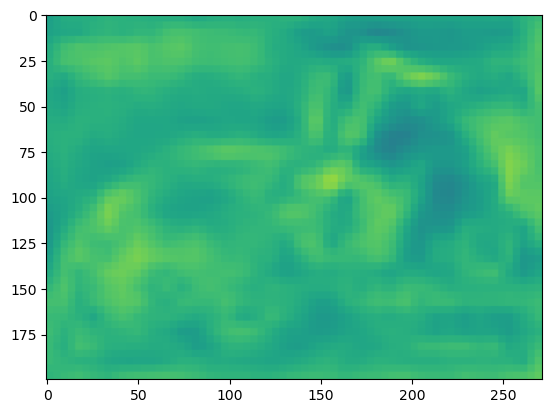

11
tensor([0.2541, 0.3819, 0.0000])


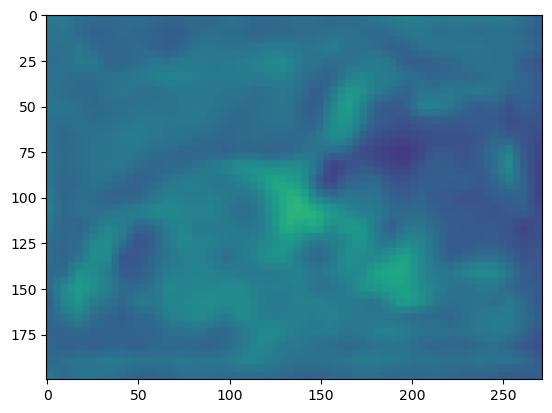

12
tensor([0., 0., 0.])


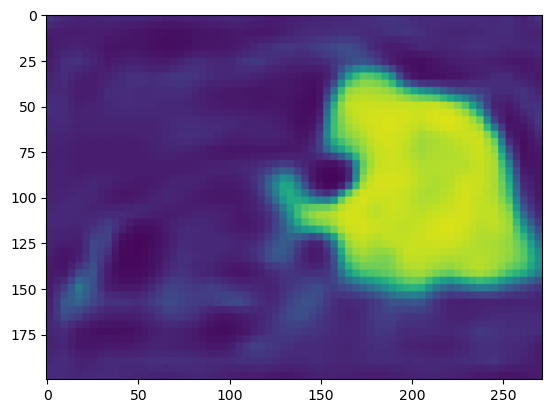

13
tensor([0.3339, 0.0000, 0.4728])


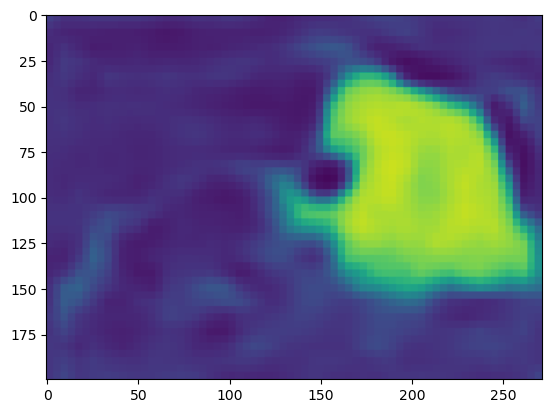

14
tensor([0.4131, 0.2541, 0.0000])


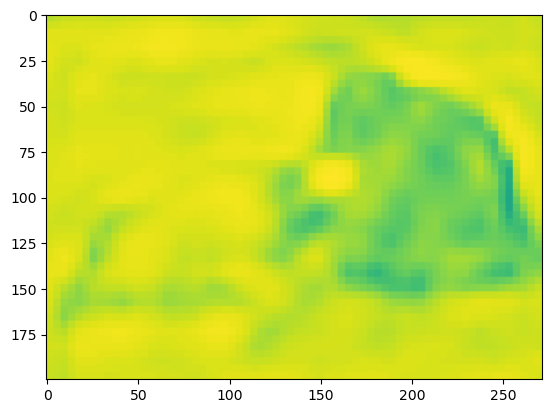

15
tensor([0.0000, 0.3555, 0.3449])


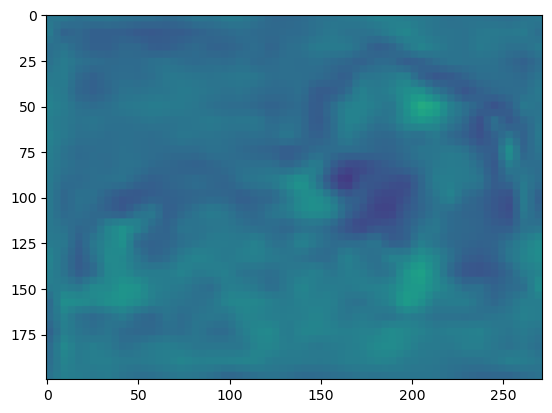

16
tensor([0.9069, 0.0000, 0.0000])


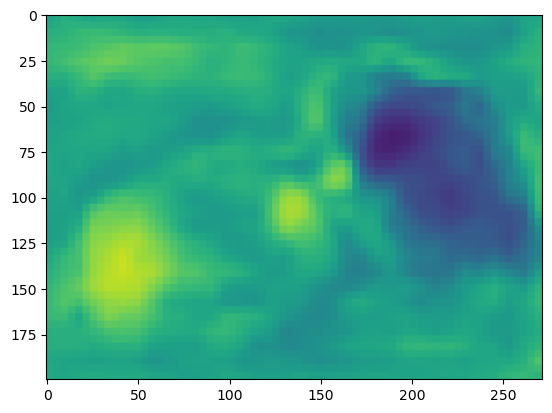

17
tensor([0.9862, 0.0000, 0.0000])


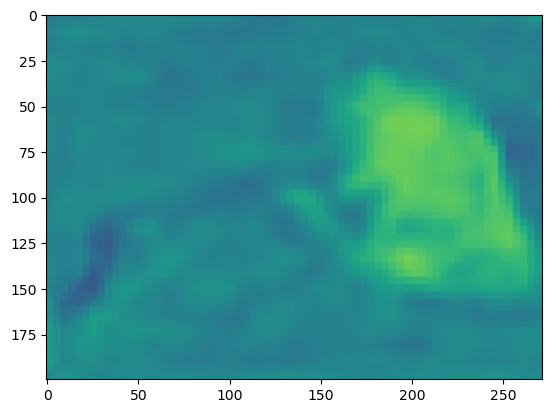

18
tensor([0.9871, 0.0000, 0.0000])


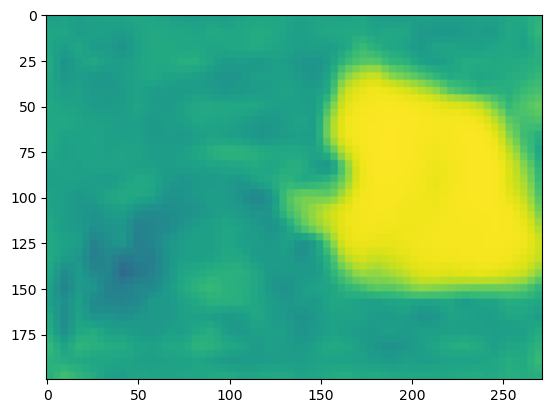

19
tensor([0., 0., 0.])


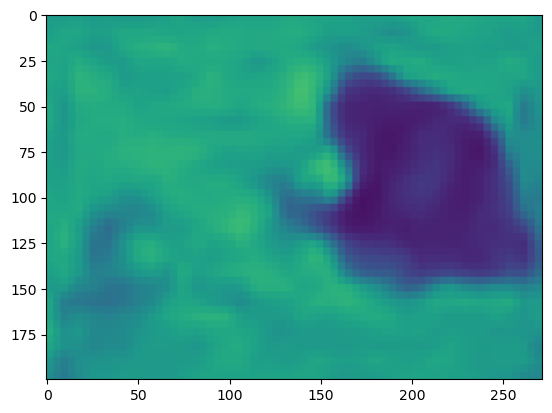

20
tensor([0., 0., 0.])


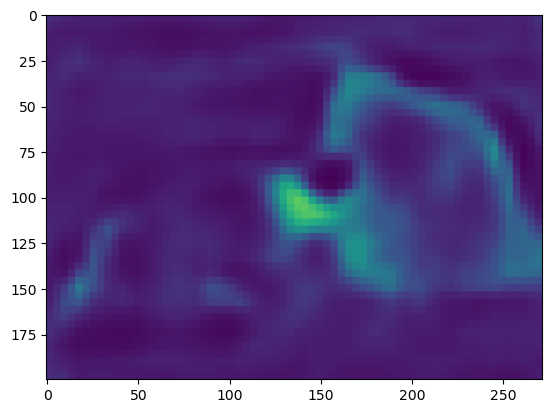

21
tensor([0., 0., 0.])


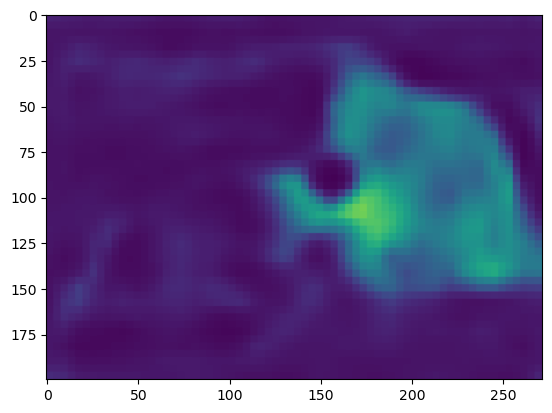

22
tensor([0., 0., 0.])


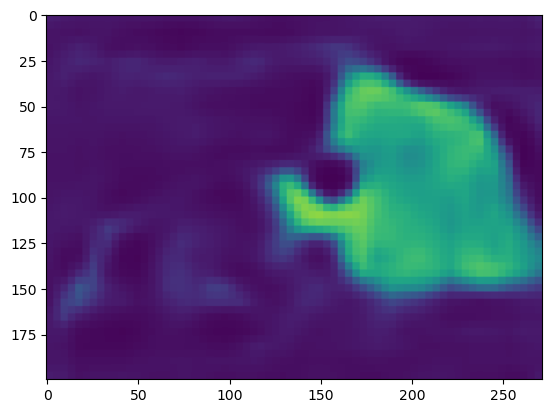

23
tensor([0., 0., 0.])


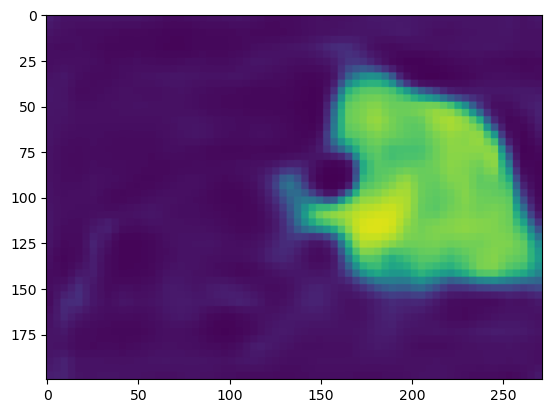

24
tensor([0.0000, 0.0000, 0.3741])


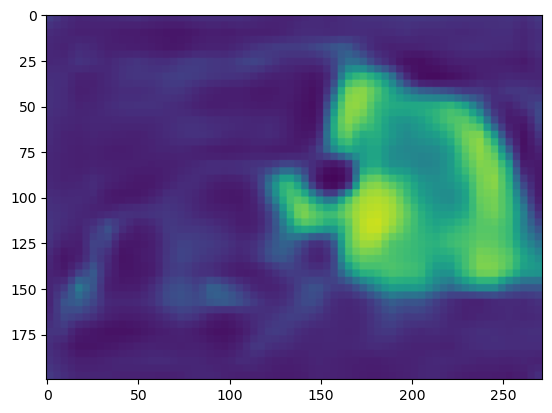

25
tensor([0.0000, 0.0000, 0.4022])


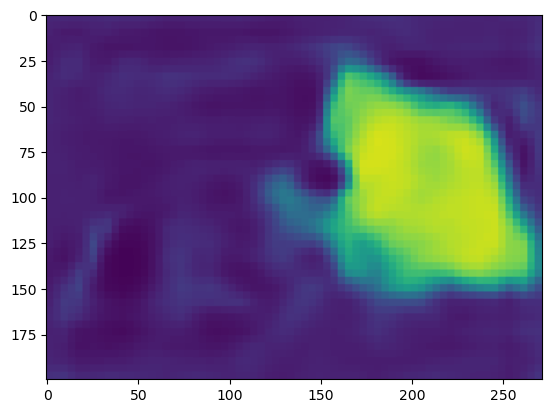

26
tensor([0.0000, 0.3857, 0.5009])


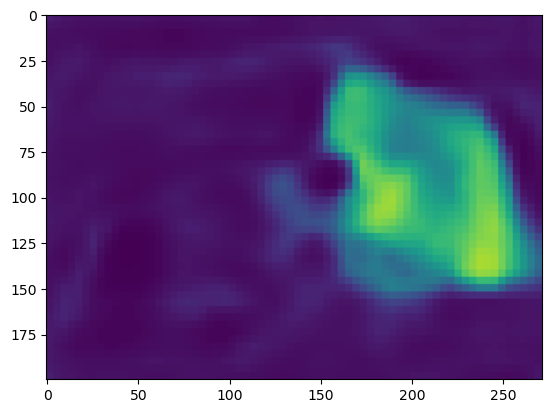

27
tensor([0.0000, 0.4833, 0.0000])


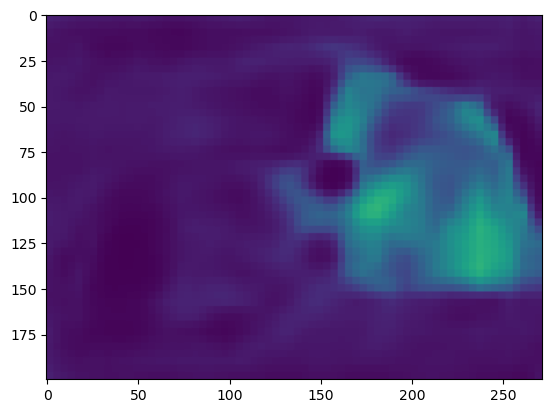

28
tensor([0., 0., 0.])


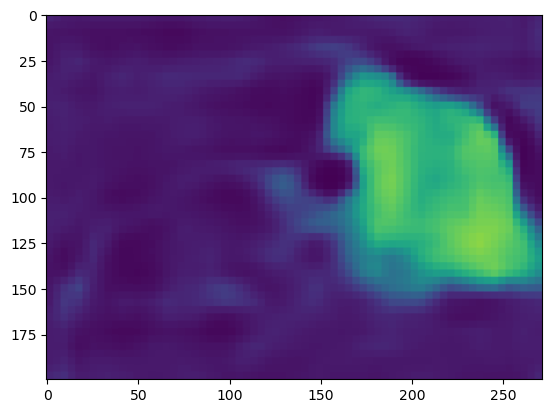

29
tensor([0.0000, 0.4693, 0.0000])


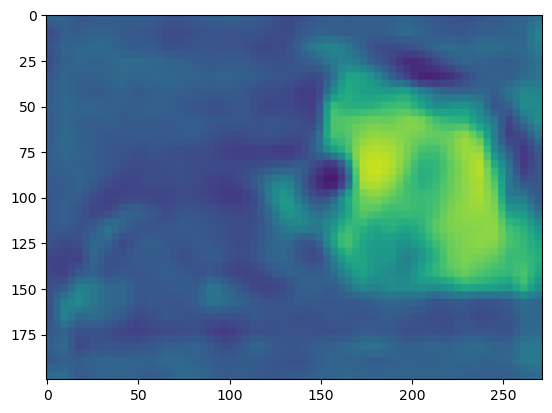

30
tensor([0., 0., 0.])


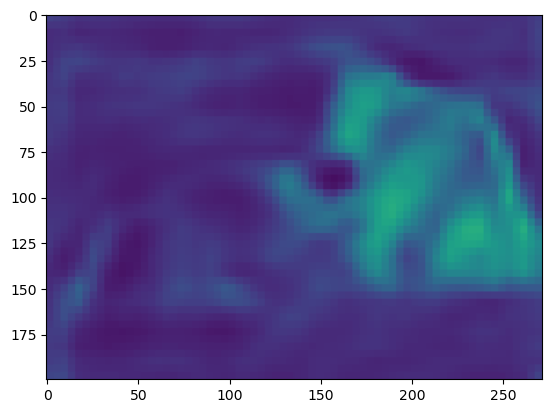

31
tensor([0.4534, 0.4098, 0.0000])


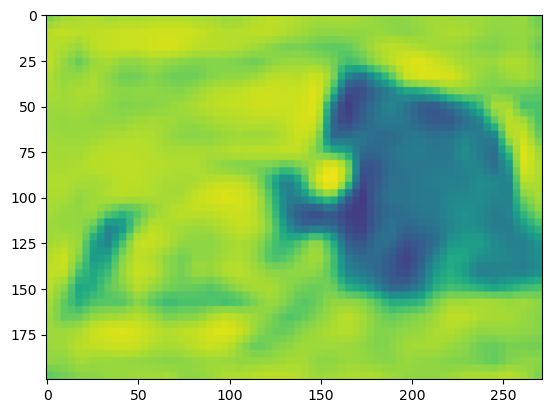

32
tensor([0.9343, 0.0000, 0.0000])


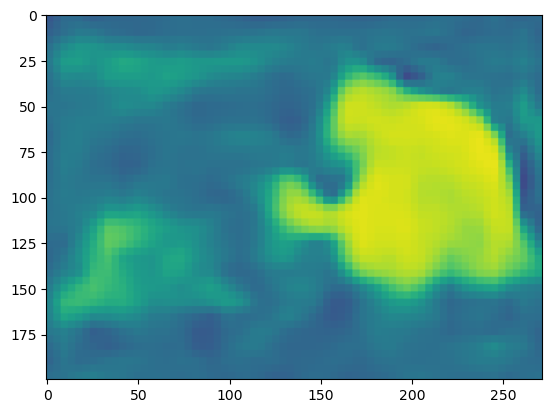

33
tensor([0.9878, 0.0000, 0.0000])


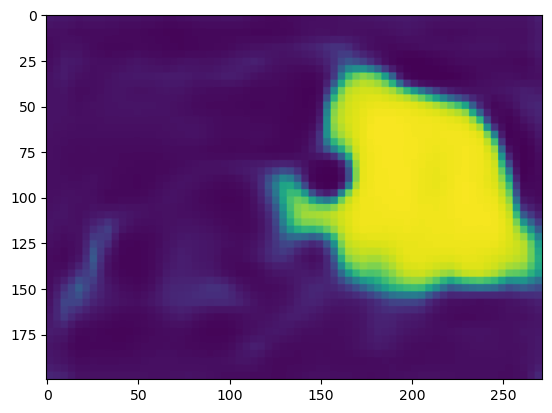

34
tensor([0.9905, 0.0157, 0.0000])


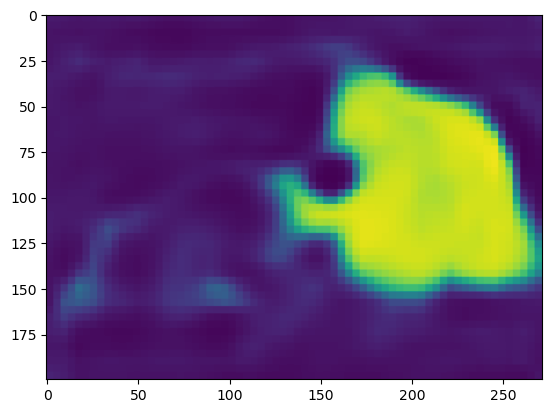

35
tensor([0., 0., 0.])


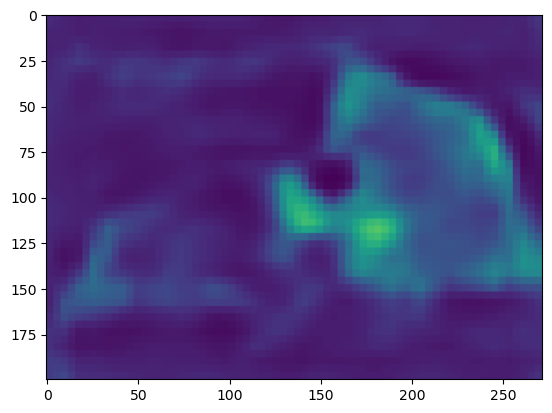

36
tensor([0.0000, 0.0000, 0.0385])


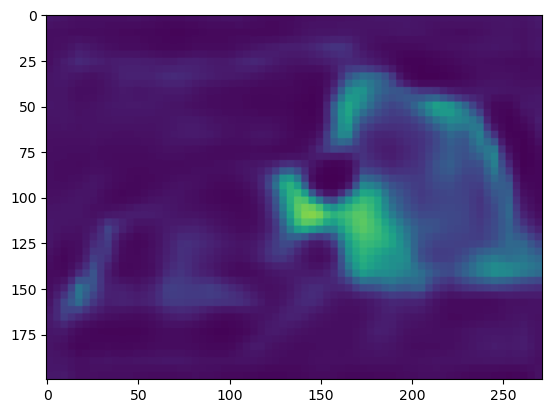

37
tensor([0.0000, 0.0000, 0.0539])


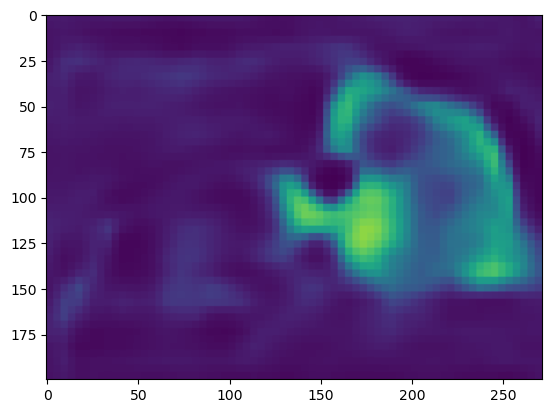

38
tensor([0.0000, 0.0000, 0.2476])


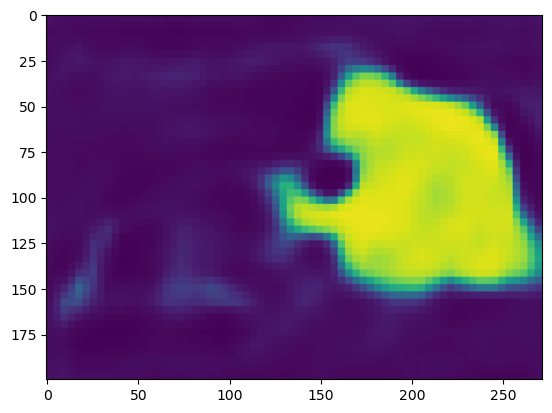

39
tensor([0.0000, 0.0000, 0.3737])


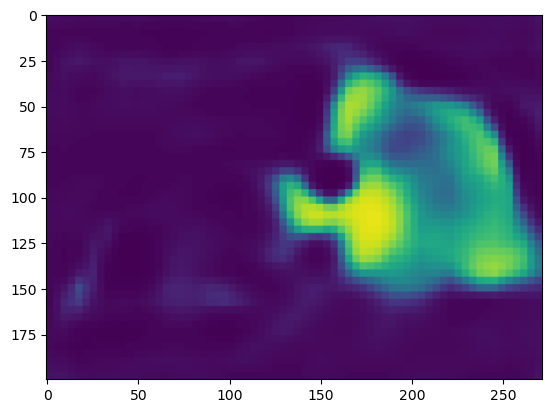

40
tensor([0.0000, 0.0000, 0.5399])


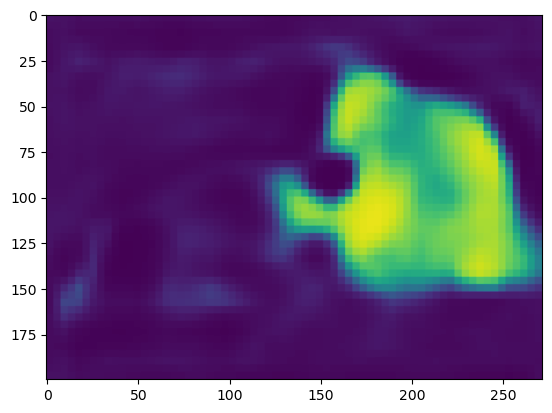

41
tensor([0.0000, 0.2269, 0.6769])


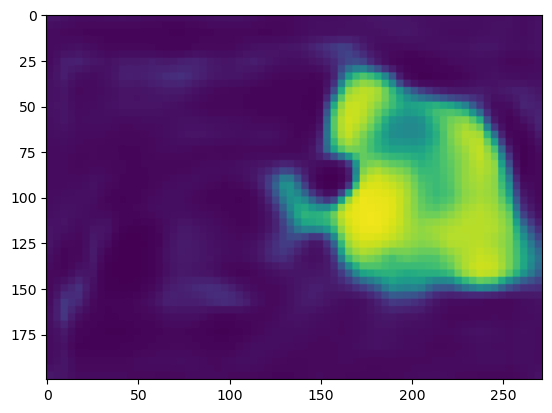

42
tensor([0.0000, 0.6629, 0.0000])


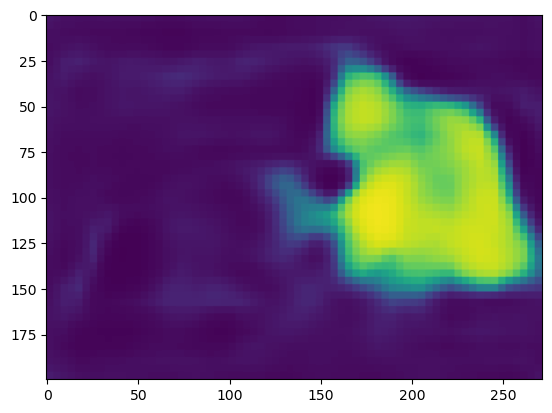

43
tensor([0.0000, 0.8608, 0.0000])


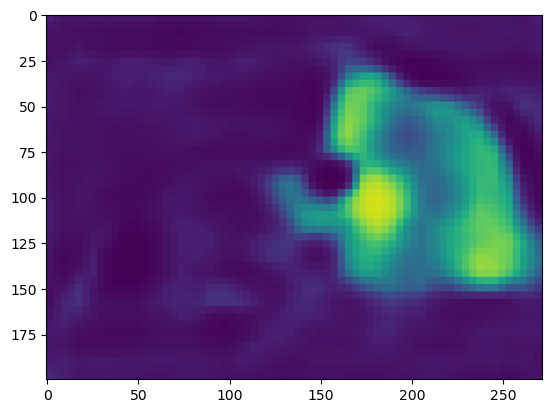

44
tensor([0., 0., 0.])


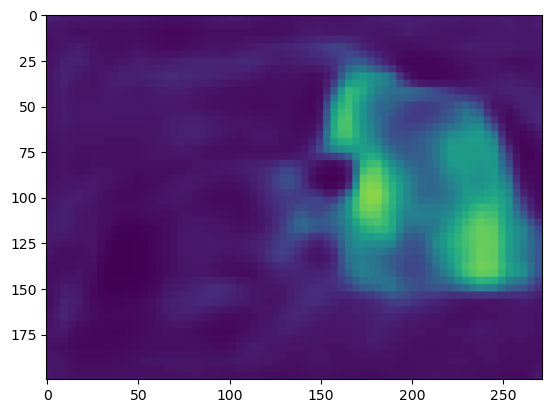

45
tensor([0., 0., 0.])


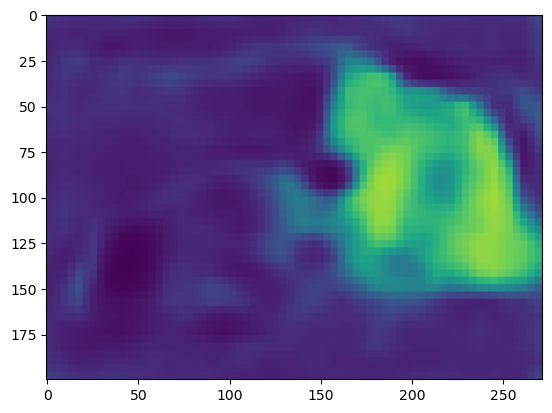

46
tensor([0., 0., 0.])


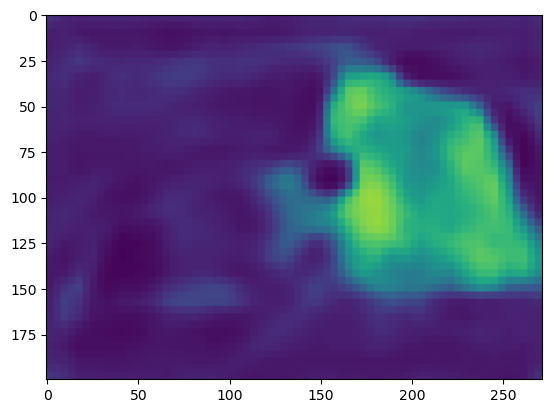

47
tensor([0.0000, 0.6554, 0.0000])


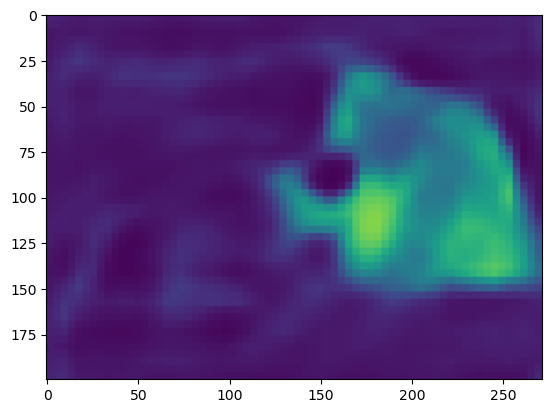

48
tensor([0.0000, 0.1075, 0.1894])


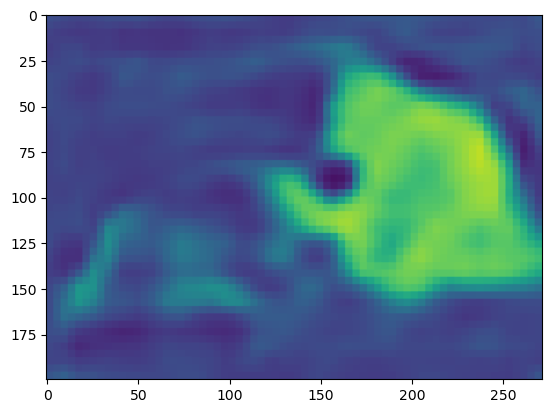

49
tensor([0., 0., 0.])


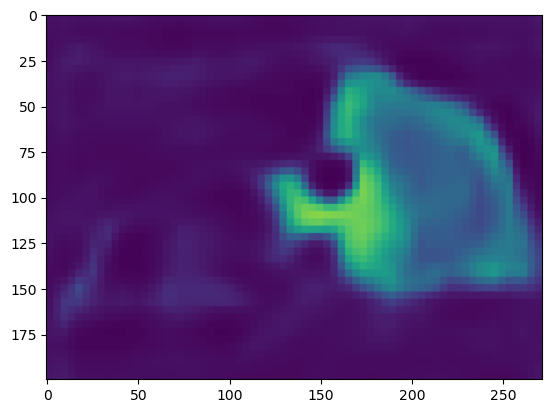

50
tensor([0., 0., 0.])


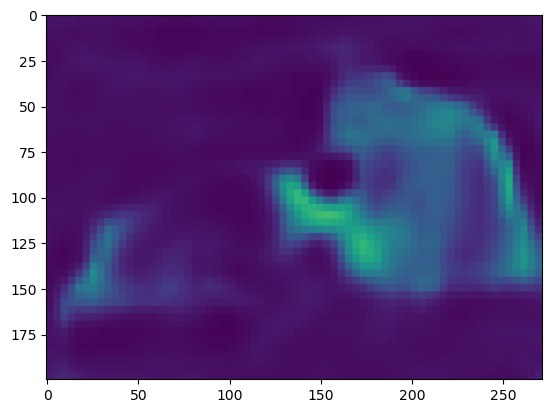

51
tensor([0.0000, 0.0000, 0.0587])


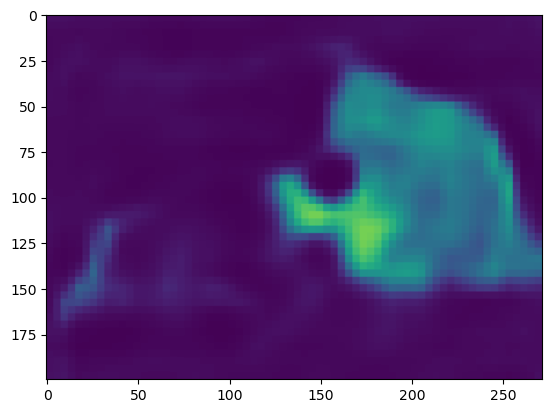

52
tensor([0.0000, 0.0000, 0.1053])


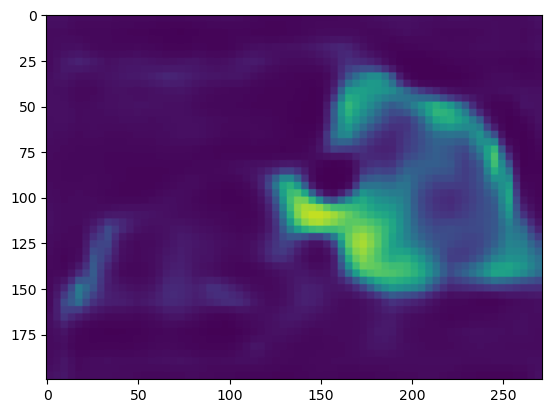

53
tensor([0.0000, 0.0000, 0.3344])


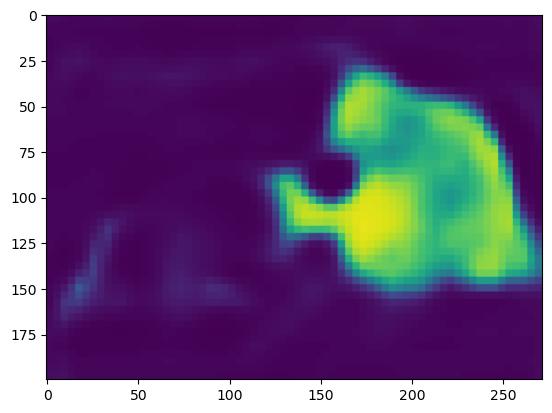

54
tensor([0.0000, 0.0000, 0.6346])


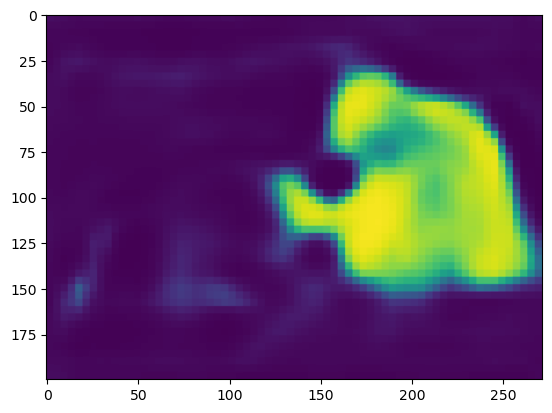

55
tensor([0.0000, 0.0000, 0.6999])


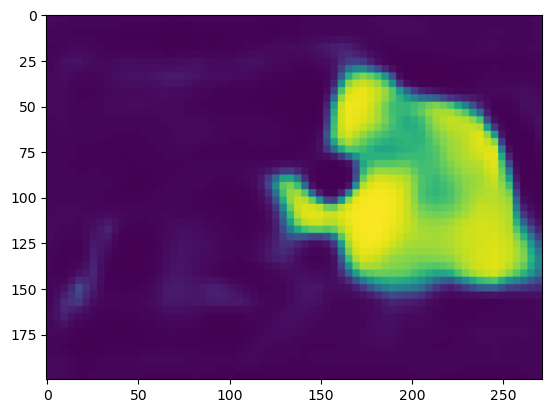

56
tensor([0.0000, 0.1434, 0.7125])


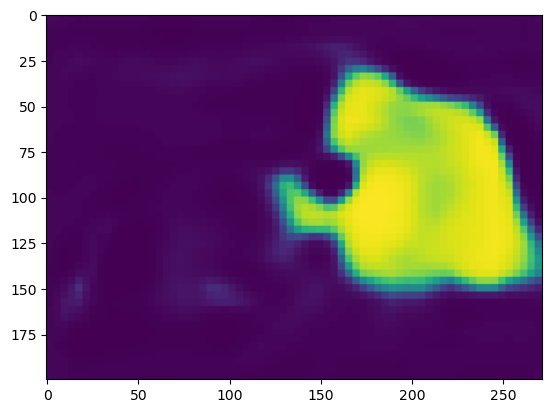

57
tensor([0.0000, 0.5985, 0.0000])


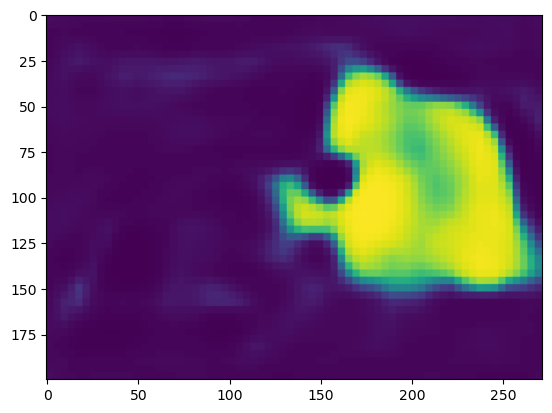

58
tensor([0.0000, 0.9230, 0.0000])


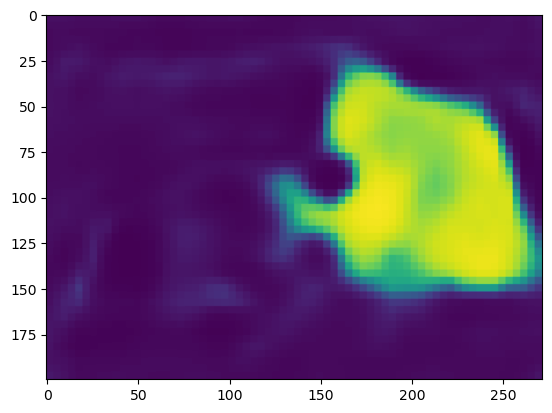

59
tensor([0.0000, 0.9569, 0.0000])


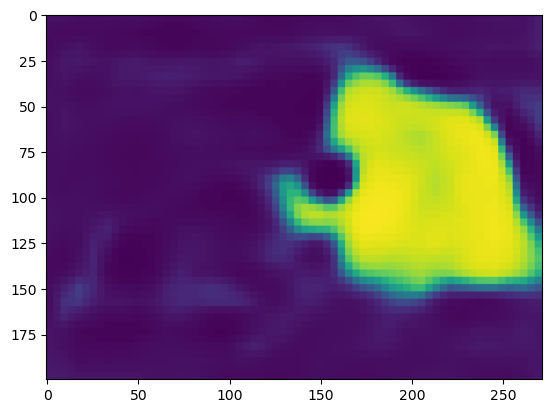

60
tensor([0.0000, 0.9833, 0.0000])


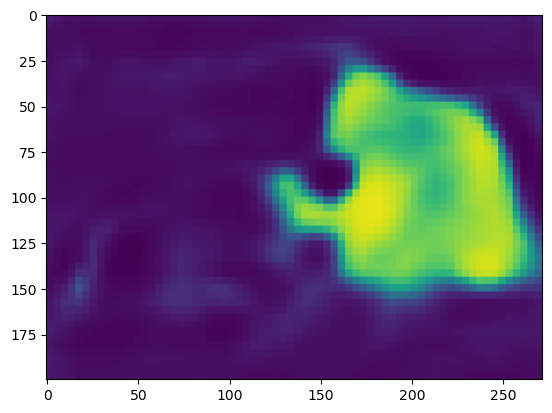

61
tensor([0., 0., 0.])


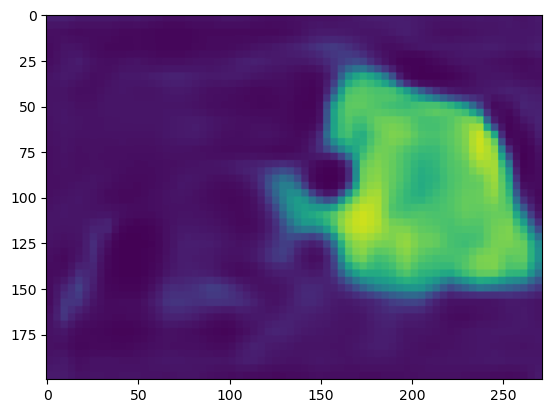

62
tensor([0., 0., 0.])


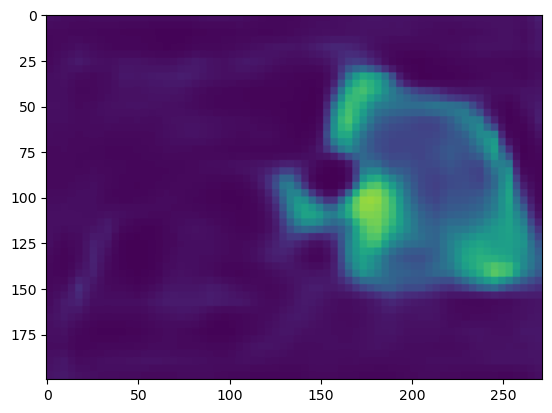

63
tensor([0., 0., 0.])


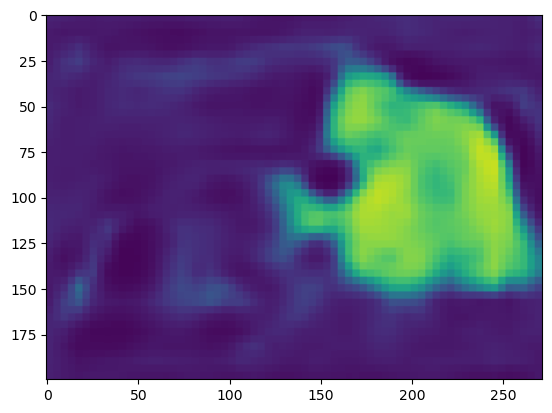

64
tensor([0.0000, 0.1637, 0.2782])


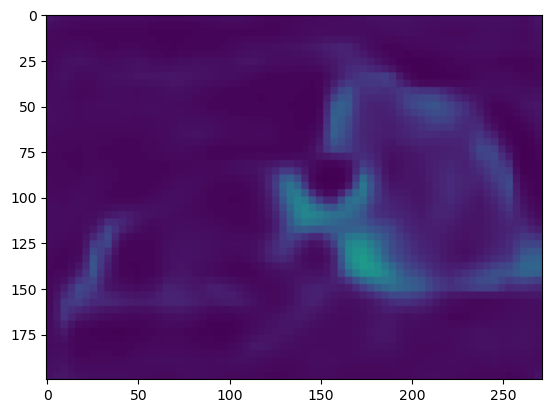

65
tensor([0.0000, 0.0000, 0.2922])


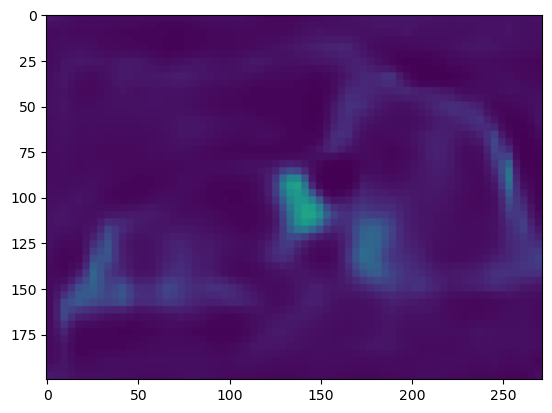

66
tensor([0.0000, 0.0000, 0.3051])


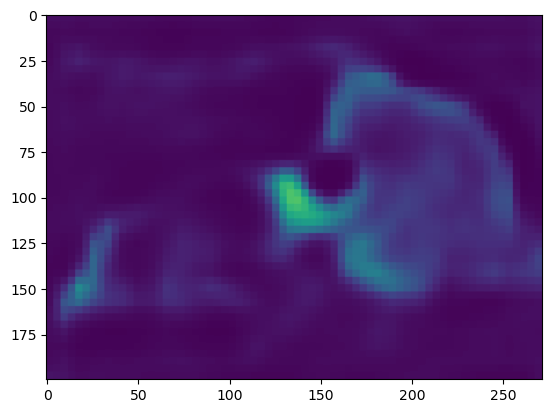

67
tensor([0.0000, 0.0000, 0.4063])


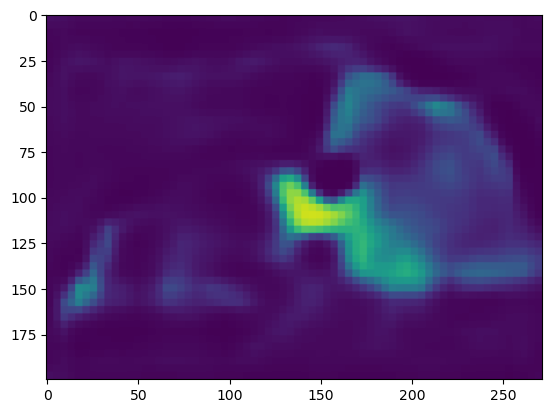

68
tensor([0.0000, 0.0000, 0.7265])


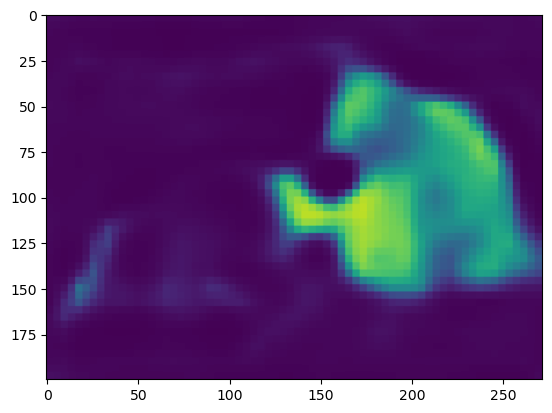

69
tensor([0.0000, 0.0000, 0.8382])


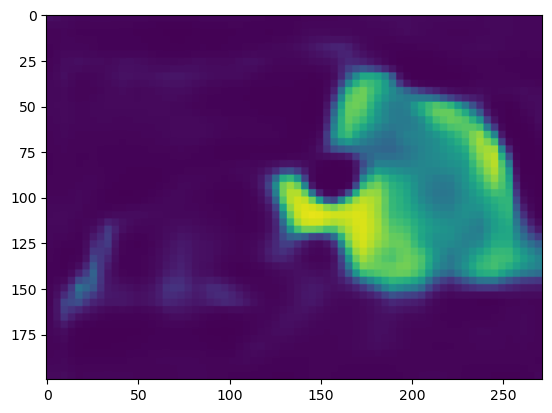

70
tensor([0.0000, 0.0000, 0.8608])


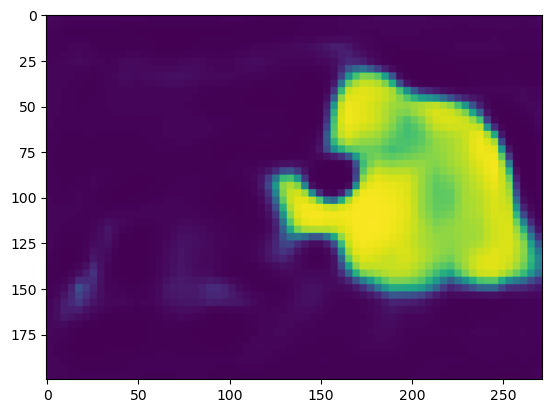

71
tensor([0.0000, 0.0761, 0.0000])


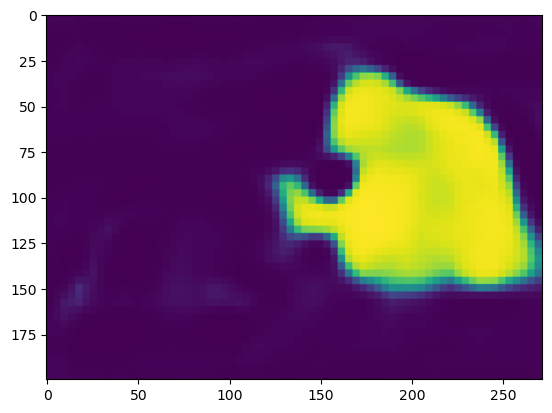

72
tensor([0.0000, 0.3775, 0.0000])


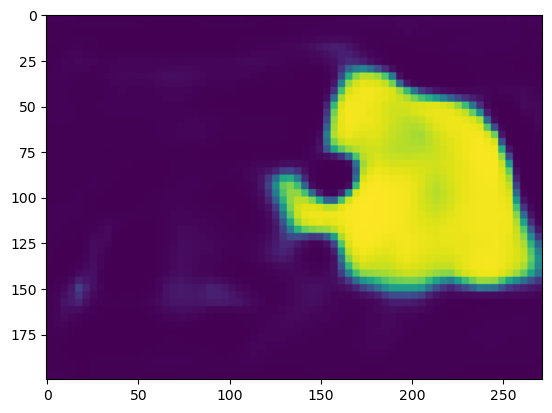

73
tensor([0.0000, 0.8952, 0.0000])


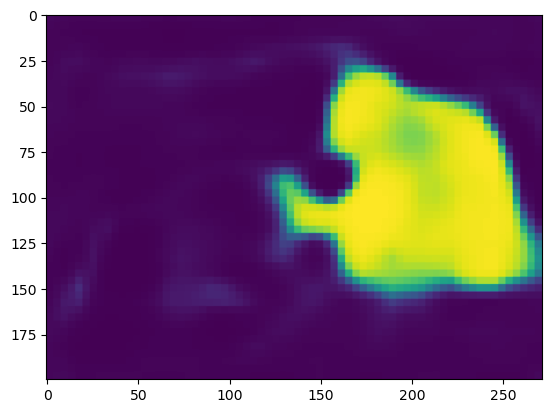

74
tensor([0.0000, 0.9902, 0.0000])


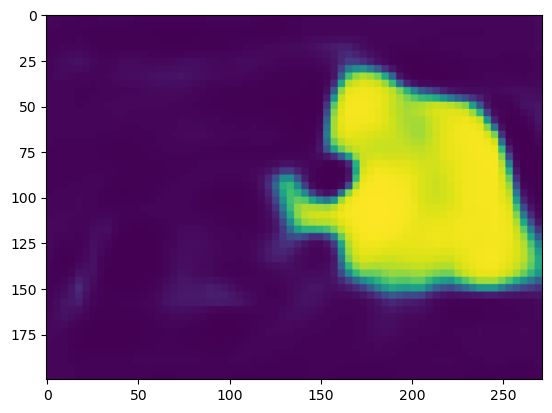

75
tensor([0.0000, 0.9942, 0.0000])


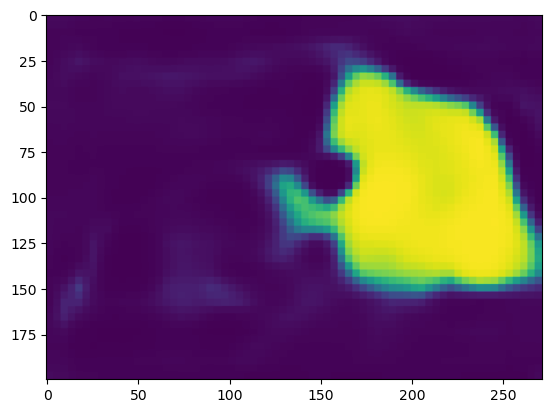

76
tensor([0.0000, 0.9984, 0.0000])


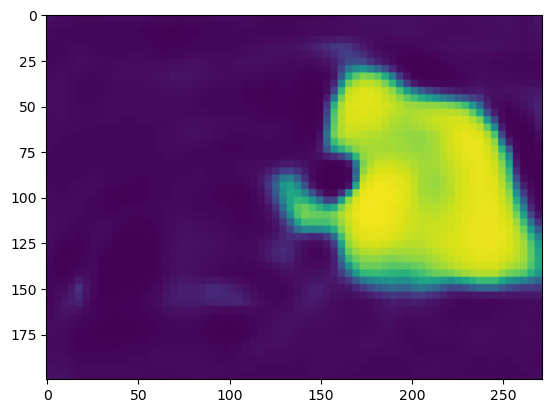

77
tensor([0., 0., 0.])


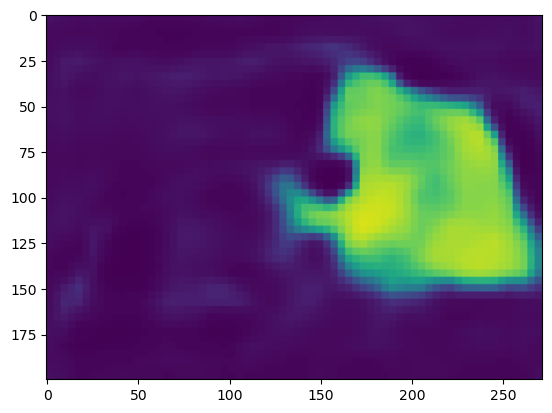

78
tensor([0., 0., 0.])


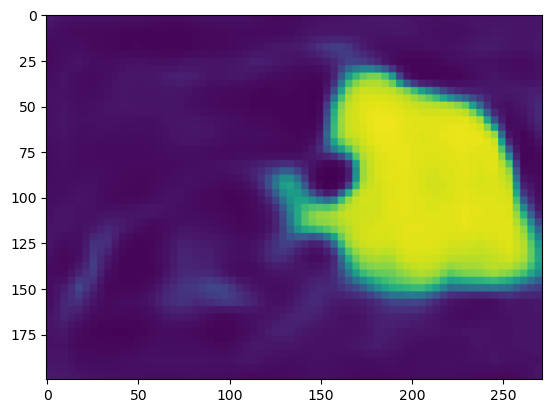

79
tensor([0.0000, 0.0000, 0.1134])


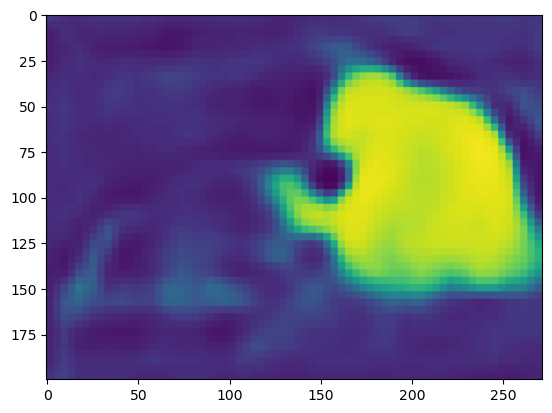

80
tensor([0.0000, 0.0000, 0.3779])


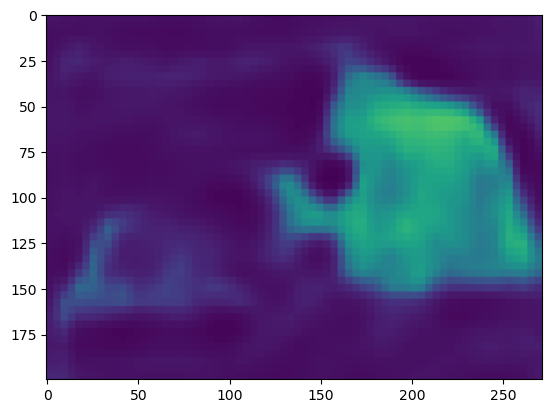

81
tensor([0.0000, 0.0000, 0.6443])


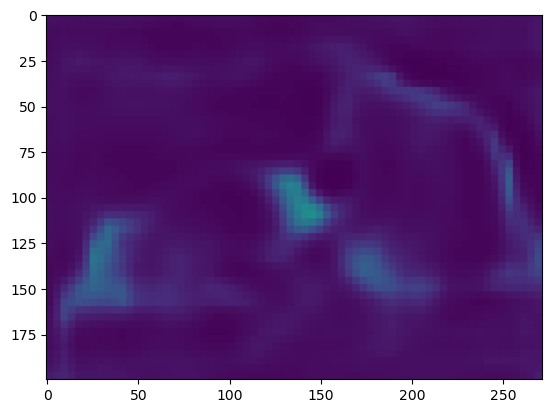

82
tensor([0.0000, 0.0000, 0.8490])


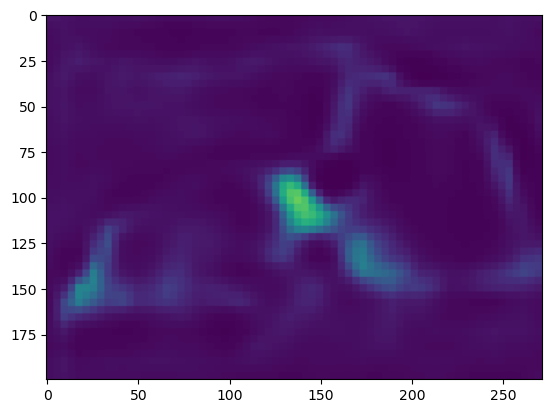

83
tensor([0.0000, 0.0000, 0.9193])


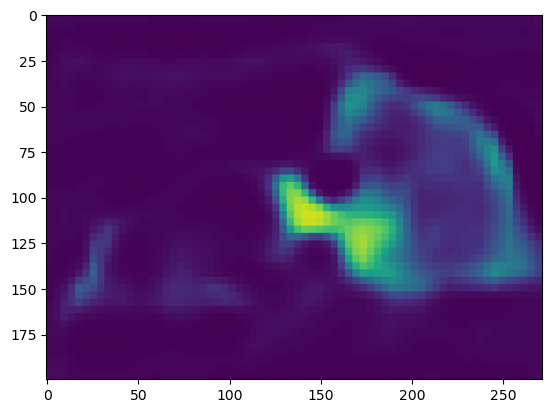

84
tensor([0.0000, 0.0000, 0.9735])


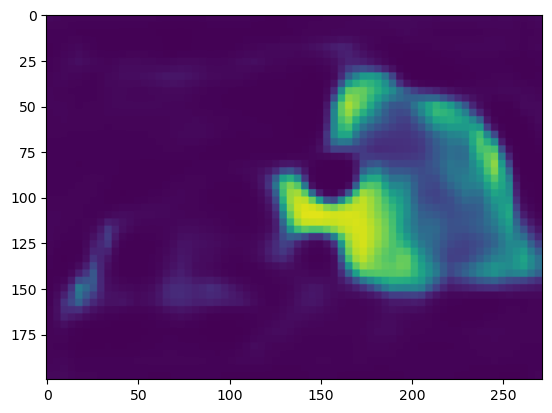

85
tensor([0.0000, 0.0000, 0.9827])


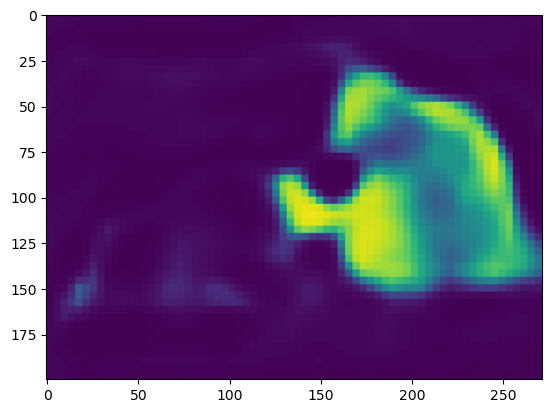

86
tensor([0., 0., 0.])


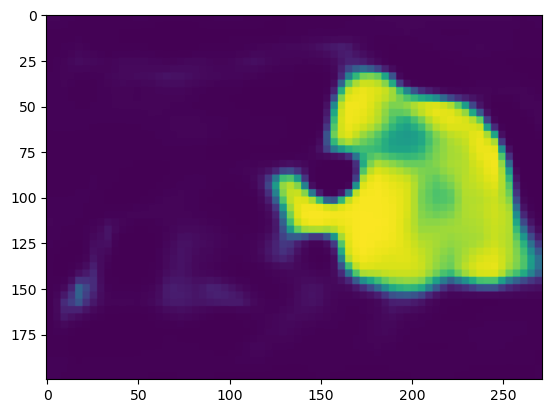

87
tensor([0.0000, 0.0933, 0.0000])


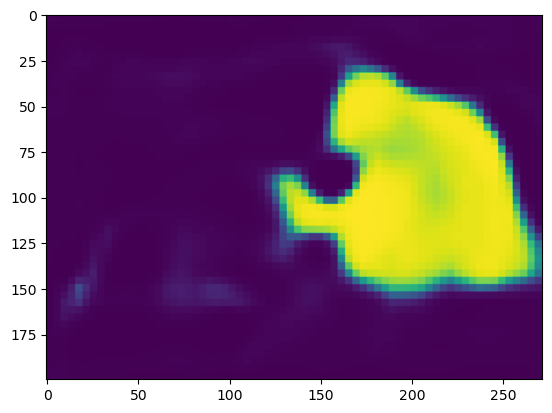

88
tensor([0.0000, 0.7917, 0.0000])


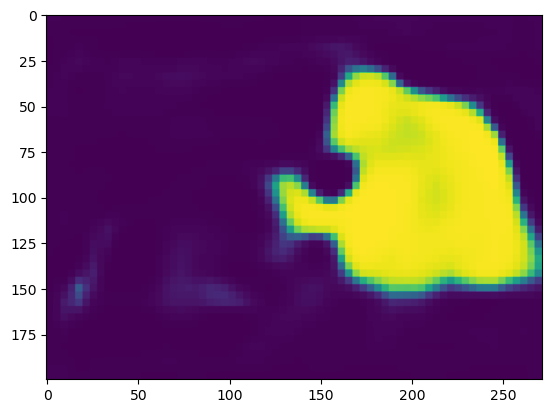

89
tensor([0.0000, 0.9915, 0.0000])


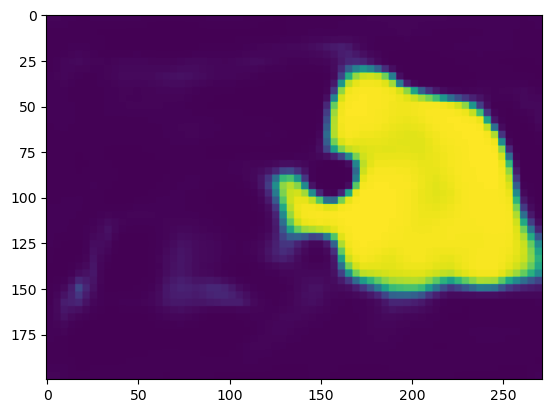

90
tensor([0.0000, 0.9974, 0.0000])


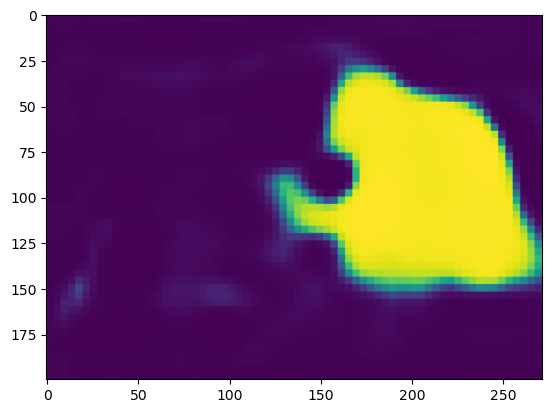

91
tensor([0.0000, 0.9993, 0.0000])


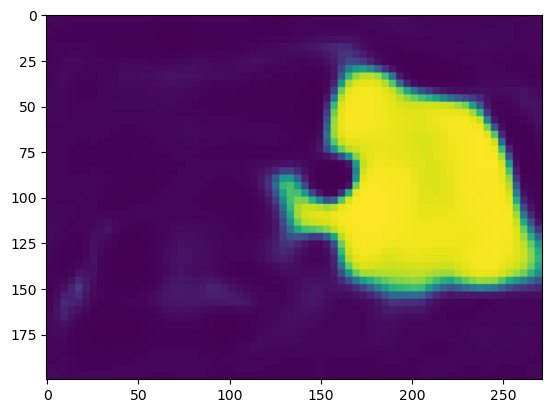

92
tensor([0.0000, 0.9996, 0.0000])


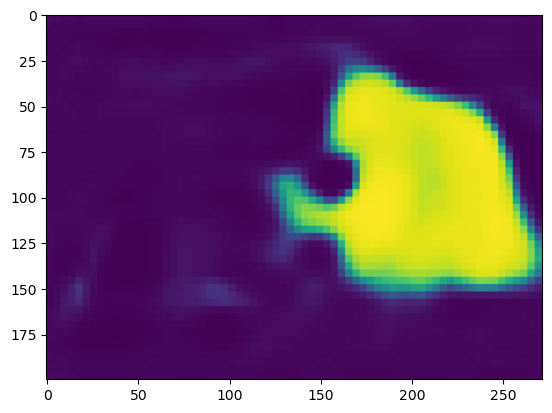

93
tensor([0., 0., 0.])


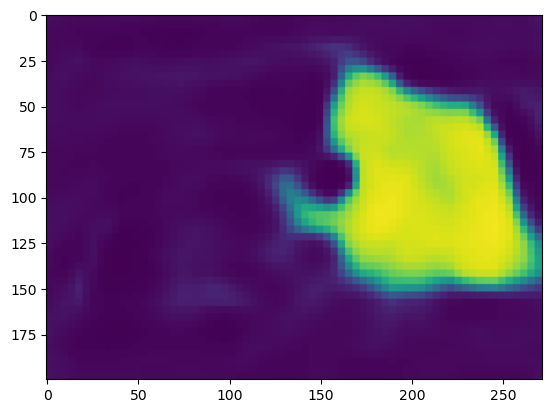

94
tensor([0., 0., 0.])


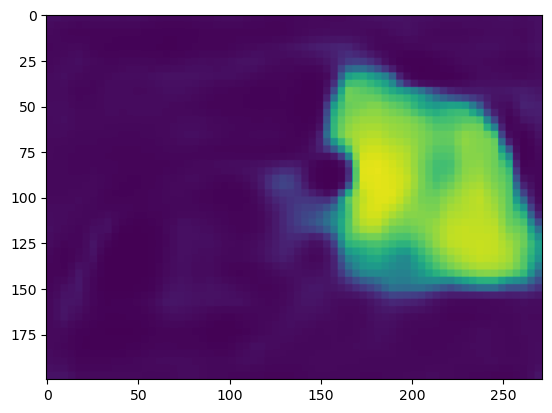

95
tensor([0., 0., 0.])


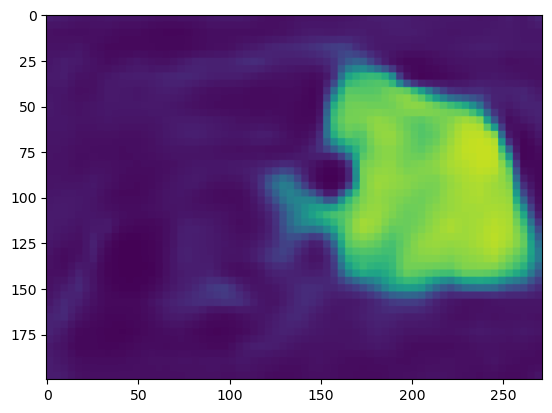

96
tensor([0.0000, 0.0000, 0.6683])


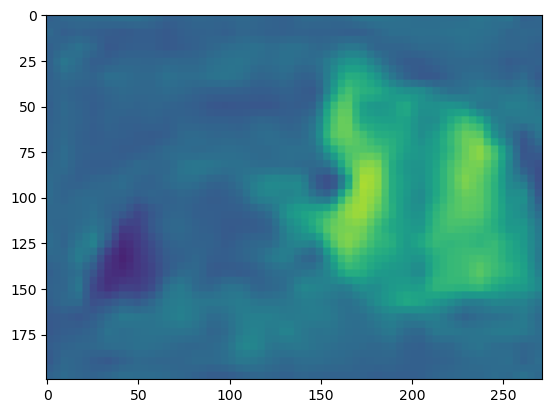

97
tensor([0.0000, 0.0000, 0.8529])


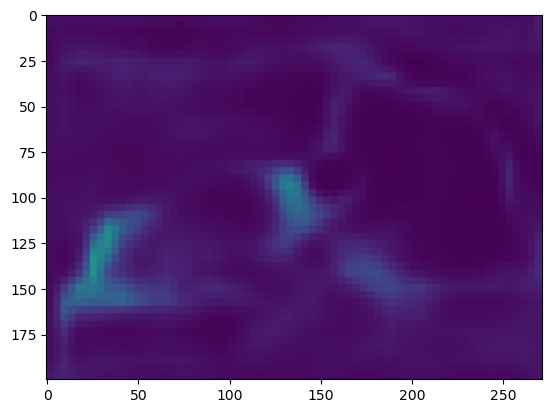

98
tensor([0.0000, 0.0000, 0.9667])


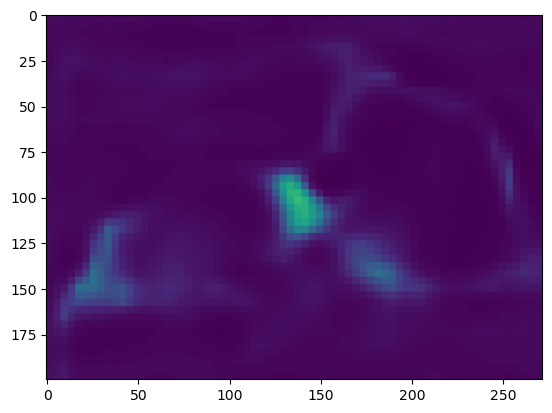

99
tensor([0.0000, 0.0000, 0.9920])


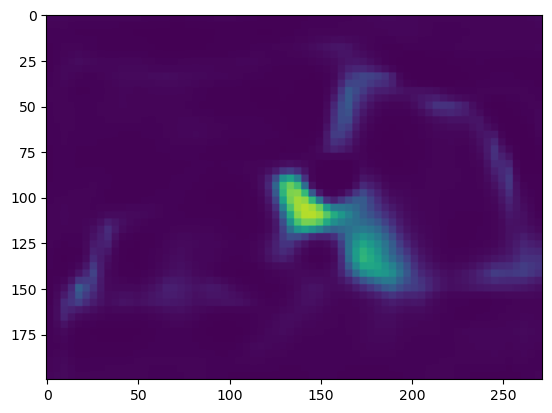

100
tensor([0.0000, 0.0000, 0.9966])


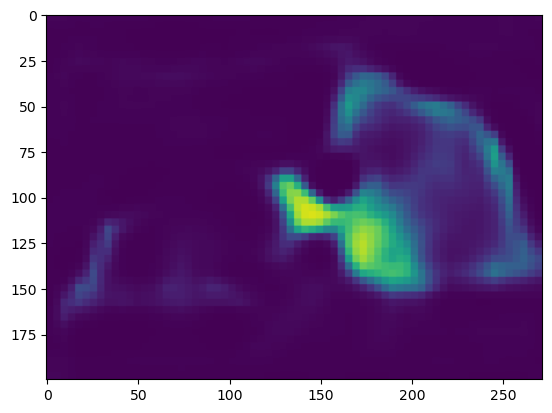

101
tensor([0., 0., 0.])


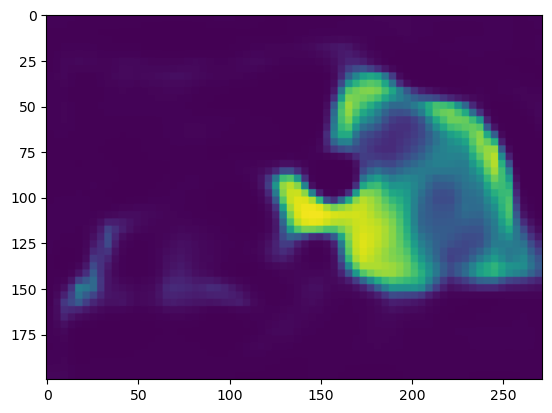

102
tensor([0.0000, 0.0150, 0.0000])


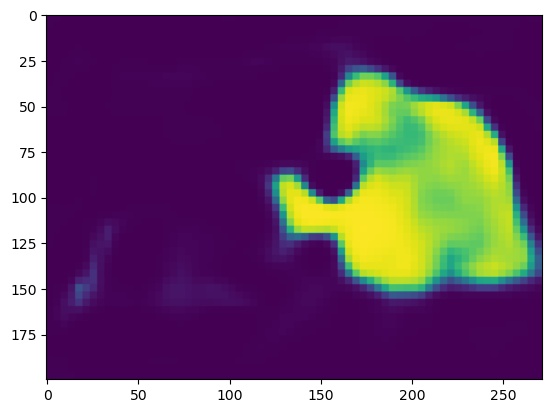

103
tensor([0.0000, 0.2403, 0.0000])


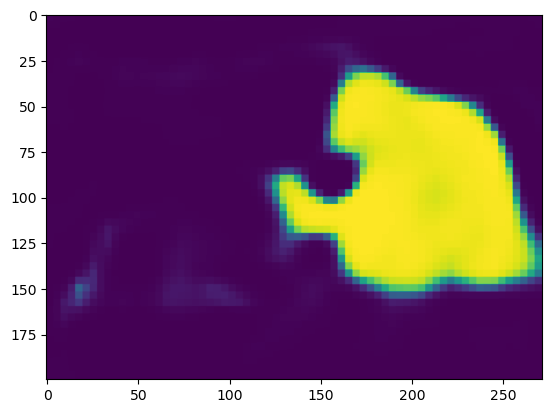

104
tensor([0.0000, 0.9353, 0.0000])


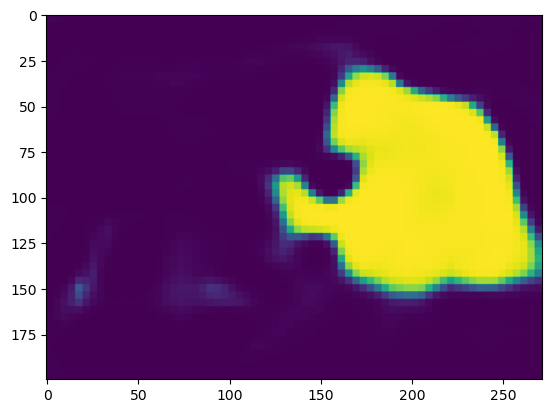

105
tensor([0.0000, 0.9987, 0.0000])


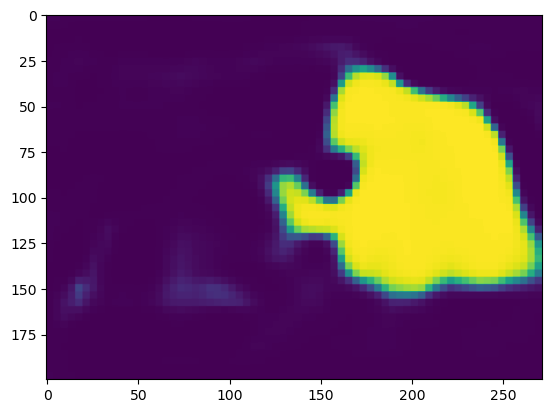

106
tensor([0.0000, 0.9996, 0.0000])


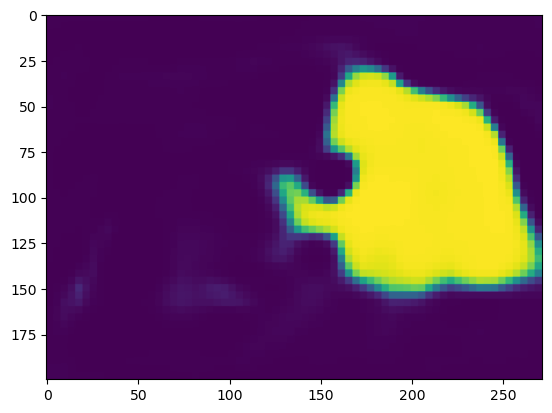

107
tensor([0.0000, 0.9998, 0.0000])


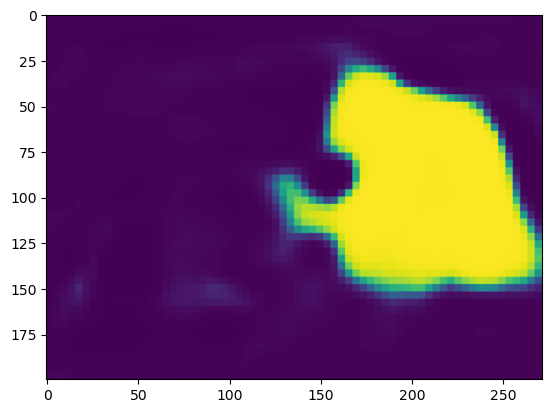

108
tensor([0., 0., 0.])


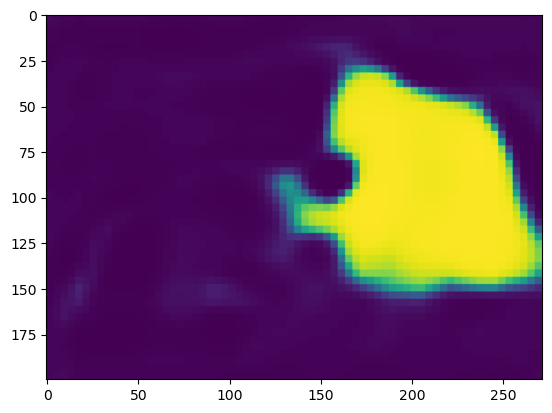

109
tensor([0.0010, 0.0000, 0.0000])


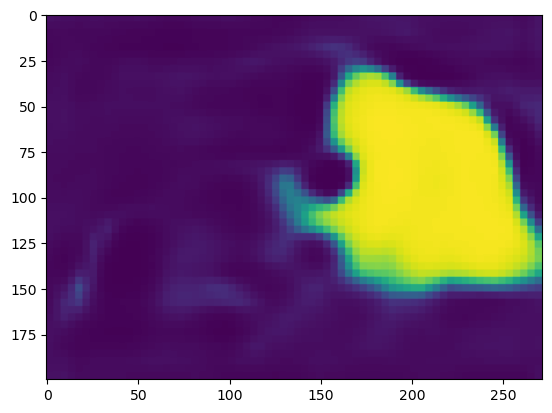

110
tensor([0.0059, 0.0000, 0.0000])


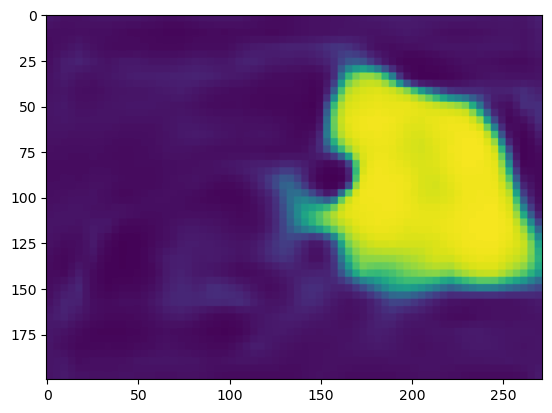

111
tensor([0.1189, 0.0000, 0.0000])


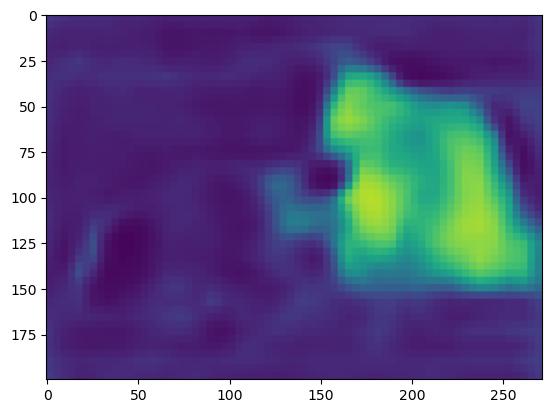

112
tensor([0.0000, 0.0000, 0.8182])


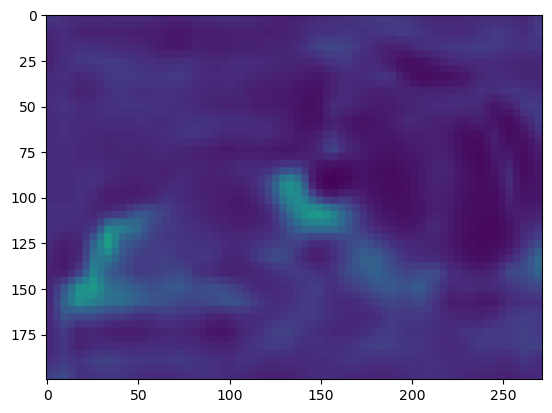

113
tensor([0.0000, 0.0000, 0.9591])


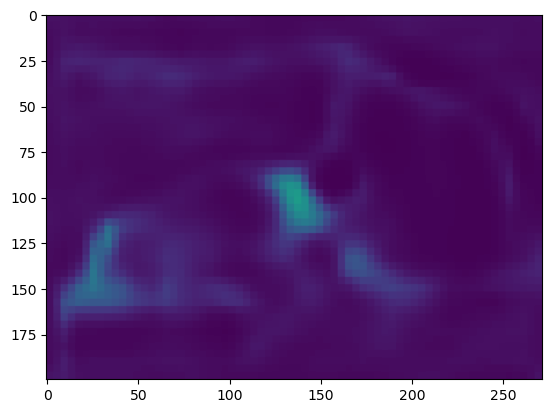

114
tensor([0.0000, 0.0000, 0.9901])


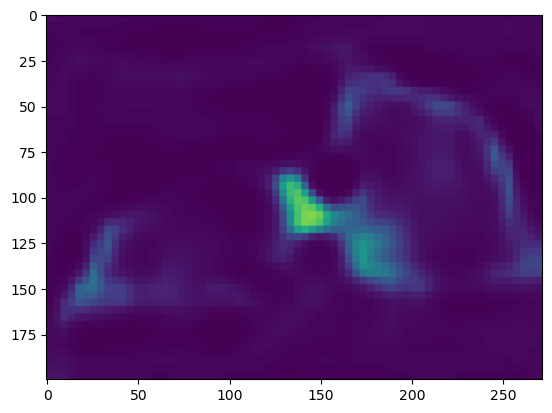

115
tensor([0.0000, 0.0000, 0.9969])


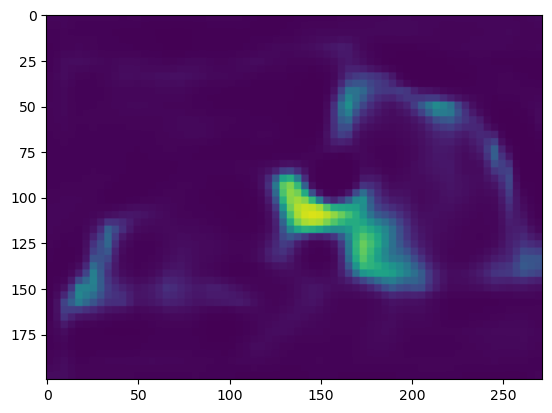

116
tensor([0., 0., 0.])


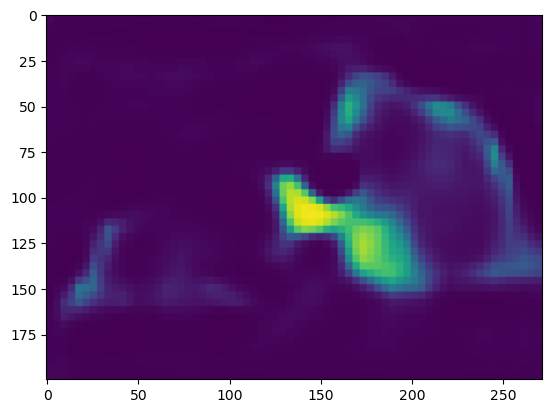

117
tensor([0., 0., 0.])


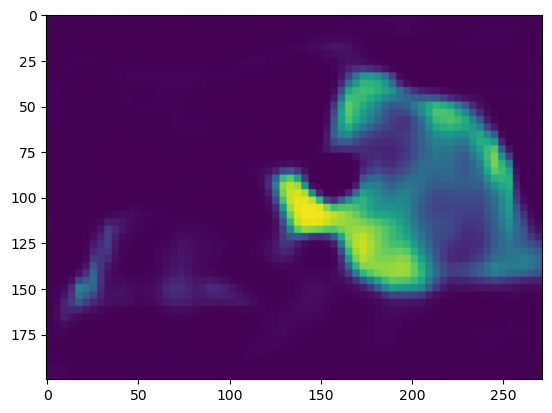

118
tensor([0.0131, 0.0000, 0.0000])


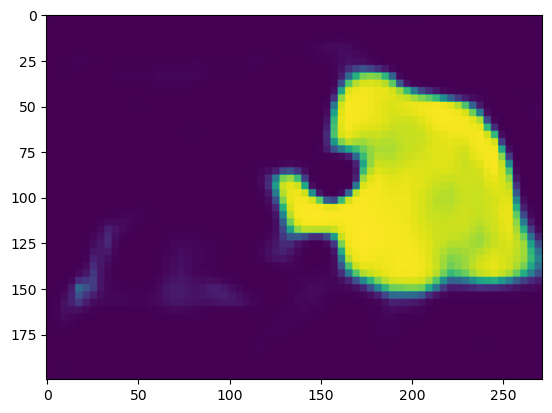

119
tensor([0.0138, 0.2598, 0.0000])


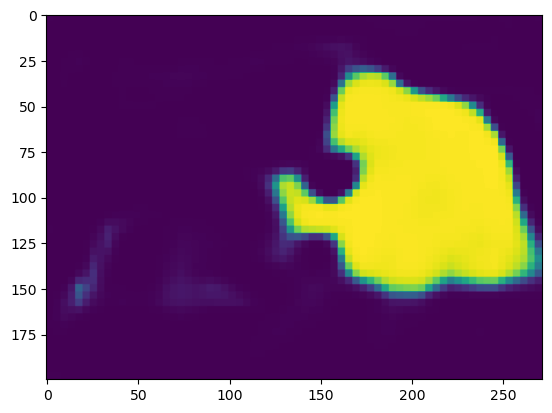

120
tensor([0.0000, 0.9735, 0.0000])


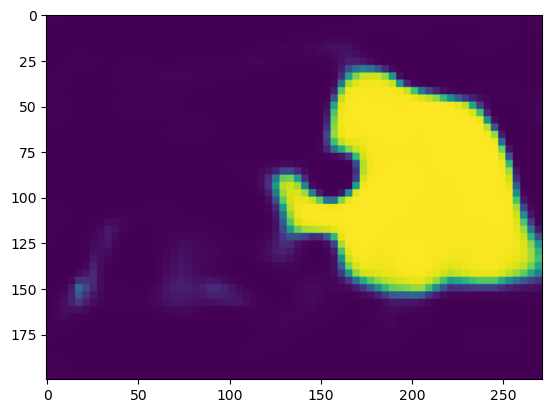

121
tensor([0.0000, 0.9994, 0.0000])


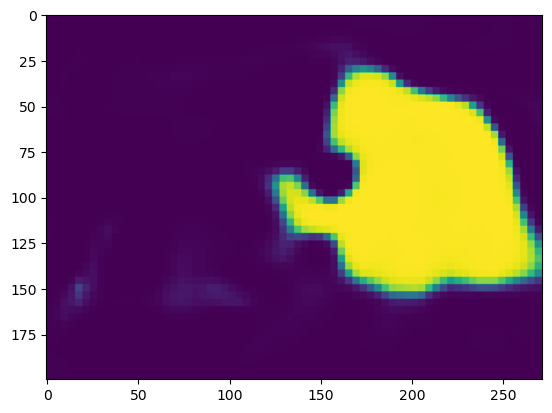

122
tensor([0., 0., 0.])


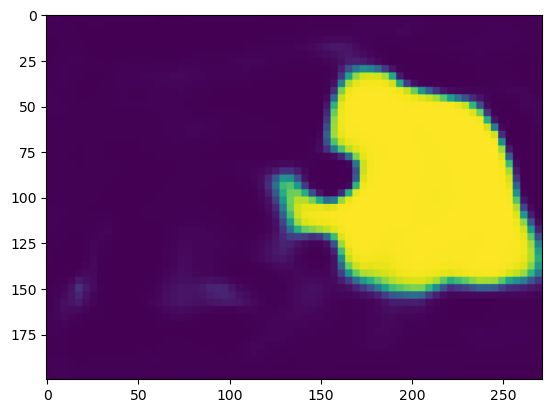

123
tensor([0.0000, 0.9998, 0.0000])


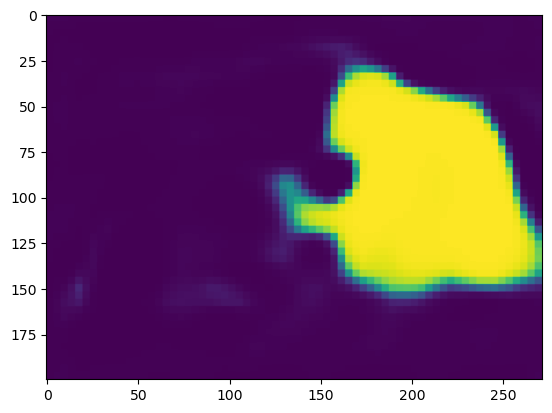

124
tensor([0., 0., 0.])


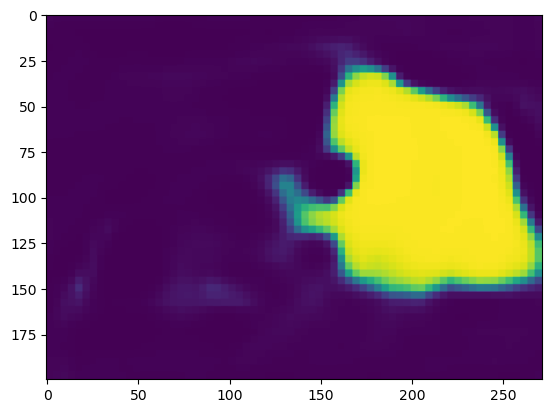

125
tensor([0.0013, 0.0000, 0.0000])


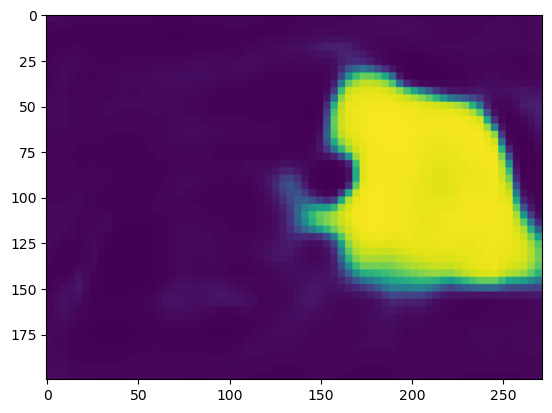

126
tensor([0.0086, 0.0000, 0.0000])


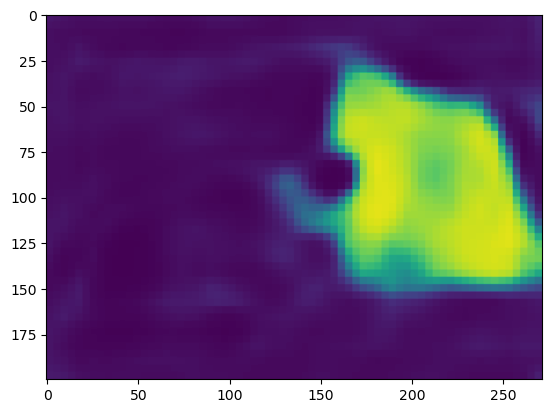

127
tensor([0., 0., 0.])


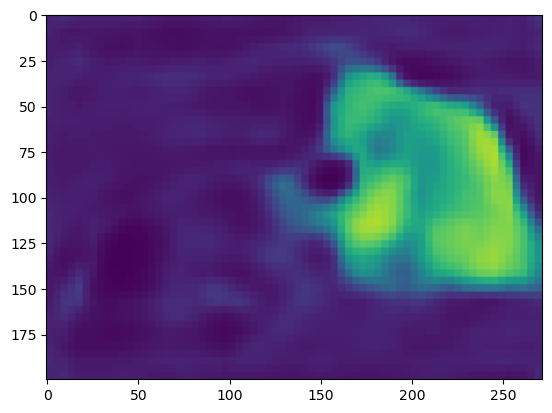

128
tensor([0.0000, 0.0000, 0.9073])


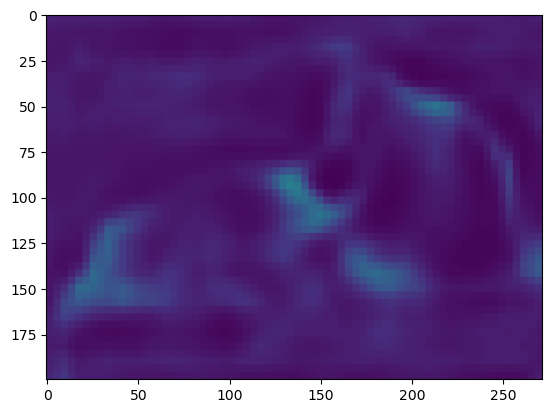

129
tensor([0.0000, 0.0000, 0.9837])


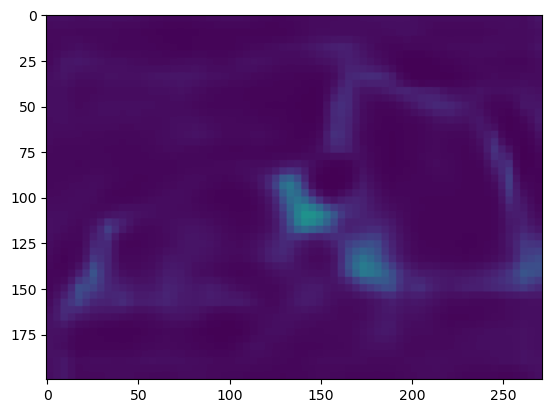

130
tensor([0.0000, 0.0000, 0.9929])


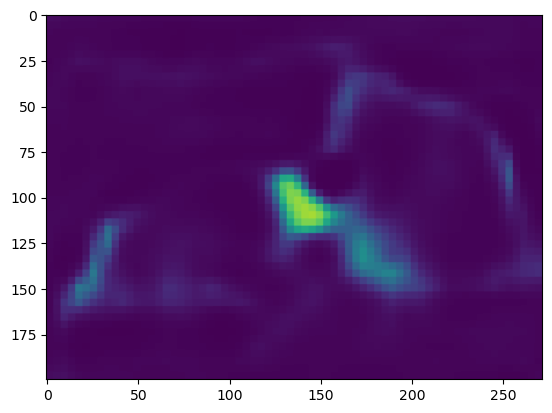

131
tensor([0., 0., 0.])


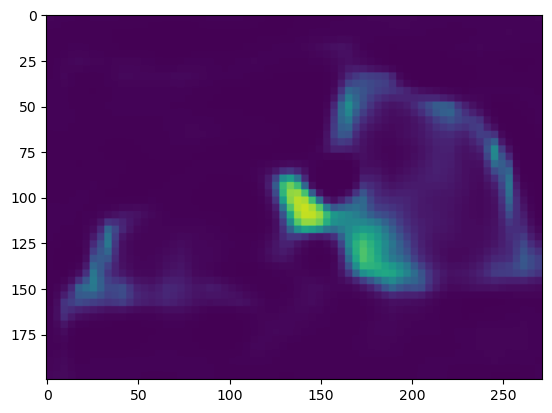

132
tensor([0., 0., 0.])


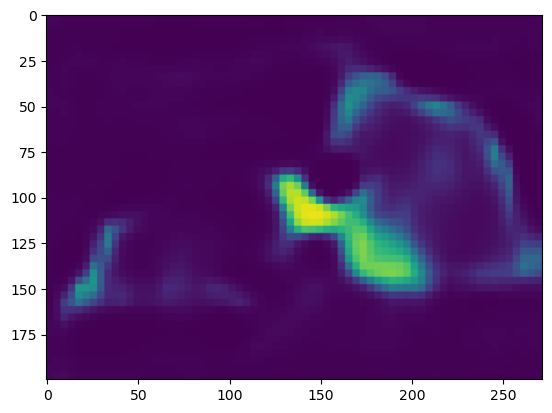

133
tensor([0.0083, 0.0000, 0.0000])


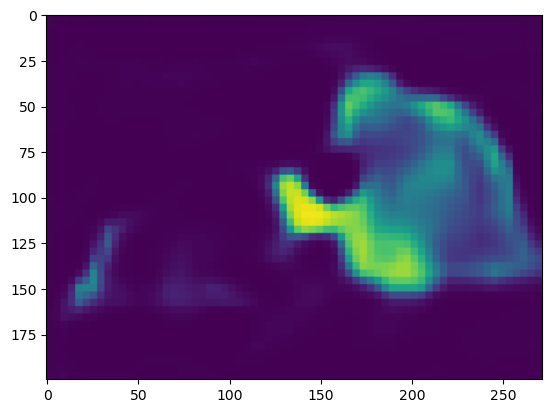

134
tensor([0.0241, 0.0164, 0.0000])


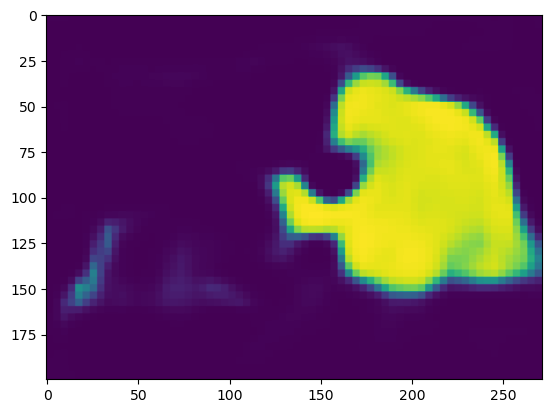

135
tensor([0.0000, 0.4871, 0.0000])


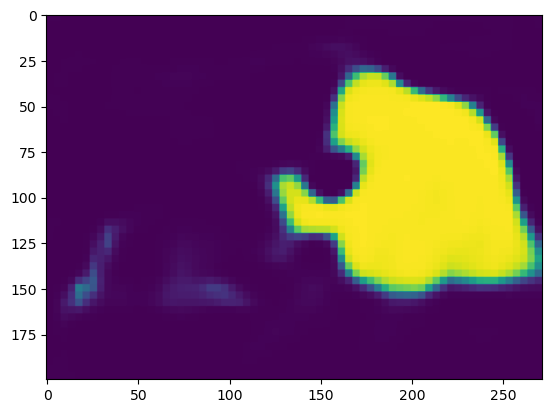

136
tensor([0.0000, 0.9887, 0.0000])


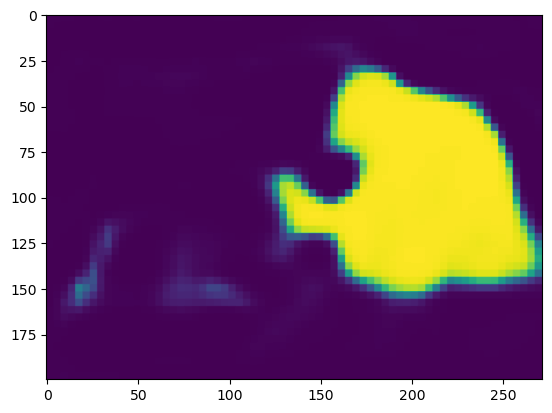

137
tensor([0.0000, 0.9994, 0.0000])


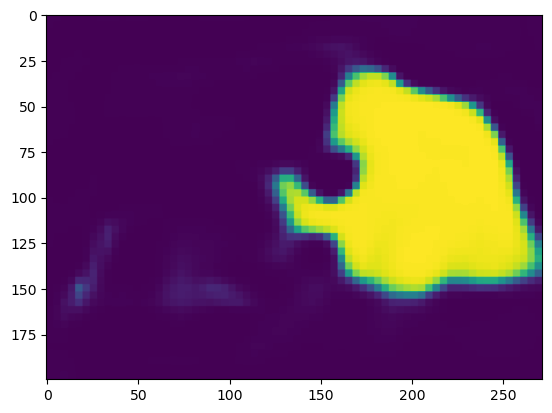

138
tensor([0., 0., 0.])


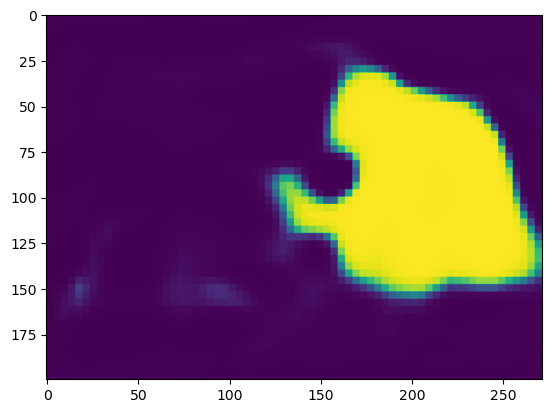

139
tensor([0.0012, 0.0000, 0.0000])


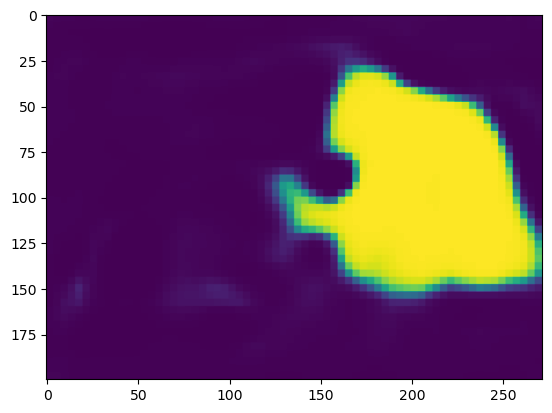

140
tensor([0., 0., 0.])


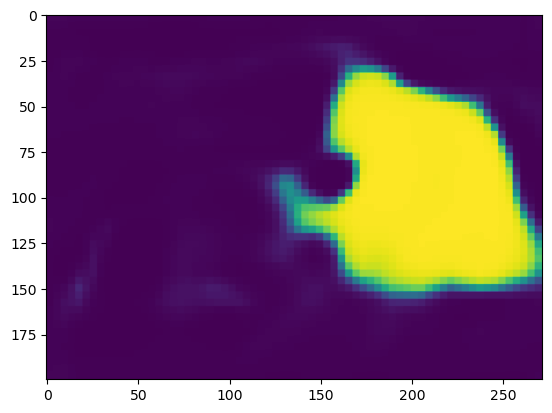

141
tensor([0.0030, 0.0000, 0.0010])


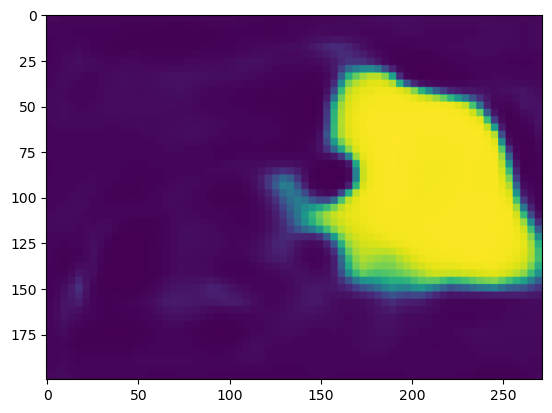

142
tensor([0.0187, 0.0000, 0.0017])


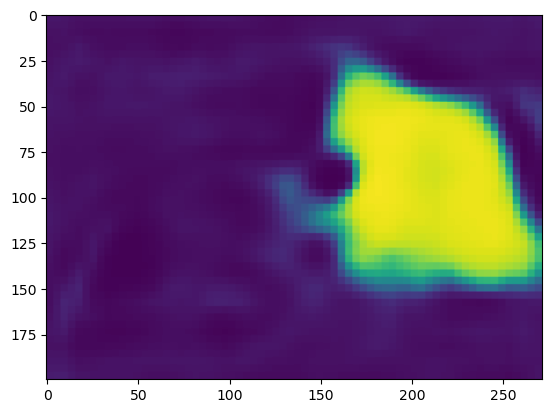

143
tensor([0.1596, 0.0000, 0.0398])


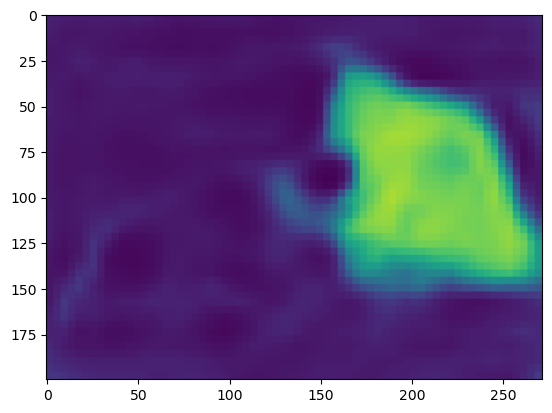

144
tensor([0.0578, 0.0000, 0.9178])


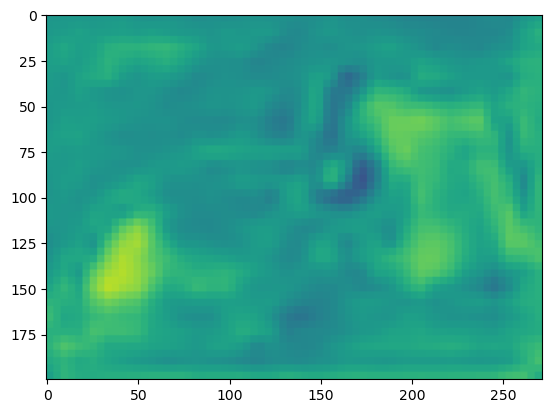

145
tensor([0.0000, 0.0000, 0.9882])


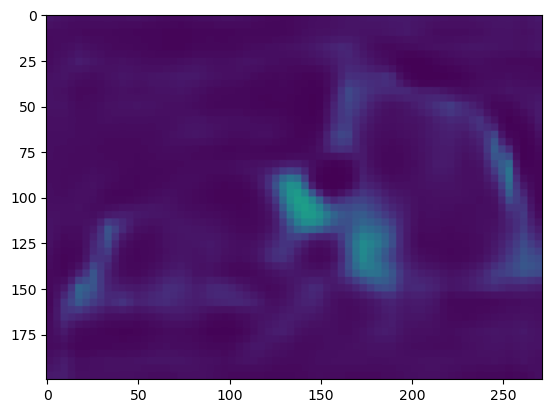

146
tensor([0.0000, 0.0000, 0.9959])


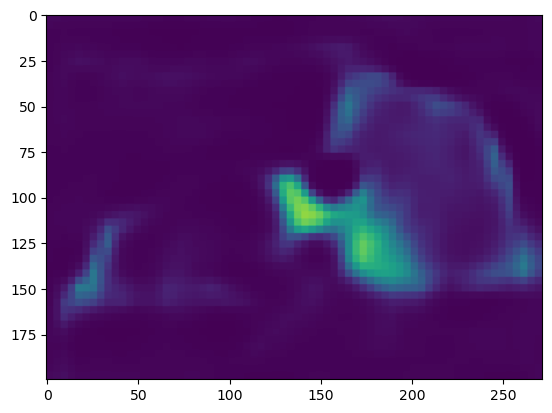

147
tensor([0.0072, 0.0000, 0.0000])


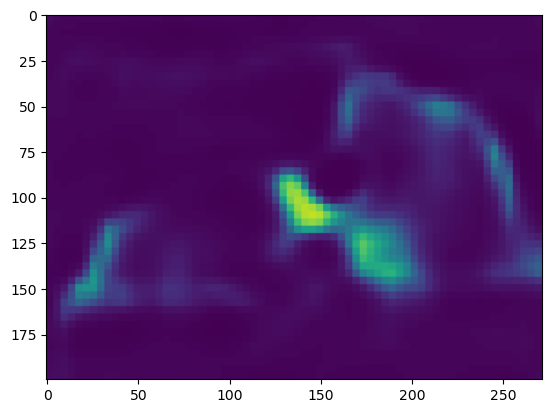

148
tensor([0.0090, 0.0015, 0.0000])


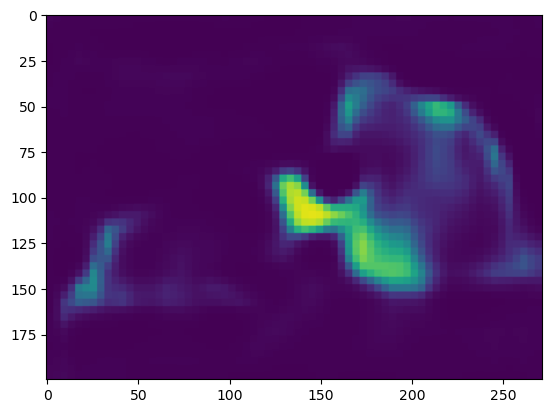

149
tensor([0.0293, 0.0027, 0.0000])


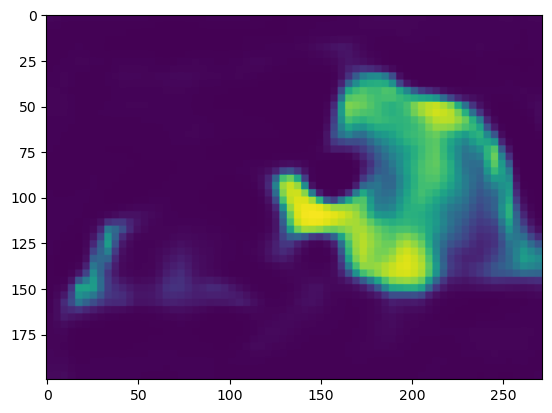

150
tensor([0.0839, 0.0262, 0.0000])


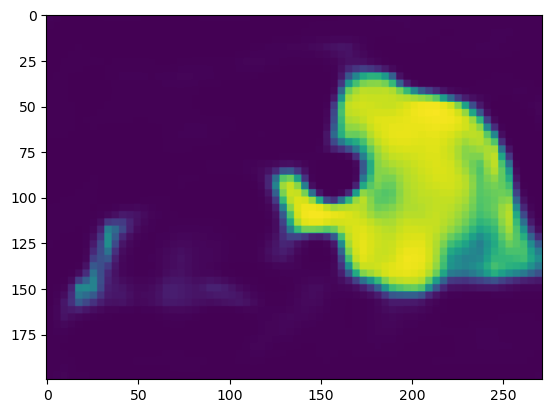

151
tensor([0.0000, 0.6895, 0.0000])


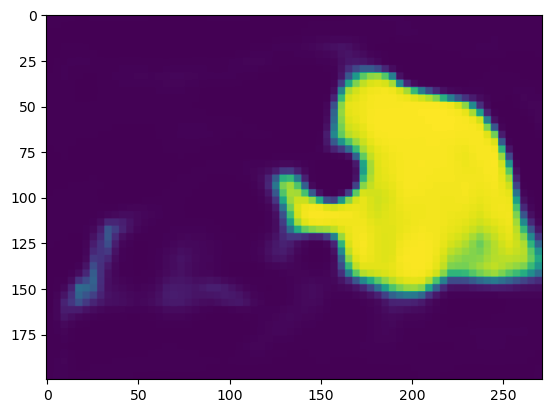

152
tensor([0., 0., 0.])


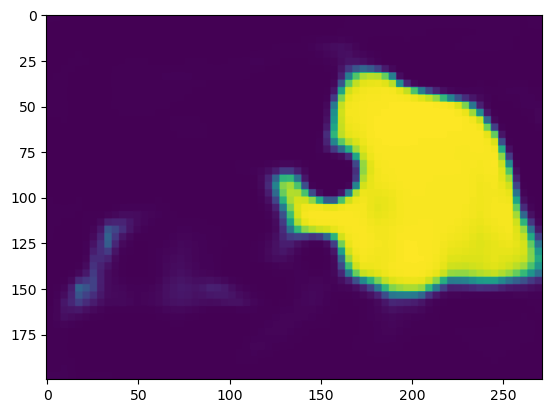

153
tensor([0., 0., 0.])


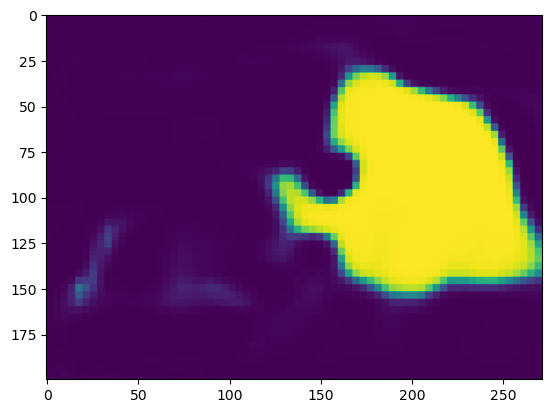

154
tensor([0., 0., 0.])


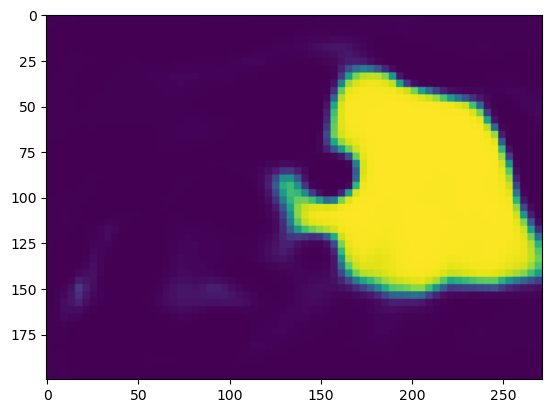

155
tensor([0.0018, 0.0000, 0.0021])


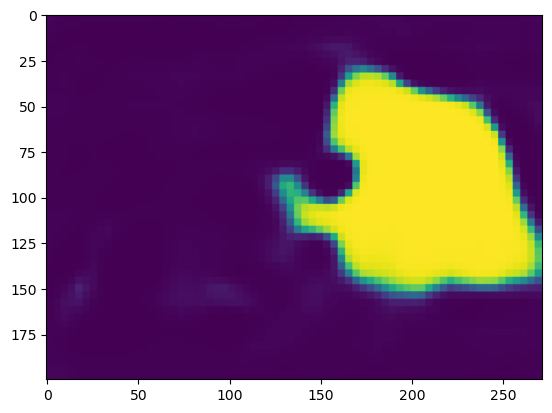

156
tensor([0.0022, 0.0000, 0.0000])


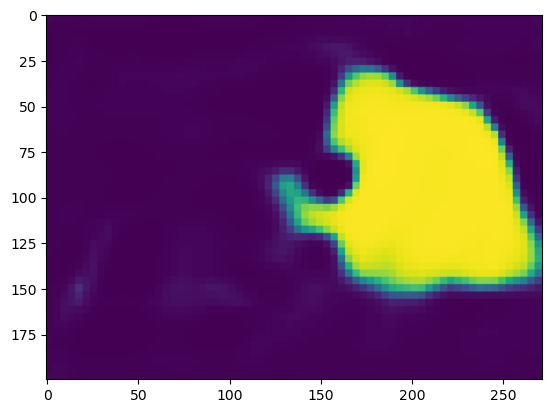

157
tensor([0.0050, 0.0000, 0.0000])


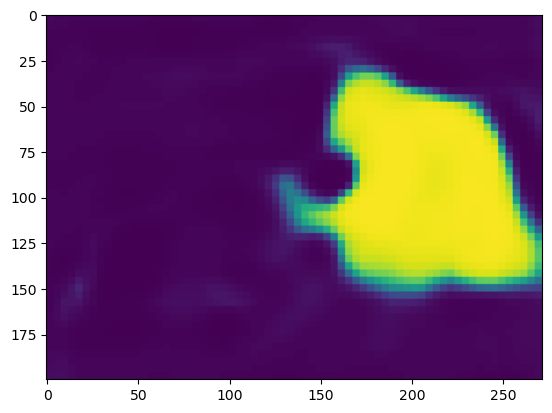

158
tensor([0.0306, 0.0000, 0.0021])


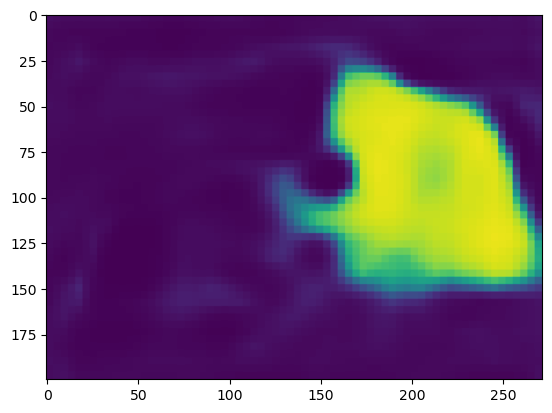

159
tensor([0.2318, 0.0000, 0.0490])


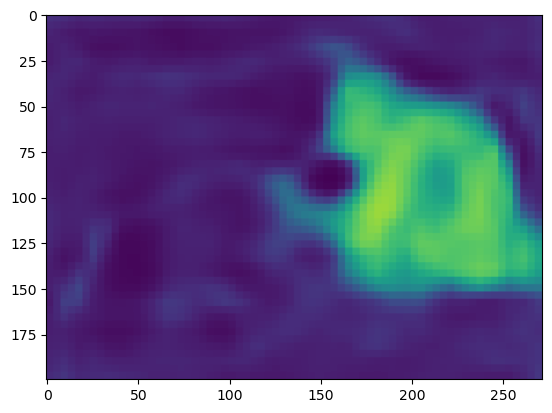

160
tensor([0.0852, 0.0000, 0.0000])


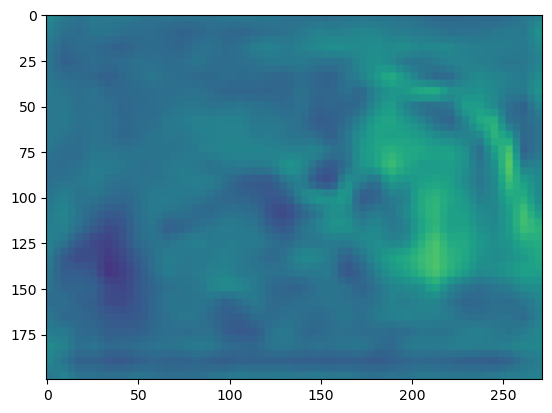

161
tensor([0., 0., 0.])


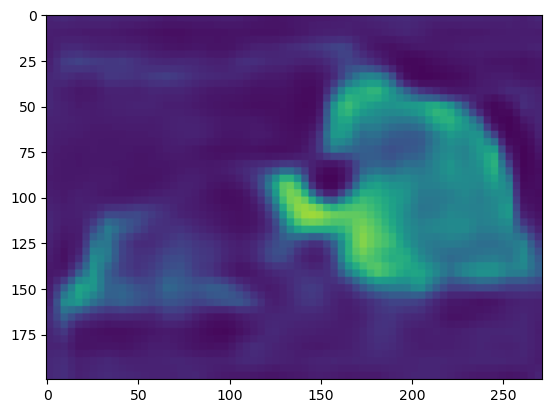

162
tensor([0., 0., 0.])


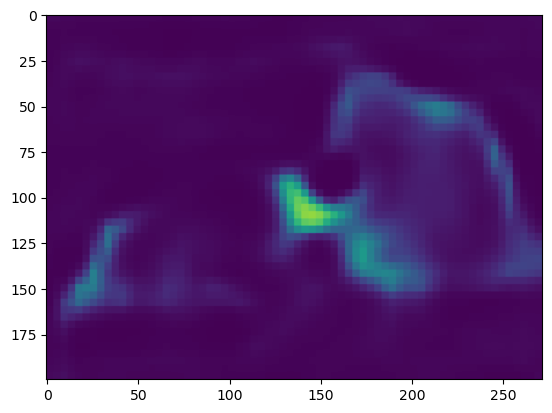

163
tensor([0., 0., 0.])


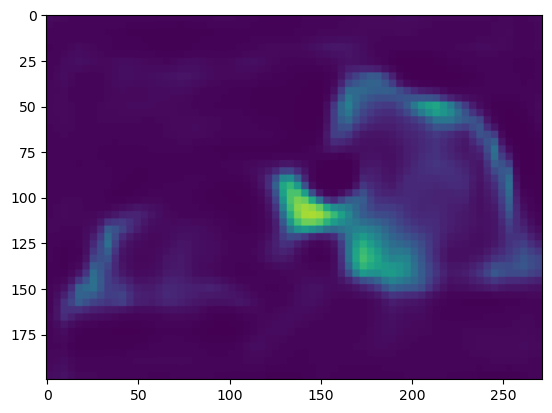

164
tensor([0.0461, 0.0032, 0.0000])


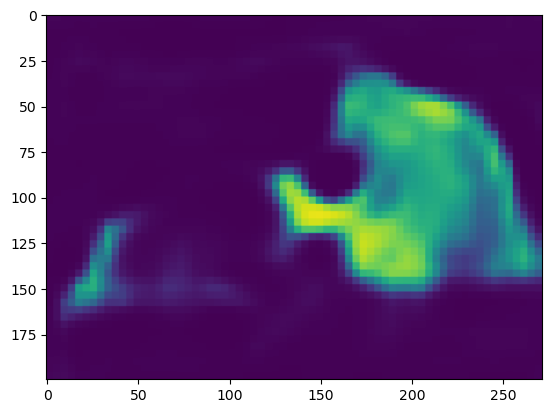

165
tensor([0.0852, 0.0068, 0.0000])


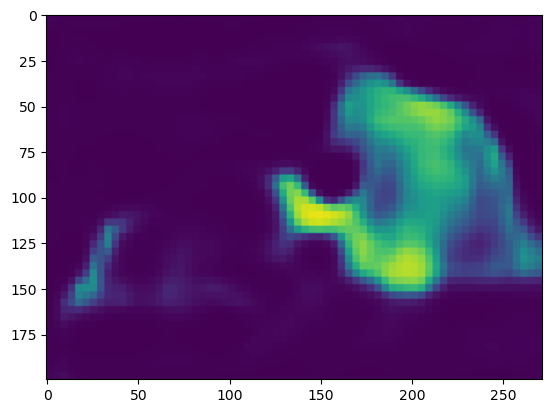

166
tensor([0.1719, 0.0295, 0.0000])


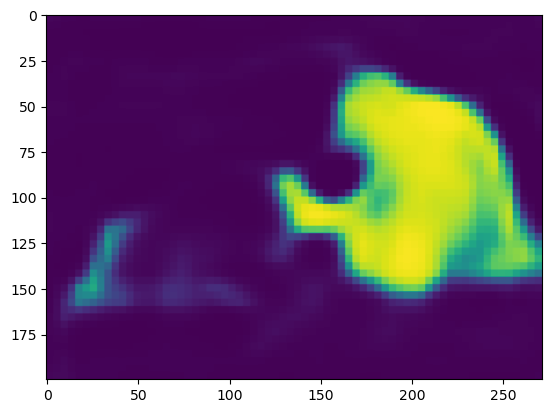

167
tensor([0., 0., 0.])


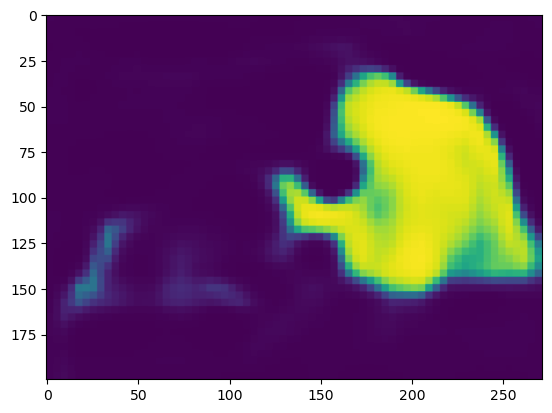

168
tensor([0., 0., 0.])


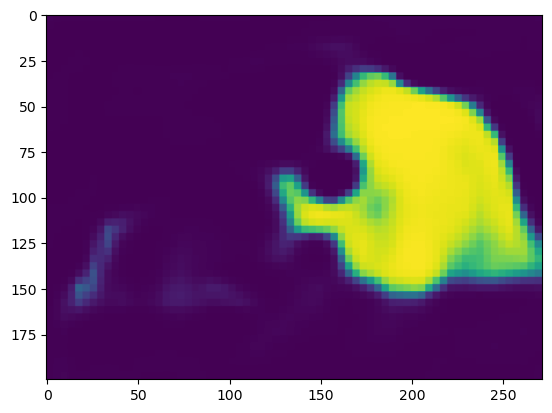

169
tensor([0., 0., 0.])


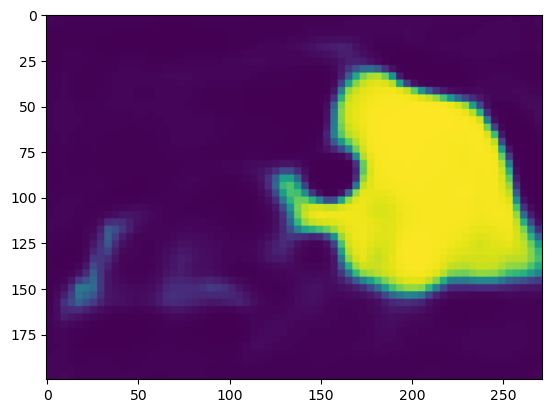

170
tensor([0.0000, 0.0000, 0.0088])


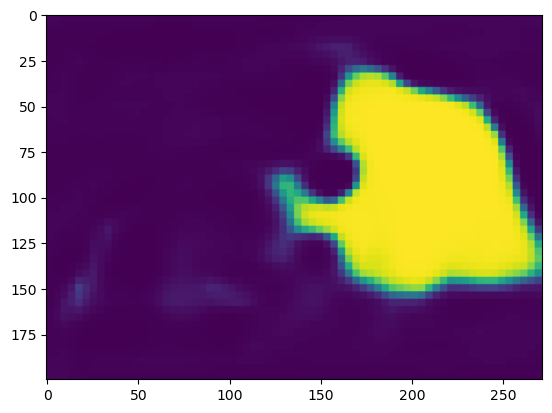

171
tensor([0.0077, 0.0000, 0.0093])


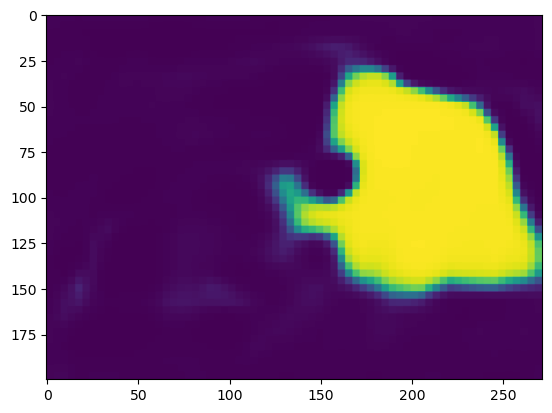

172
tensor([0.0173, 0.0000, 0.0000])


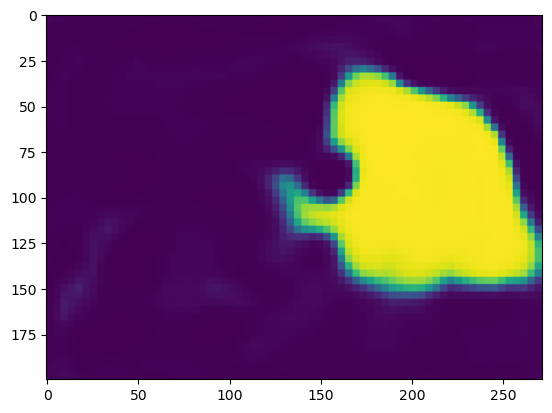

173
tensor([0.0000, 0.0000, 0.0033])


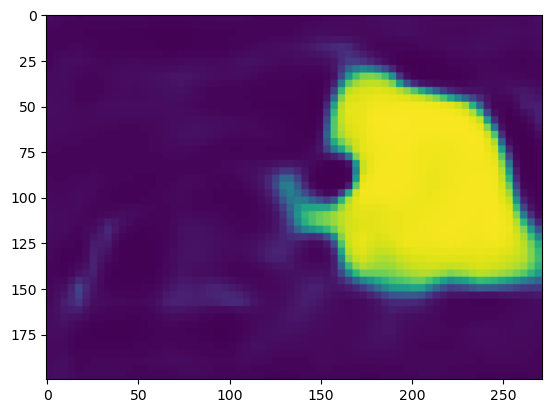

174
tensor([0.0694, 0.0000, 0.0050])


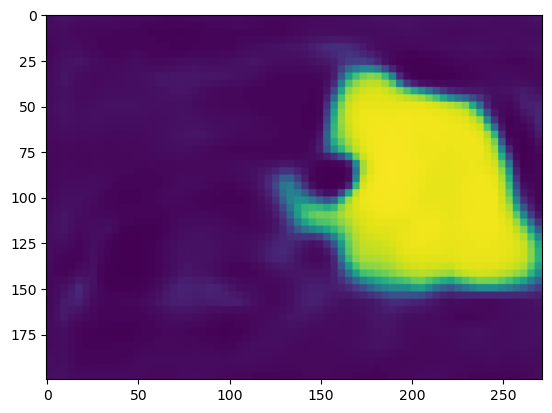

175
tensor([0.2870, 0.0000, 0.0832])


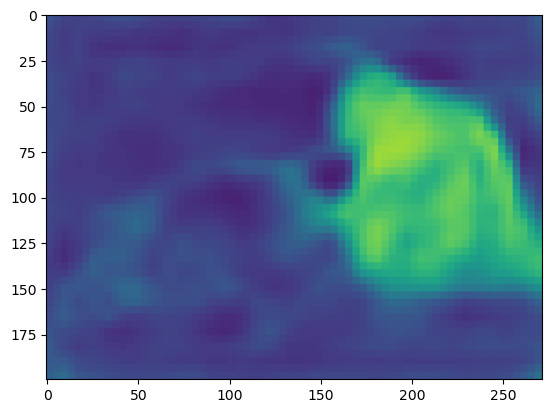

176
tensor([0.1925, 0.0580, 0.0000])


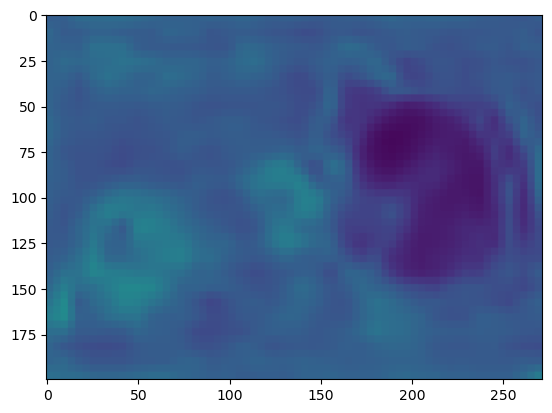

177
tensor([0., 0., 0.])


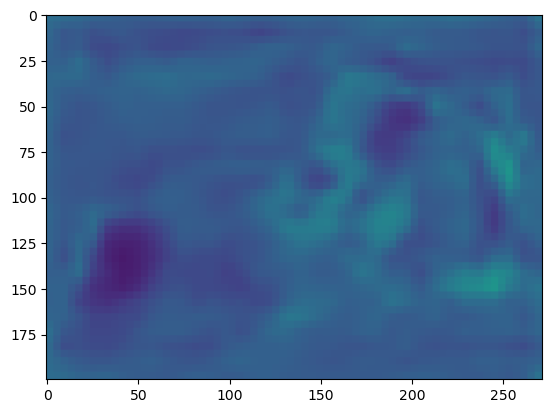

178
tensor([0.1434, 0.0000, 0.0000])


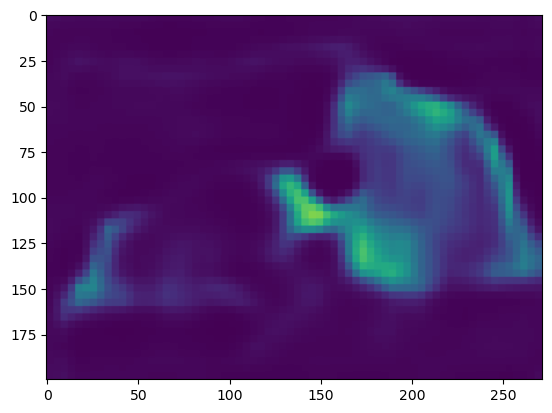

179
tensor([0.2269, 0.0034, 0.0000])


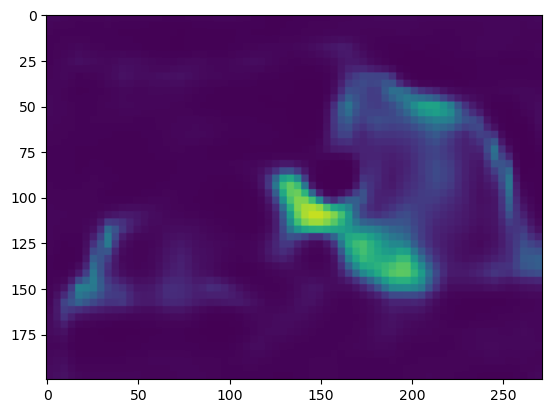

180
tensor([0.5422, 0.0064, 0.0000])


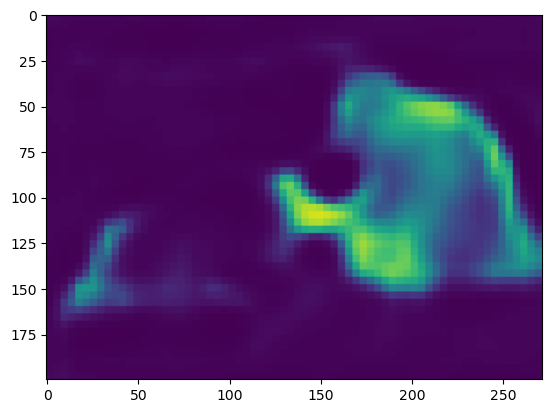

181
tensor([0.6290, 0.0122, 0.0000])


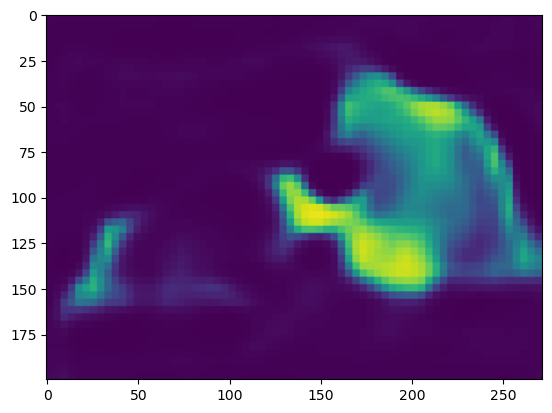

182
tensor([0.0000, 0.0460, 0.0000])


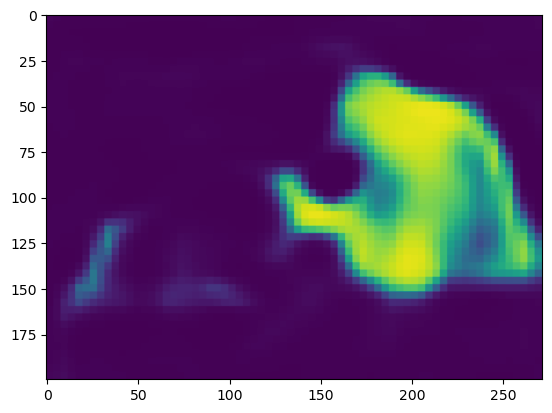

183
tensor([0.6457, 0.0000, 0.0000])


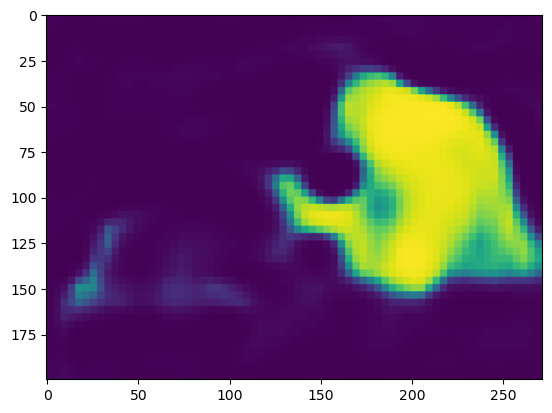

184
tensor([0., 0., 0.])


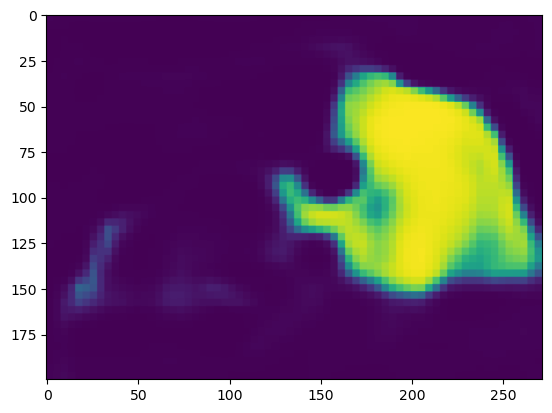

185
tensor([0., 0., 0.])


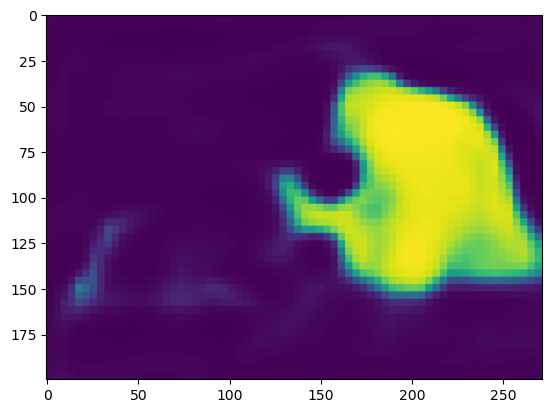

186
tensor([0.0000, 0.0000, 0.0119])


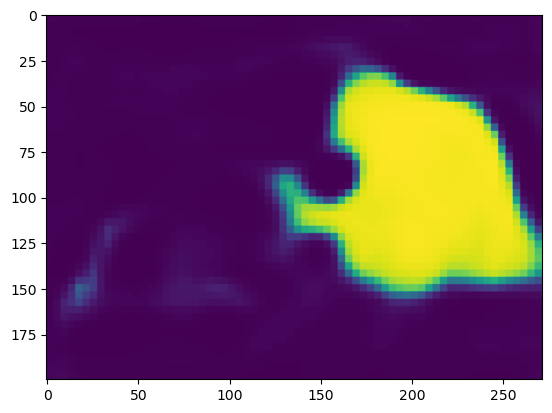

187
tensor([0.1689, 0.0000, 0.0000])


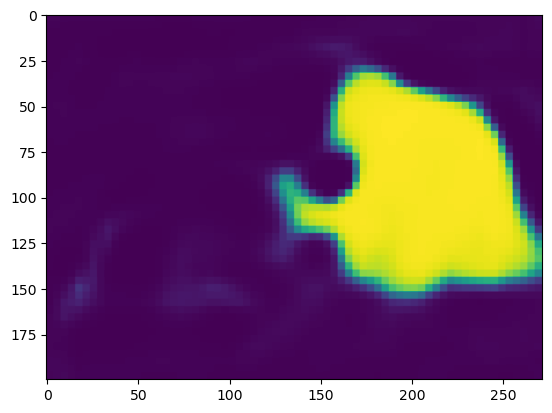

188
tensor([0., 0., 0.])


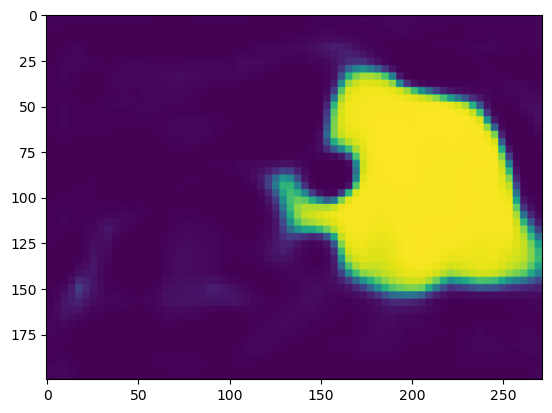

189
tensor([0., 0., 0.])


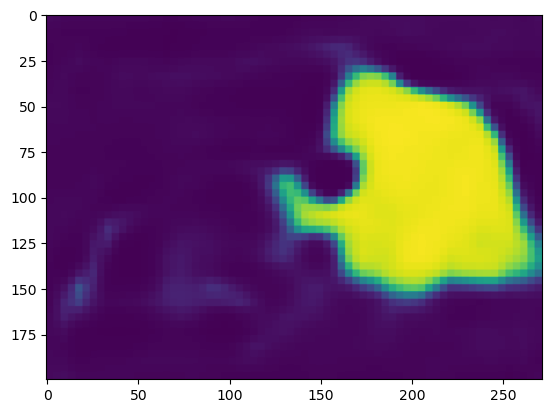

190
tensor([0.1733, 0.0000, 0.0094])


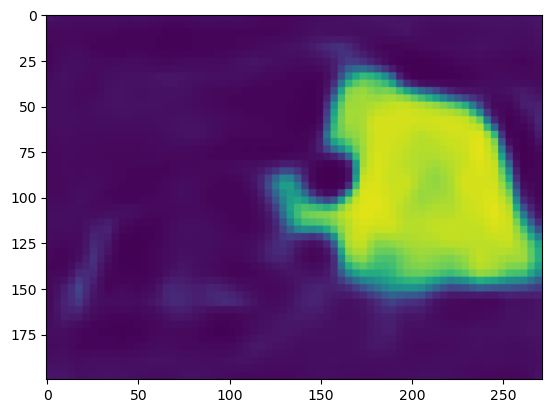

191
tensor([0.2959, 0.0000, 0.1229])


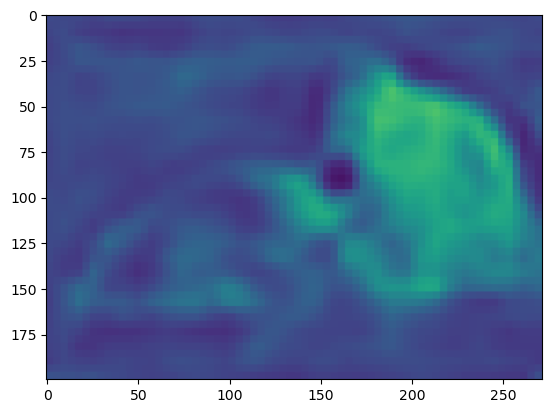

192
tensor([0.3165, 0.0000, 0.0000])


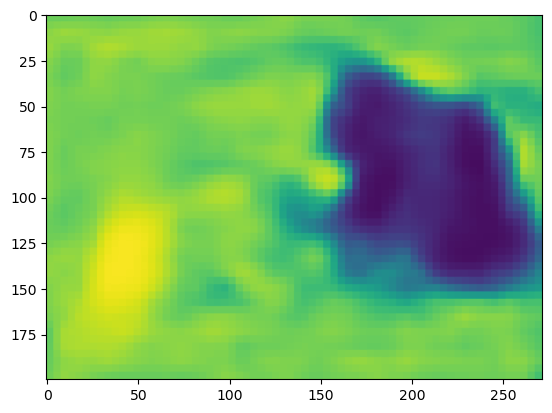

193
tensor([0.3915, 0.0000, 0.0000])


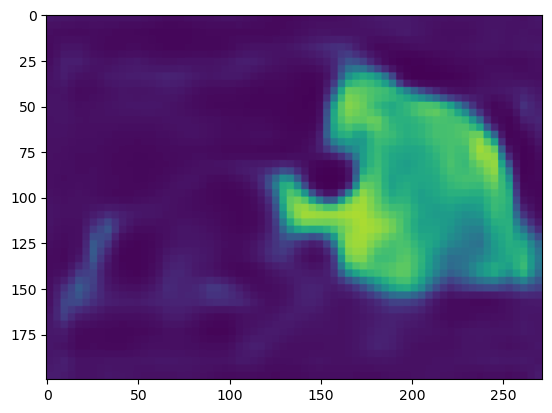

194
tensor([0.5506, 0.0000, 0.0000])


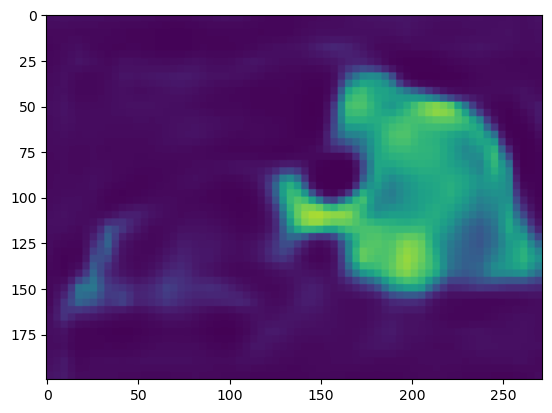

195
tensor([0.8581, 0.0046, 0.0000])


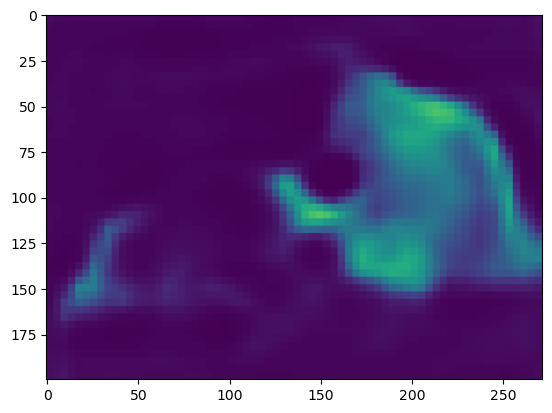

196
tensor([0.9150, 0.0067, 0.0000])


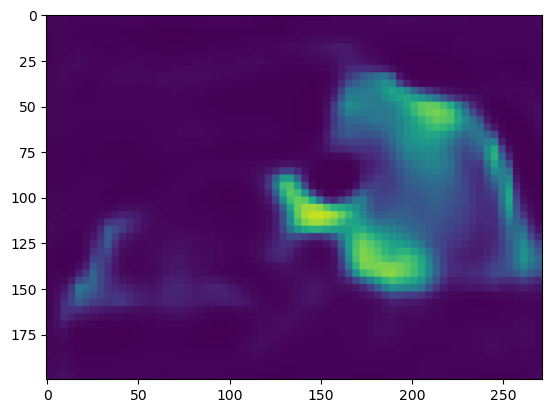

197
tensor([0.0000, 0.0200, 0.0000])


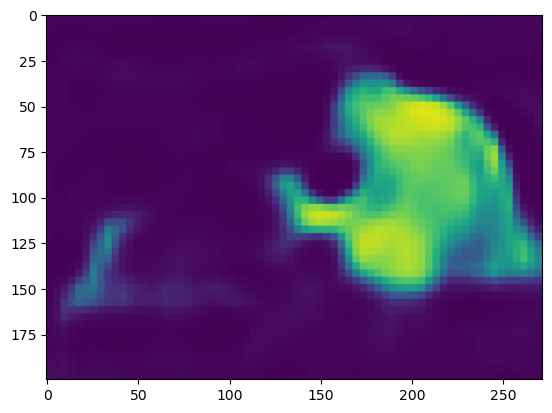

198
tensor([0.0000, 0.0483, 0.0000])


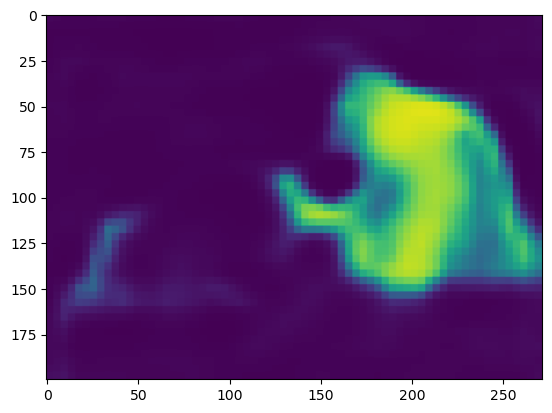

199
tensor([0.9215, 0.0000, 0.0000])


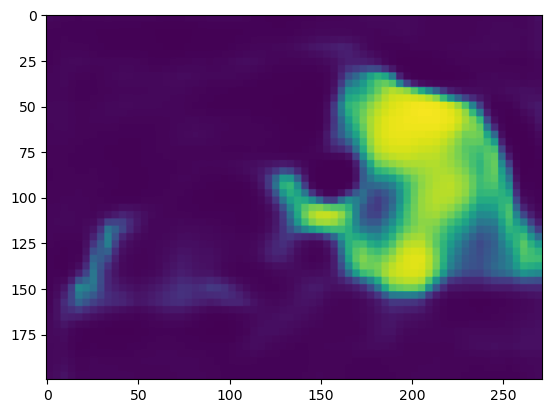

200
tensor([0., 0., 0.])


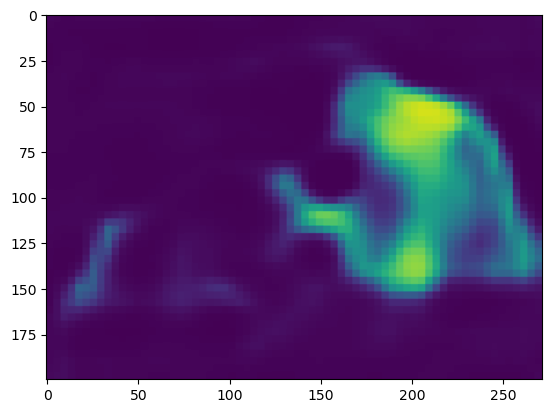

201
tensor([0., 0., 0.])


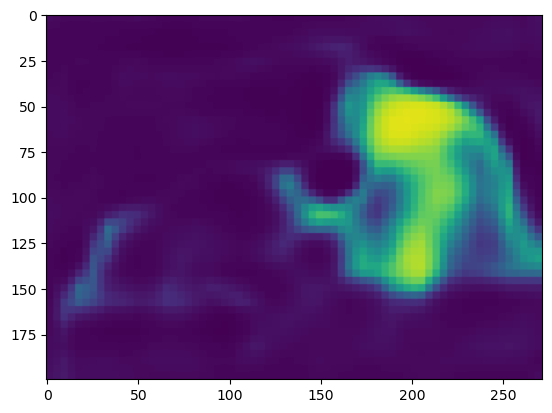

202
tensor([0., 0., 0.])


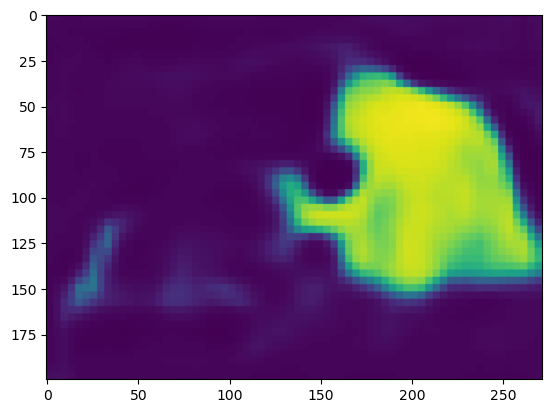

203
tensor([0., 0., 0.])


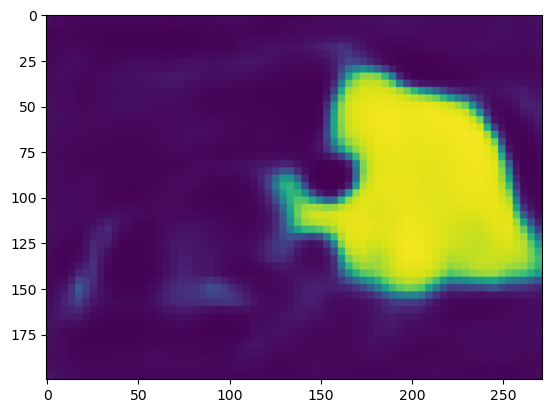

204
tensor([0.0000, 0.0000, 0.0188])


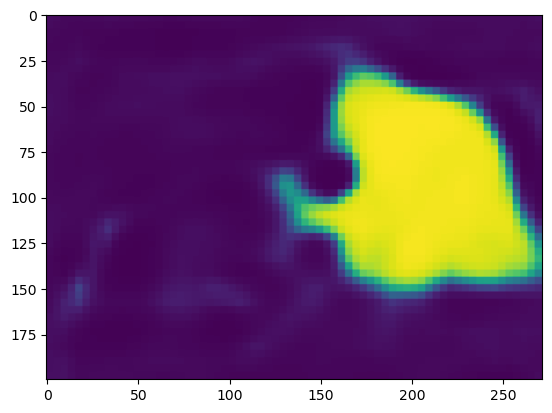

205
tensor([0., 0., 0.])


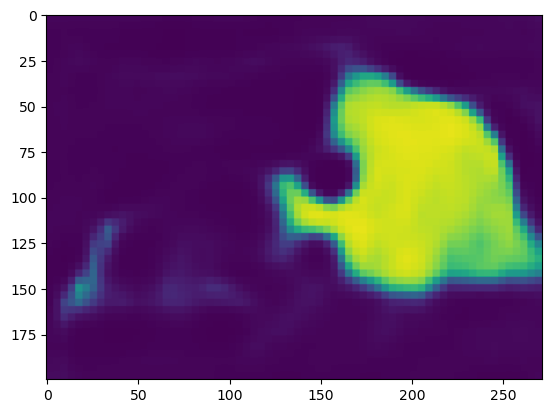

206
tensor([0.4776, 0.0000, 0.0273])


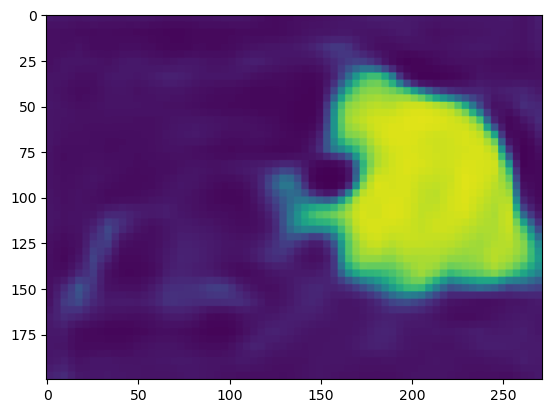

207
tensor([0., 0., 0.])


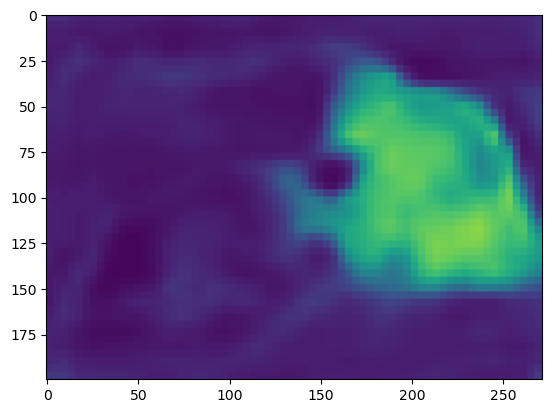

208
tensor([0.5426, 0.0701, 0.0000])


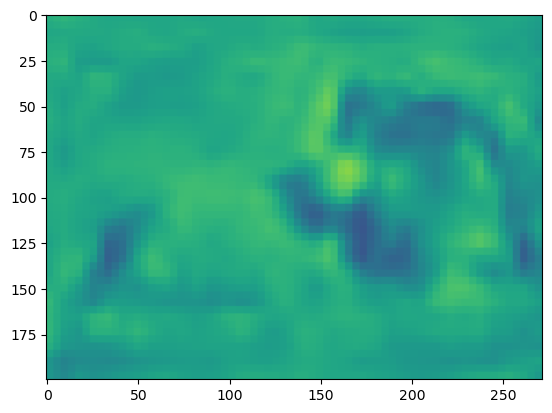

209
tensor([0.8012, 0.0000, 0.0000])


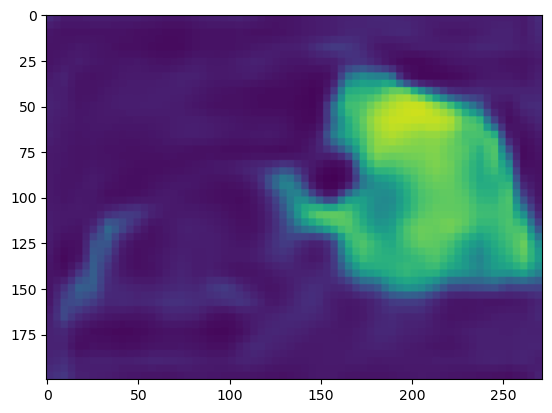

210
tensor([0.9567, 0.0000, 0.0000])


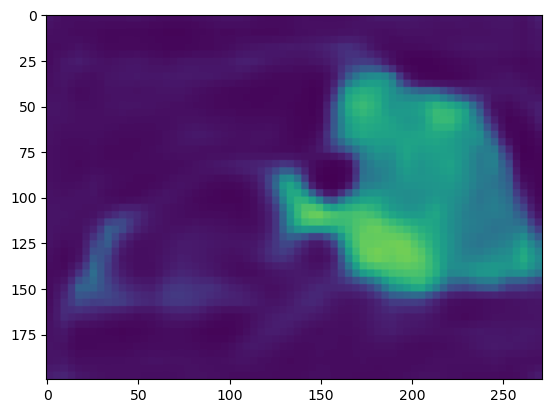

211
tensor([0.9718, 0.0000, 0.0000])


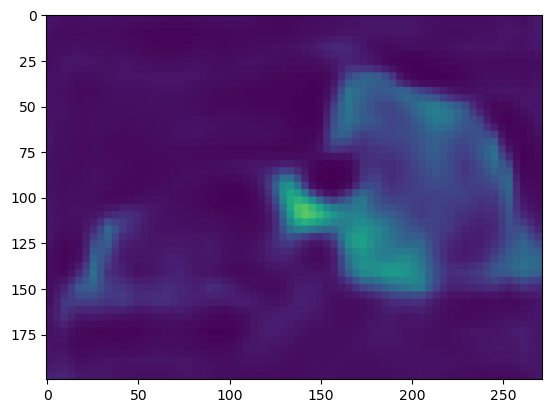

212
tensor([0.0000, 0.0167, 0.0000])


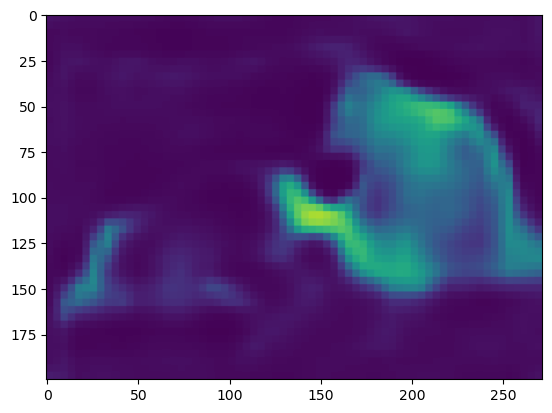

213
tensor([0.0000, 0.0426, 0.0000])


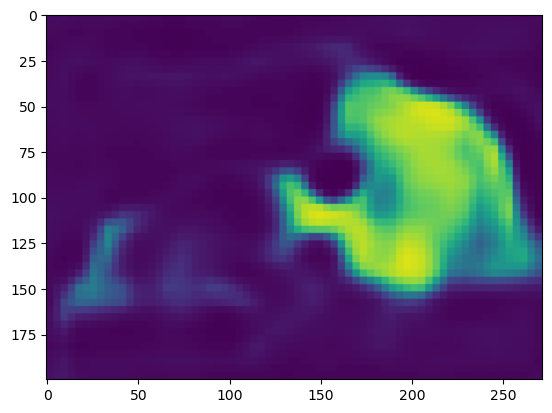

214
tensor([0.0000, 0.0531, 0.0000])


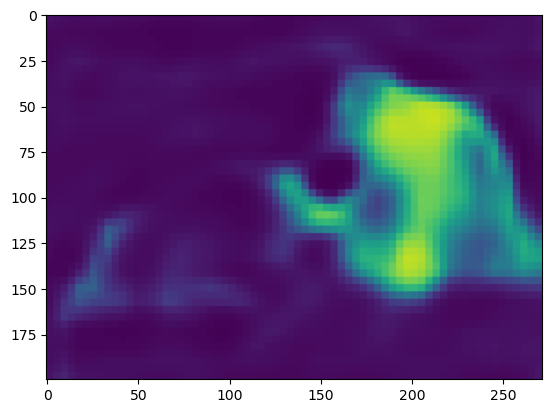

215
tensor([0.9658, 0.0000, 0.0000])


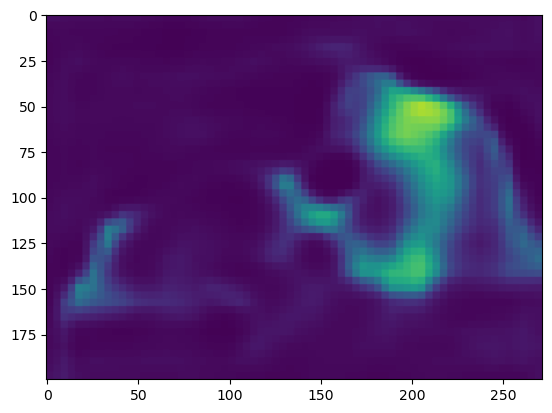

216
tensor([0., 0., 0.])


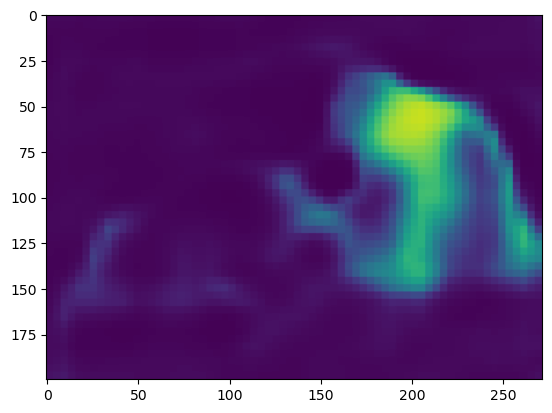

217
tensor([0.9822, 0.0000, 0.0000])


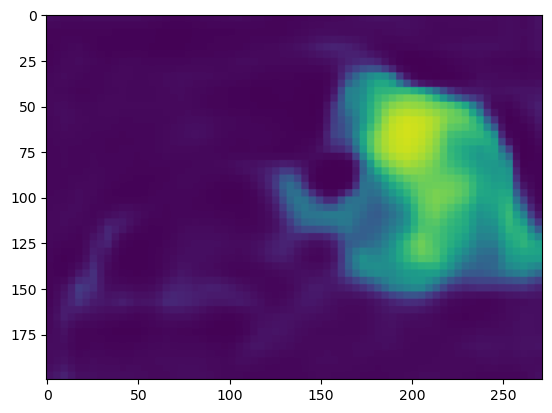

218
tensor([0., 0., 0.])


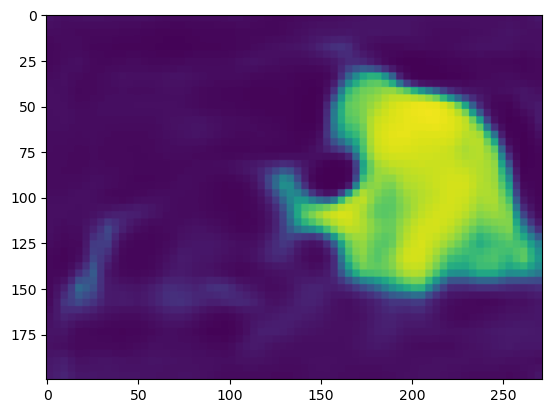

219
tensor([0.9726, 0.0000, 0.0000])


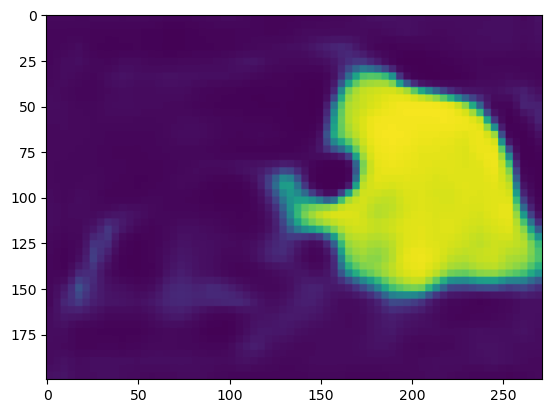

220
tensor([0., 0., 0.])


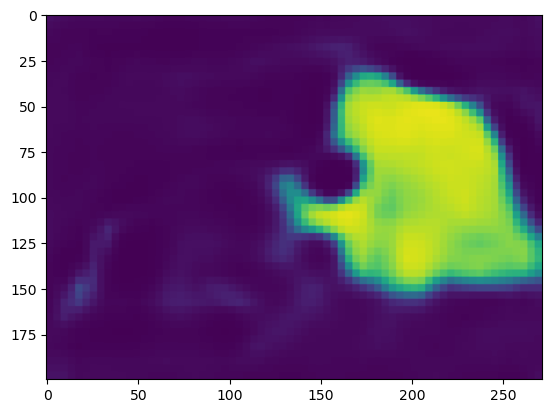

221
tensor([0., 0., 0.])


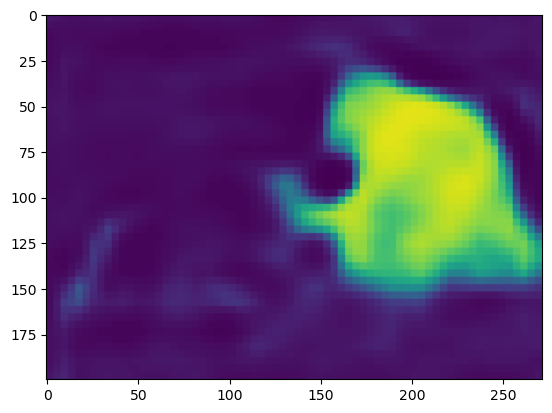

222
tensor([0.0000, 0.0000, 0.0338])


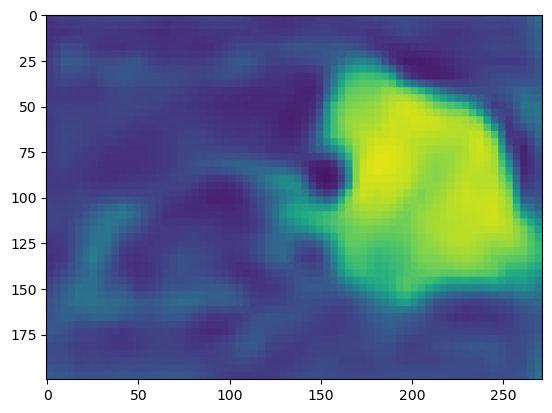

223
tensor([0.0000, 0.0000, 0.1673])


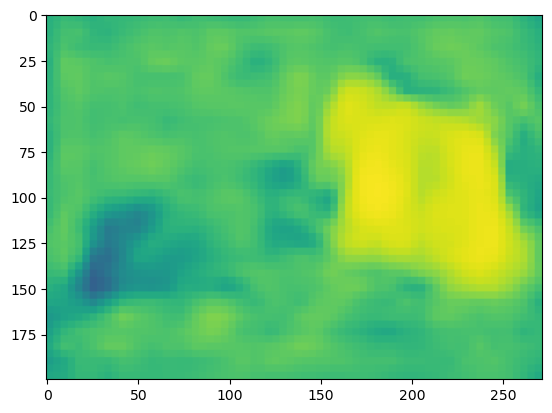

224
tensor([0.6160, 0.0846, 0.0000])


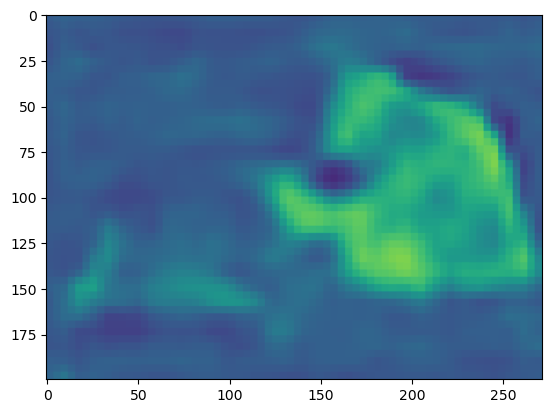

225
tensor([0.9031, 0.0000, 0.0000])


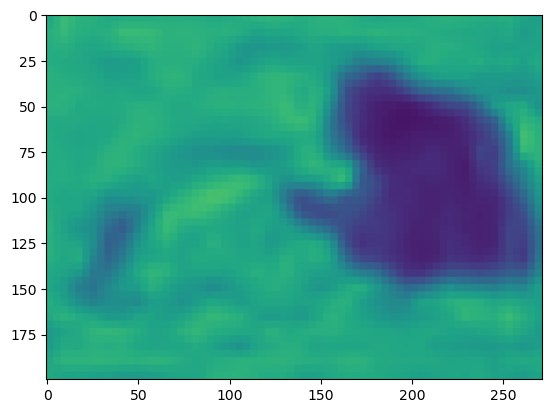

226
tensor([0.9653, 0.0000, 0.0000])


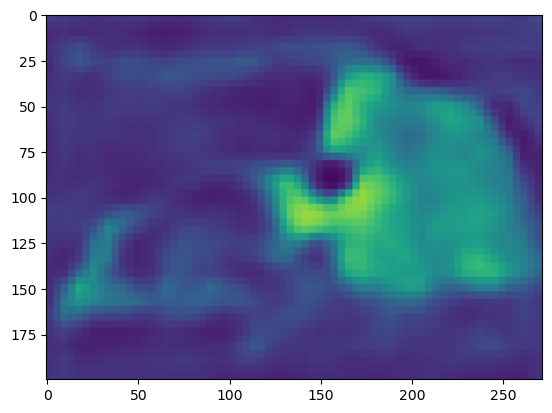

227
tensor([0.0000, 0.0118, 0.0000])


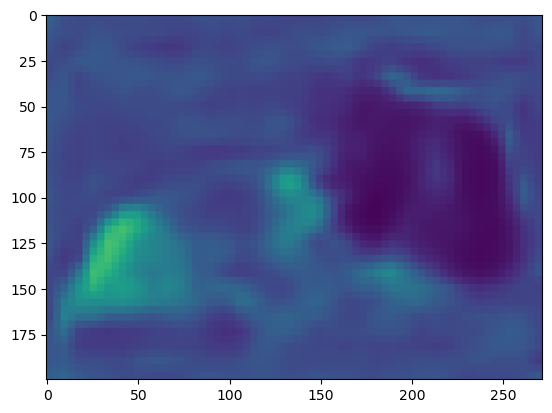

228
tensor([0.9729, 0.0294, 0.0000])


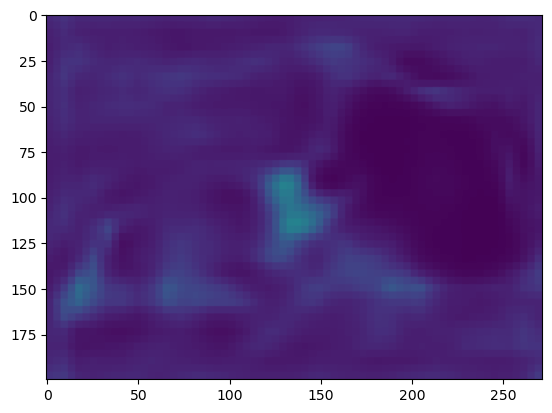

229
tensor([0.0000, 0.0690, 0.0000])


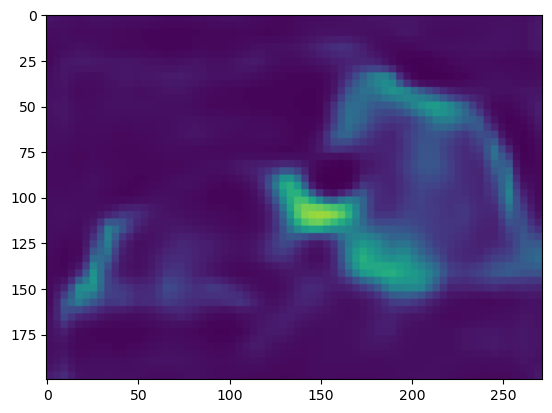

230
tensor([0.0000, 0.0876, 0.0000])


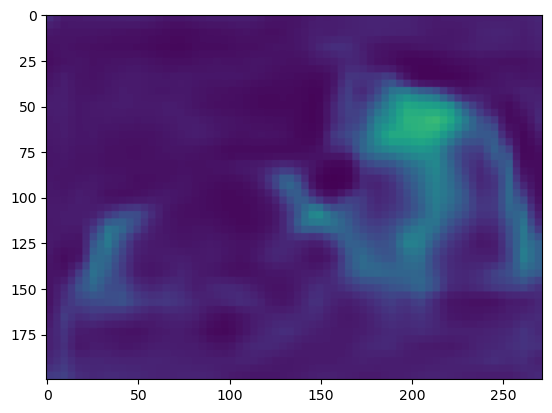

231
tensor([0.0000, 0.0000, 0.0314])


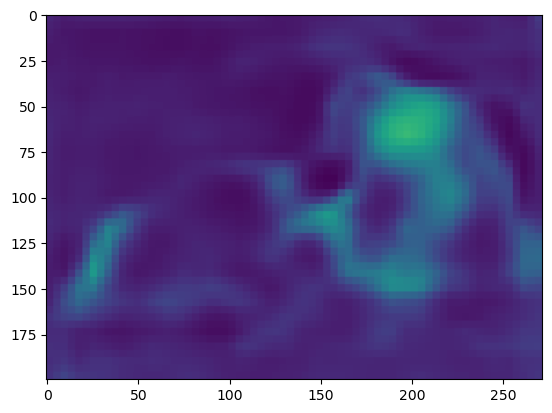

232
tensor([0., 0., 0.])


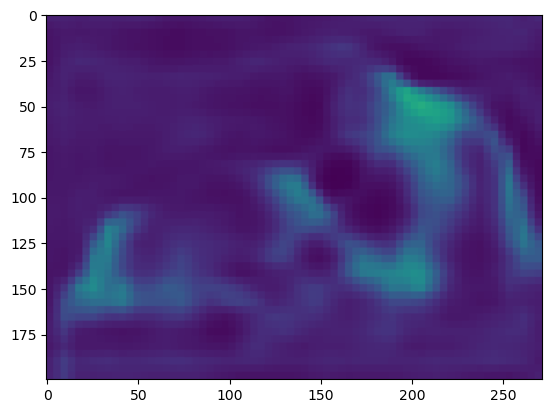

233
tensor([0., 0., 0.])


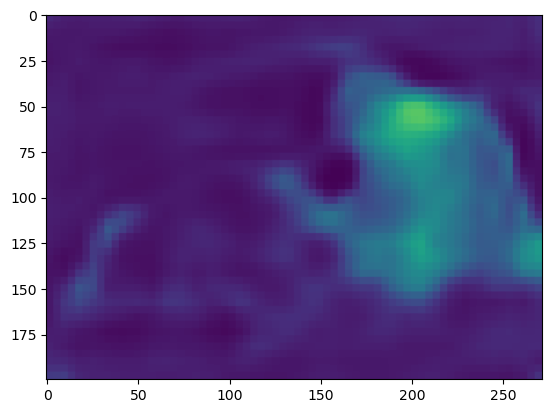

234
tensor([0., 0., 0.])


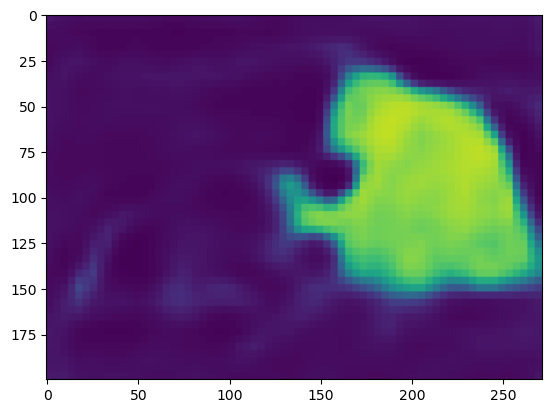

235
tensor([0.0000, 0.0000, 0.0218])


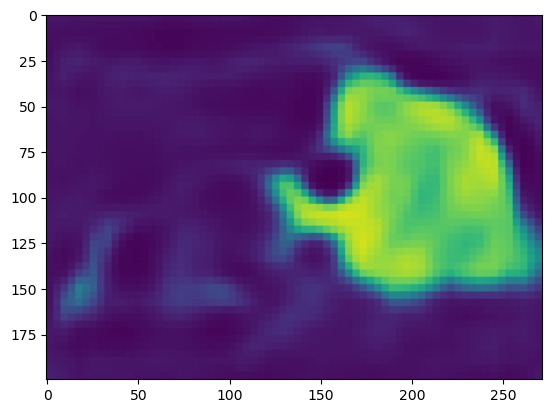

236
tensor([0., 0., 0.])


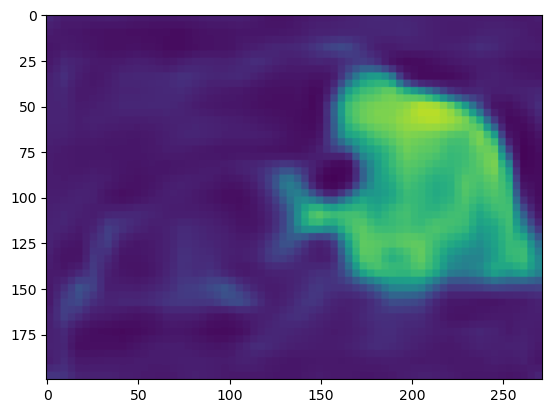

237
tensor([0.9148, 0.0000, 0.0228])


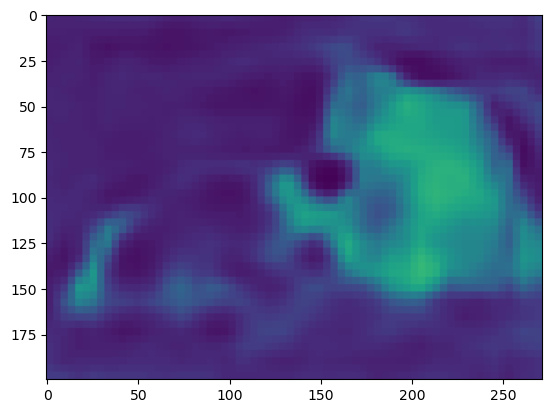

238
tensor([0.0000, 0.0000, 0.0412])


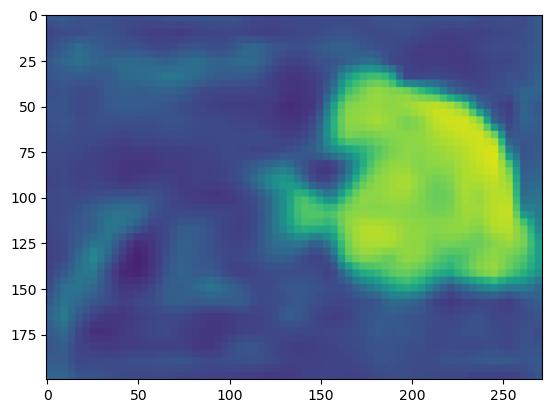

239
tensor([0., 0., 0.])


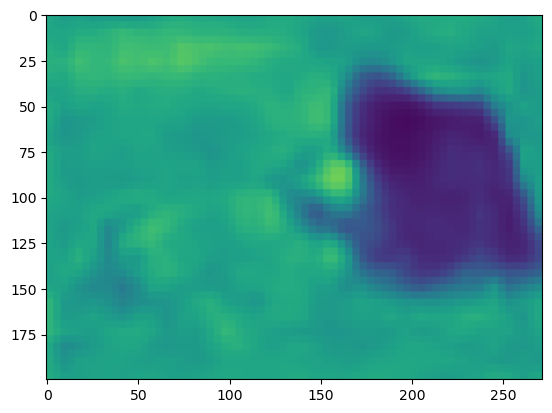

240
tensor([0.0000, 0.2067, 0.3841])


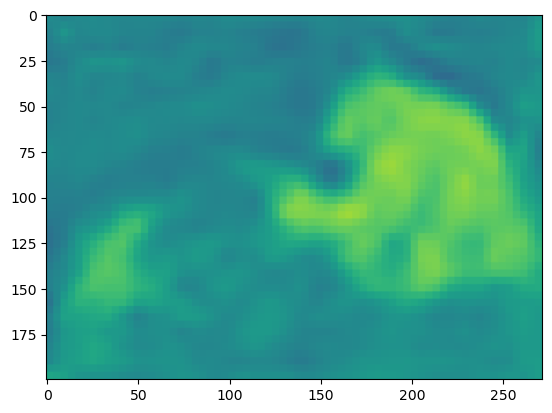

241
tensor([0., 0., 0.])


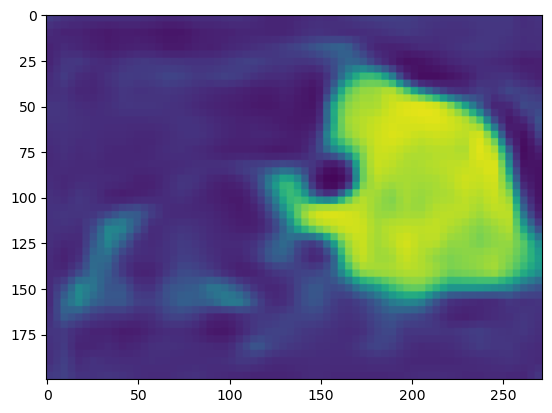

242
tensor([0.0000, 0.0937, 0.0000])


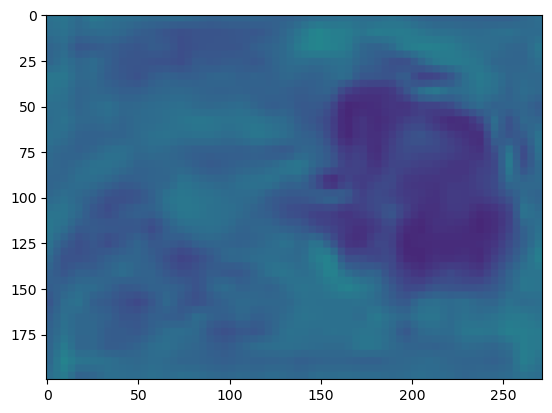

243
tensor([0., 0., 0.])


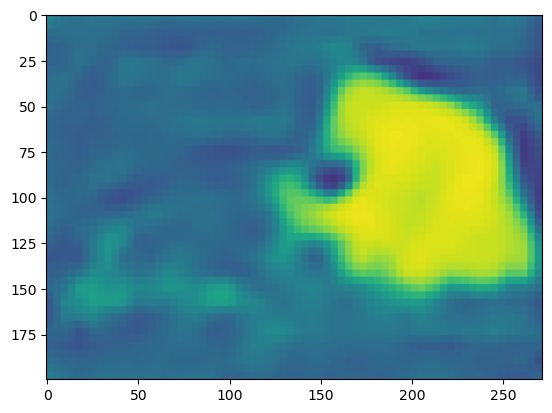

244
tensor([0.0000, 0.1290, 0.1310])


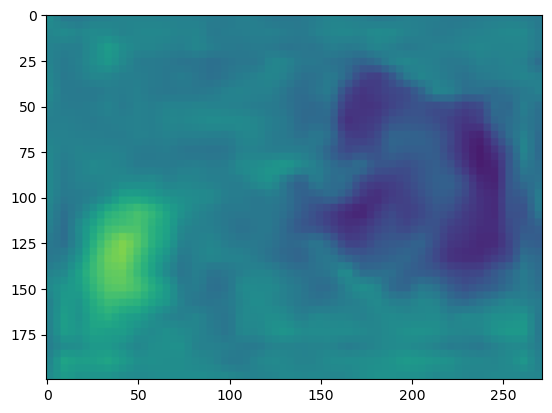

245
tensor([0.0000, 0.2708, 0.0000])


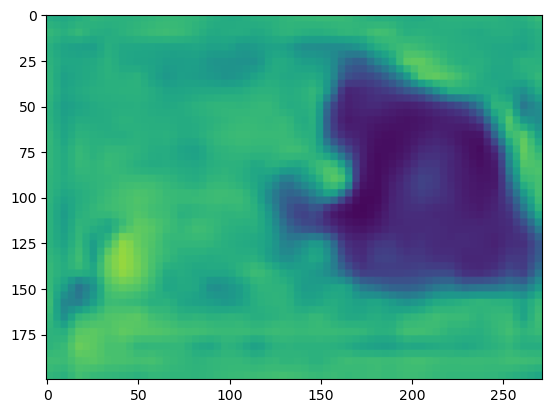

246
tensor([0.0000, 0.2974, 0.1416])


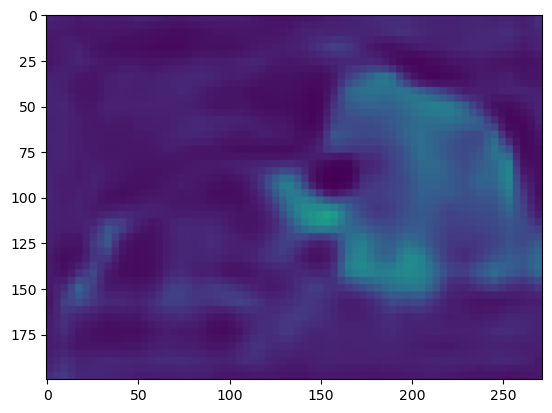

247
tensor([0.0000, 0.0000, 0.1546])


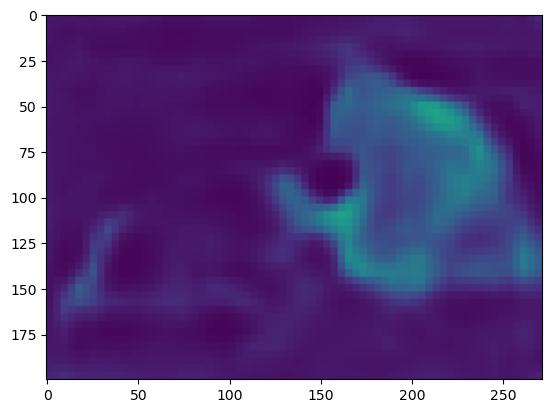

248
tensor([0.0000, 0.0000, 0.1715])


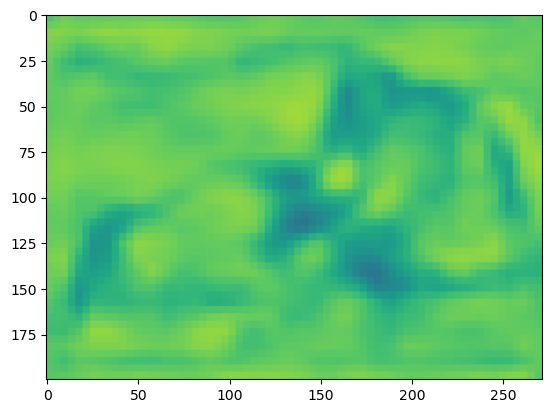

249
tensor([0., 0., 0.])


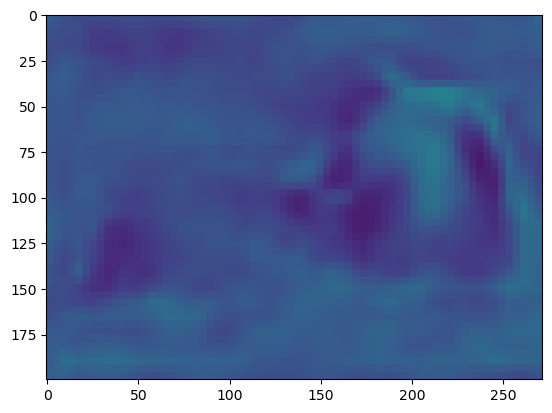

250
tensor([0.0000, 0.1183, 0.0000])


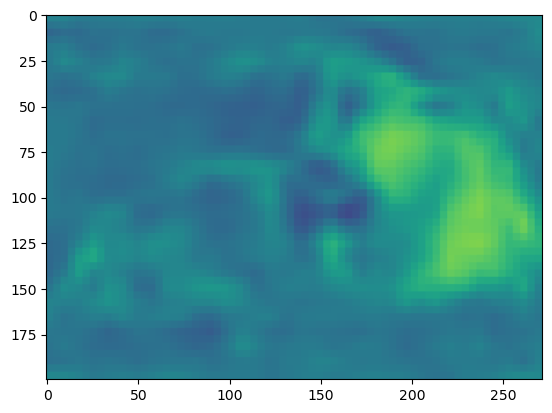

251
tensor([0.0000, 0.1512, 0.0000])


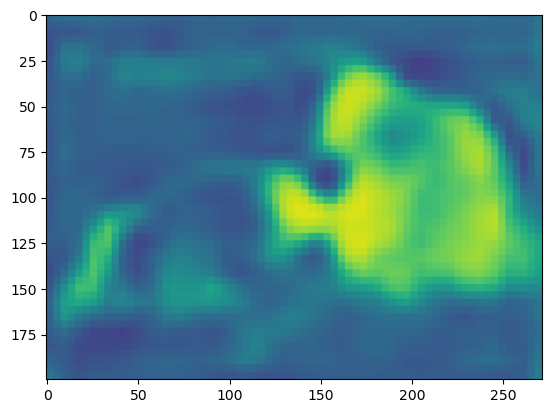

252
tensor([0.0000, 0.2726, 0.1230])


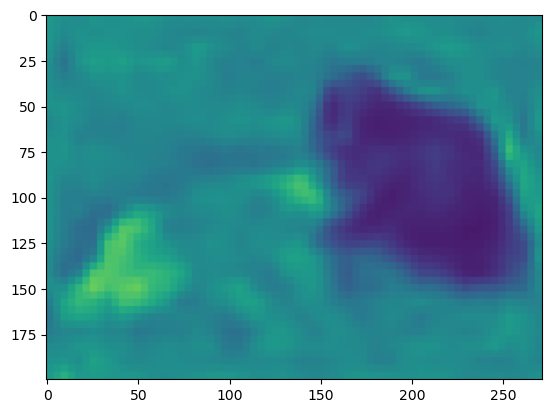

253
tensor([0., 0., 0.])


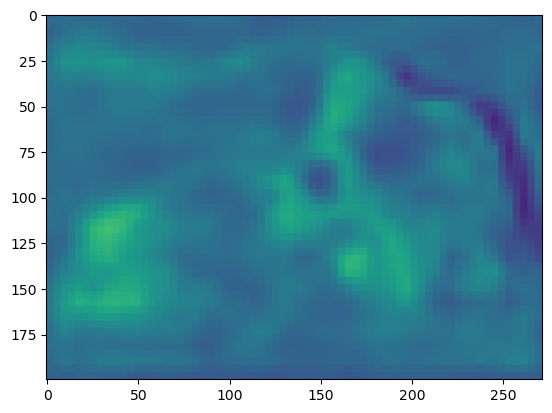

254
tensor([0.0000, 0.0000, 0.1985])


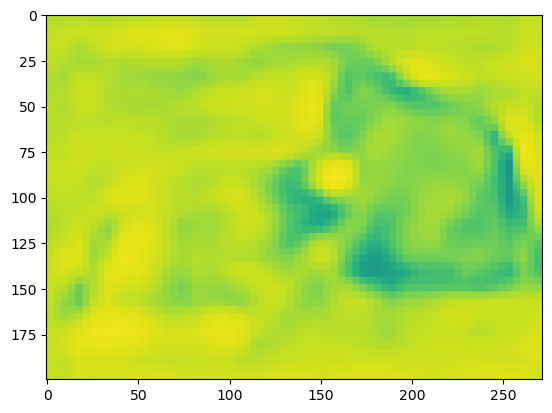

255
tensor([0.0000, 0.2402, 0.3669])


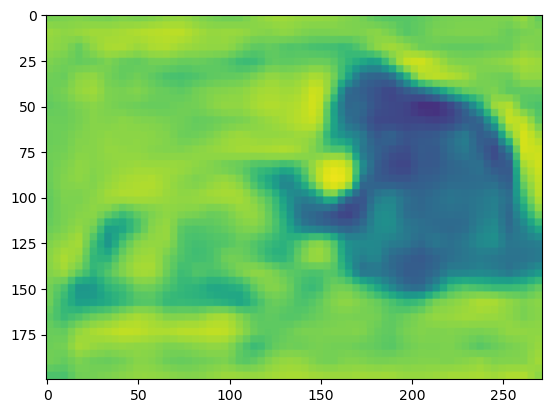

In [156]:
for i in range(256):
    print(i)
    print(cate_pred_list[3].flatten(start_dim=1, end_dim=2)[0, i, :].detach().cpu())
    plt.imshow(ins_pred_list[3][0, i, :, :].detach().cpu(), vmin=0, vmax=1); plt.show()

In [154]:
print(nms_sorted_labels)
print(nms_sorted_scores)

tensor([[1, 3, 3, 3, 3]], device='cuda:0')
tensor([[0.9999, 0.9996, 0.9988, 0.9929, 0.9920]], device='cuda:0',
       grad_fn=<StackBackward0>)


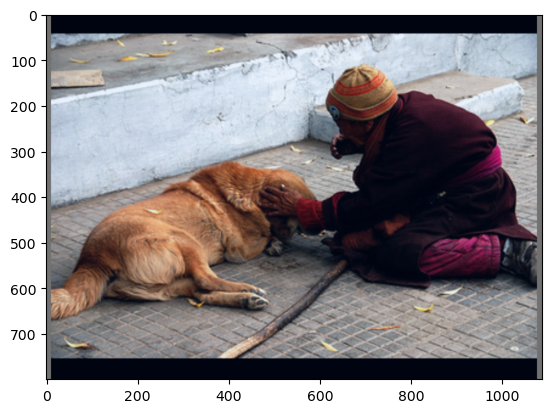

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.01727692037820816..4.0].


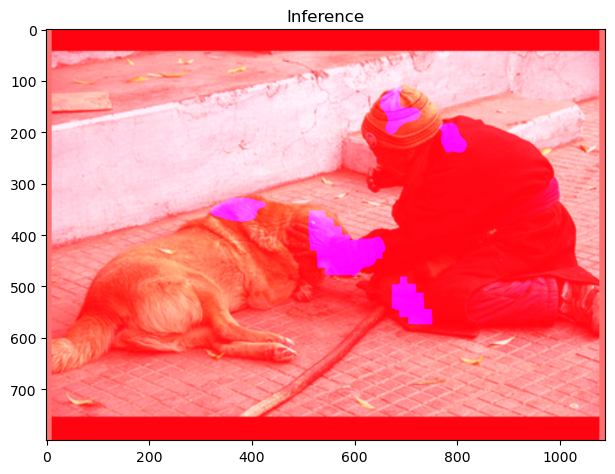

In [155]:
mask_color_list = ["jet", "ocean", "Spectral"]
model.head.PlotInfer(nms_sorted_scores, nms_sorted_labels, nms_sorted_ins, mask_color_list, img, _)